In [402]:
# Import libraries

import os
import csv
import numpy as np
import pandas as pd
from sklearn.metrics.pairwise import haversine_distances
from tqdm.notebook import tqdm # progress bar

import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
from cmcrameri import cm
from cartopy import crs as ccrs, feature as cfeature
import seaborn as sns

import ddeq

## Importing Data

### SMARTCARB

In [2]:
# Define coordinate reference systems used by the tool, the SMARTCARB model domain and the path to SMARTCARB data:

# DHDN / Soldner Berlin
CRS = ccrs.epsg(3068)  # Area of Berlin from epsg parameter dataset
WGS84 = ccrs.PlateCarree()  # Projection

DOMAIN = ddeq.misc.Domain.from_nml(
    os.path.join(os.path.dirname(ddeq.__file__), "data", "INPUT_ORG")
)

ROOT = "/project/coco2/fileshare/WP4/SMARTCARB/"

EMISSIONS_DATA_PATH = os.path.join(ROOT, "timeseries")
SMARTCARB_DATA_PATH = os.path.join(ROOT, "level2")
SMARTCARB_MODEL_PATH = os.path.join(ROOT, "COSMO")

# List of all filenames
SMARTCARB_filenames_all = os.listdir(SMARTCARB_DATA_PATH)

# list of point sources
sources = ddeq.misc.read_point_sources()

In [3]:
DOMAIN.lat
DOMAIN.rlat
DOMAIN.startlat
DOMAIN.stoplat
DOMAIN.pollat
DOMAIN.shape

(600, 700)

In [4]:
# example

filename = os.path.join(SMARTCARB_DATA_PATH, 'Sentinel_7_CO2_2015042311_o1670_l0483.nc')
data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)

data = ddeq.dplume.detect_plumes(data, sources, variable='NO2', variable_std='NO2_std',
                                 filter_type='gaussian', filter_size=0.5)

data.attrs.update(
    DESCRIPTION = ('Synthetic XCO2 and NO2 satellite image with ',
                   'auxiliary data for estimating CO2/NOx ',
                   'emissions of cities and point sources'),
    DATAORIGIN = 'SMARTCARB study',
    CREATOR = 'Gerrit Kuhlmann',
    EMAIL = 'gerrit.kuhlmann@empa.ch',
    AFFILIATION = 'Empa Duebendorf, Switzerland',
    DATE_CREATED = pd.Timestamp.now().strftime('%Y-%m-%d %H:%M'),
)

In [5]:
# Visualisation
#ddeq.vis.visualize(data, trace_gas='NO2', domain=DOMAIN, add_wind=False, do_zoom=False, show_clouds=True, vlim=(-3,3), show_true_plumes=True);

### TNO-MACC III 2011


In [6]:
TNO_MACC_III = pd.read_csv('TNO_MACC_III_emissions_2011.txt', delimiter=";")

# Only point sources. Meaning only rows where SourceType == 'P'
TNO_MACC_III_point_sources = TNO_MACC_III[TNO_MACC_III.SourceType == 'P']

# Use only points in this domain
extent = [5.86-5, 15.04+6, 47.27-5, 55.09+5]
TNO_MACC_III_point_sources = TNO_MACC_III_point_sources[(TNO_MACC_III_point_sources["Lon"] > extent[0]) 
                                                               & (TNO_MACC_III_point_sources["Lon"] < extent[1])
                                                                & (TNO_MACC_III_point_sources["Lat"] > extent[2])
                                                                & (TNO_MACC_III_point_sources["Lat"] < extent[3])]

display(TNO_MACC_III)
display(TNO_MACC_III_point_sources)

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
0,-29.9375,36.40625,ATL,2011,8,A,0.000000,0.063392,0.000000,0.018761,0.634203,0.048957,0.046509,0.417624
1,-29.9375,36.59375,ATL,2011,8,A,0.000000,0.306779,0.000000,0.090795,3.069150,0.236925,0.225079,2.021039
2,-29.9375,36.71875,ATL,2011,8,A,0.000000,0.720972,0.000000,0.213381,7.212906,0.556805,0.528965,4.749709
3,-29.9375,36.90625,ATL,2011,8,A,0.000000,0.942698,0.000000,0.279004,9.431144,0.728043,0.691641,6.210421
4,-29.9375,37.28125,ATL,2011,8,A,0.000000,1.368561,0.000000,0.405044,13.691649,1.056936,1.004089,9.015970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2153556,59.9375,68.71875,RUS,2011,8,A,0.000077,0.092780,0.000089,0.013108,0.039964,0.004249,0.003921,0.002002
2153557,59.9375,68.71875,RUS,2011,34,A,0.012773,0.017403,0.000029,0.000600,0.019378,0.005825,0.002151,0.031185
2153558,59.9375,68.71875,RUS,2011,72,A,0.001028,0.045246,0.000025,0.003632,0.046640,0.002300,0.002294,0.001133
2153559,59.9375,69.65625,RUS,2011,71,A,0.010413,1.144412,0.003486,0.140172,0.076558,0.001305,0.001254,0.000639


,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
197186,0.940000,47.140000,FRA,2011,9,P,969.940226,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
197188,1.000000,57.185277,GBR,2011,5,P,847.621976,0.000000,0.000000,471.536179,0.000000,0.000000,0.000000,0.000000
197189,1.033330,51.366670,GBR,2011,34,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.396020,0.114845,0.000000
197190,1.050000,49.460000,FRA,2011,34,P,0.000000,0.000000,0.000000,412.584733,0.000000,0.000000,0.000000,0.000000
198766,1.083732,58.228349,GBR,2011,1,P,0.000000,0.000000,0.000000,3.006014,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821893,21.000000,46.400000,HUN,2011,5,P,80.557514,5.391944,0.002695,13.788148,0.898657,1.150281,1.150281,0.005391
1821894,21.000000,47.950000,HUN,2011,1,P,69.116510,0.000000,1.276921,11.711644,0.000000,0.641545,0.444863,0.000000
1821895,21.010000,50.020000,POL,2011,1,P,4.850069,0.000000,0.000000,61.423833,0.000000,74.251620,55.638380,0.000000
1821896,21.022157,47.916708,HUN,2011,34,P,0.000000,0.000000,0.000000,0.000000,241.456474,0.000000,0.000000,0.000000


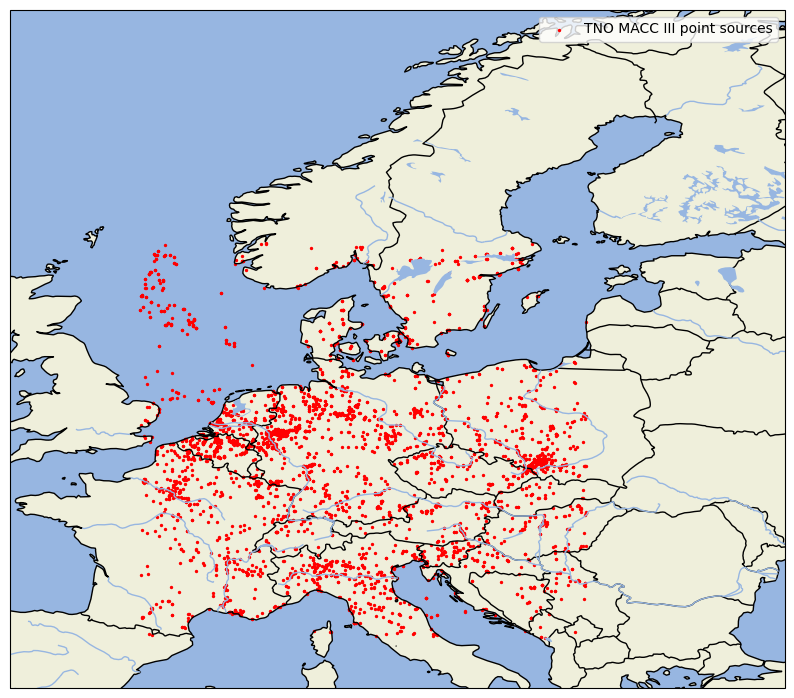

In [7]:
# Plot the point sources on a map

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())
ax.set_extent([-5,30,40,70])
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources['Lon'], TNO_MACC_III_point_sources['Lat'], transform=ccrs.PlateCarree(), s=2, c='r', label='TNO MACC III point sources')
plt.legend()
plt.show()

#### Cluster the closest point sources as one.


In [11]:
# Convert Lat and Long to radians
location_radians = np.radians(TNO_MACC_III_point_sources[['Lat', 'Lon']])

# Calculate the haversine distance between all the facilities
haversine_distance_of_point_sources = haversine_distances(location_radians, location_radians) * 6371 # multiply by Earth radius to get kilometers


# Spatial resoluion of SMARTCARB dataset is 2x2 km, so the diameter of a pixel is 2*sqrt(2) = 2.828 km
# We consider all points within two pixels as one cluster. 
# So we will use a cluster radius of 2*(2*sqrt(2)) = 5.657 km.

cluster_radius = 5.657  # km

# Do a DBSCAN clustering with the haversine distance matrix
from sklearn.cluster import DBSCAN 

TNO_MACC_III_point_sources_clusters = DBSCAN(eps=cluster_radius, min_samples=1, metric='precomputed').fit(haversine_distance_of_point_sources)


# Check what is the maximum pointwise distance between points in each cluster

max_distance_within_cluster = np.array([0.0]*np.unique(TNO_MACC_III_point_sources_clusters.labels_).shape[0])

print("Number of clusters:" ,len(np.unique(TNO_MACC_III_point_sources_clusters.labels_)))
print("Length of dataset:", len(TNO_MACC_III_point_sources))

# Go through all clusters and calculate the maximum distance between points in each cluster
for i in np.unique(TNO_MACC_III_point_sources_clusters.labels_):
    max_distance_within_cluster[i] = np.max(haversine_distance_of_point_sources[TNO_MACC_III_point_sources_clusters.labels_ == i][:,TNO_MACC_III_point_sources_clusters.labels_ == i])

print("Number of clusters with max distance greater than 3 km: ", (max_distance_within_cluster>3).sum())
print("Number of clusters with max distance greater than 6 km: ", (max_distance_within_cluster>6).sum())
print("Maximum distance within a cluster: ", max_distance_within_cluster.max())

Number of clusters: 1801
Length of dataset: 3922
Number of clusters with max distance greater than 3 km:  302
Number of clusters with max distance greater than 6 km:  110
Maximum distance within a cluster:  38.61472670615387


In [12]:
# Add cluster labels in dataframe
TNO_MACC_III_point_sources = TNO_MACC_III_point_sources.copy()
TNO_MACC_III_point_sources['cluster'] = TNO_MACC_III_point_sources_clusters.labels_
TNO_MACC_III_point_sources["Index"] = TNO_MACC_III_point_sources.index
TNO_MACC_III_point_sources

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2,cluster,Index
197186,0.940000,47.140000,FRA,2011,9,P,969.940226,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,197186
197188,1.000000,57.185277,GBR,2011,5,P,847.621976,0.000000,0.000000,471.536179,0.000000,0.000000,0.000000,0.000000,1,197188
197189,1.033330,51.366670,GBR,2011,34,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.396020,0.114845,0.000000,2,197189
197190,1.050000,49.460000,FRA,2011,34,P,0.000000,0.000000,0.000000,412.584733,0.000000,0.000000,0.000000,0.000000,3,197190
198766,1.083732,58.228349,GBR,2011,1,P,0.000000,0.000000,0.000000,3.006014,0.000000,0.000000,0.000000,0.000000,4,198766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821893,21.000000,46.400000,HUN,2011,5,P,80.557514,5.391944,0.002695,13.788148,0.898657,1.150281,1.150281,0.005391,1800,1821893
1821894,21.000000,47.950000,HUN,2011,1,P,69.116510,0.000000,1.276921,11.711644,0.000000,0.641545,0.444863,0.000000,1410,1821894
1821895,21.010000,50.020000,POL,2011,1,P,4.850069,0.000000,0.000000,61.423833,0.000000,74.251620,55.638380,0.000000,1408,1821895
1821896,21.022157,47.916708,HUN,2011,34,P,0.000000,0.000000,0.000000,0.000000,241.456474,0.000000,0.000000,0.000000,1410,1821896


In [13]:
# Combine the facilities that are in the same cluster

TNO_MACC_III_point_sources_clusters_combined = TNO_MACC_III_point_sources.groupby("cluster").agg(
    {
        "Index": [lambda x: ", ".join(str(i) for i in x), "count"],
        "Lon": "mean",
        "Lat": "mean",
        "CH4": "sum",	
        "CO": "sum",	
        "NH3": "sum",
        "NMVOC": "sum",
        "NOX": "sum",
        "PM10": "sum",
        "PM2_5": "sum",
        "SO2": "sum",
    }
)
""
TNO_MACC_III_point_sources_clusters_combined.columns = ["Indexses", "count", "Lon", "Lat", "CH4", "CO", "NH3", "NMVOC", "NOX", "PM10", "PM2_5", "SO2"]

TNO_MACC_III_point_sources_clusters_combined

,Indexses,count,Lon,Lat,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
cluster,,,,,,,,,,,,
0,197186,1,0.940000,47.140000,969.940226,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,"197188, 234829",2,1.000000,57.185277,847.621976,0.000000,0.000000,475.549528,0.000000,0.000000,0.000000,0.000000
2,197189,1,1.033330,51.366670,0.000000,0.000000,0.000000,0.000000,0.000000,0.396020,0.114845,0.000000
3,"197190, 215139, 215140, 215141, 215142, 215143...",12,1.043333,49.370000,226.222018,2346.368216,84.793474,1570.457086,3995.470587,154.506159,96.410872,5032.038122
4,"198766, 216888",2,1.083732,58.228349,168.332659,0.000000,0.000000,356.188490,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
1796,"1819877, 1819878",2,20.761666,48.108333,66.362369,2189.371038,0.000000,0.000000,0.000000,275.235418,168.868497,31.990859
1797,1820887,1,20.865561,51.099306,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,215.755009
1798,1820888,1,20.920000,44.020000,1.063730,17.329412,0.017588,12.779303,223.721788,168.731872,71.810366,1275.566145


In [14]:
TNO_MACC_III_point_sources_NOX = TNO_MACC_III_point_sources_clusters_combined.query("NOX > 0")[["Lon", "Lat", "NOX"]]
TNO_MACC_III_point_sources_NOX

,Lon,Lat,NOX
cluster,,,
3,1.043333,49.370000,3995.470587
7,1.166700,53.716810,2887.959307
8,1.170000,49.320000,316.743319
9,1.230000,45.130000,101.205414
13,1.401333,43.616667,578.696710
...,...,...,...
1790,19.683333,45.200000,1257.625038
1792,20.050000,46.300000,1.872202
1798,20.920000,44.020000,223.721788


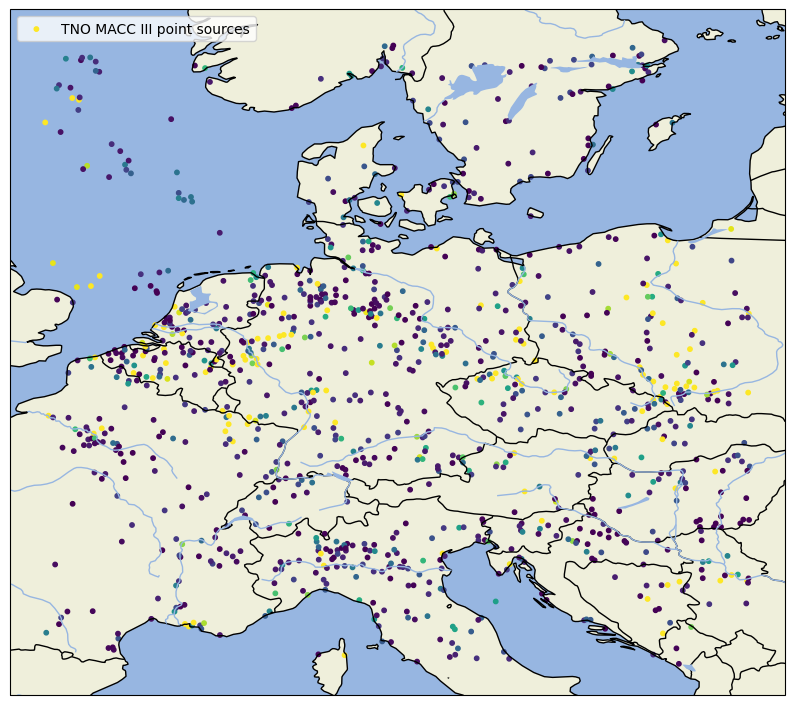

In [15]:
# Plot the point sources on a map

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=10, label='TNO MACC III point sources')
plt.legend()
plt.show()

## Comparisons of plume detection methods
SCEA and the one from Kuenen et al.

In [16]:
# Data from earlier notebook

# My plume detection algorithms found clusters (plumes)
with open('./results_v1/my_clusters_per_file_lists.txt', 'r') as file:
    reader = csv.reader(file)
    my_clusters_per_file = [ [float(x) for x in row] for row in reader]

# SMARTCARB authors plume detection algortihms found plumes
their_clusters_per_file = pd.read_csv('./results_v1/their_clusters_per_file.csv', delimiter=';')


In [17]:
# Plot an example with sources

def plot_all_facilities(i):
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
    lon, lat = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
    no2 = np.array(data['NO2']).flatten()
    not_nan = np.logical_not(np.isnan(no2))
    lon, lat = lon[not_nan], lat[not_nan] 
    no2 = no2[not_nan]

    clusters = my_clusters_per_file[i]

    fig, axs = plt.subplots(1,2, figsize=(10,5), subplot_kw={'projection': ccrs.PlateCarree()}, dpi=200)

    extent = [np.min(lon)-0.5, np.max(lon)+0.5, np.min(lat)-0.5, np.max(lat)+0.5]

    ax = axs[0]
    ax.set_extent(extent)
    pcm = ax.scatter(lon, lat, c=no2, vmin=0, vmax=1.7e16, s=0.2, alpha=0.9, transform=ccrs.Geodetic())
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.coastlines()

    ax.set_title(f"Amount of sources: {len(TNO_MACC_III_point_sources_NOX)}")

    # Plot TNO-MACC sources  
    ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c='red', path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=1)], s=1, alpha=0.8)

    # Plot SMARTCARB sources
    for i in range(len(sources['source'])):
        ax.scatter(sources['lon_o'][i], sources['lat_o'][i], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="white", alpha=0.5)], s=1, alpha=0.5)
        ax.text(sources['lon_o'][i], sources['lat_o'][i]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)

    # Gridlines
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}


    #### SECOND SUBPLOT

    ax = axs[1]
    ax.set_extent(extent)
    pcm = ax.scatter(lon, lat, c=no2, vmin=0, vmax=1.7e16, s=0.2, alpha=0.15, transform=ccrs.Geodetic())
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.coastlines()

    # Plot my clusters
    if len(clusters)!=0 and int(np.max(clusters))!=0:
        for i in range(1,int(np.max(clusters))+1):
            ax.scatter(lon[clusters == i], lat[clusters == i], s=1)
    else:
        print("no clusters")
    
    # Plot TNO-MACC sources  
    ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c=TNO_MACC_III_point_sources_NOX['NOX'], vmin=0, vmax=3000, path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=1)], s=5, alpha=0.8)
      
    # Plot SMARTCARB sources
    for i in range(len(sources['source'])):
        ax.scatter(sources['lon_o'][i], sources['lat_o'][i], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="white", alpha=0.5)], s=1, alpha=0.5)
        ax.text(sources['lon_o'][i], sources['lat_o'][i]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)

    # Gridlines
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}

    fig.suptitle("TNO-MACC sources")
    plt.show()

no clusters


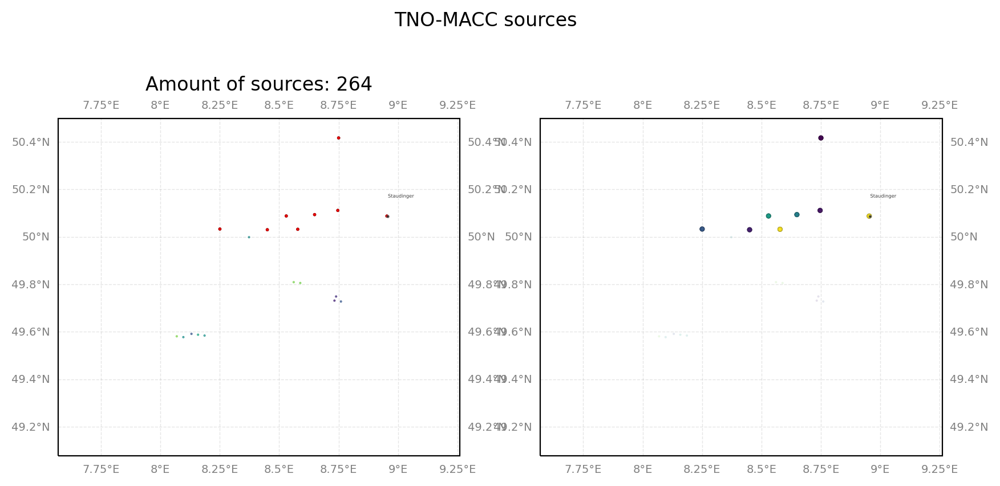

In [622]:
plot_all_facilities(71)

### First experiment with "True positves" vs. "false positives"

In [19]:
# Go through every cluster and check if there are any facilities in the cluster

true_positives = [] * len(my_clusters_per_file)
false_positives = [] * len(my_clusters_per_file)

for i in tqdm(range(len(my_clusters_per_file))):
    
    # If empty, then continue
    if len(my_clusters_per_file[i]) == 0:
        true_positives.append([])
        false_positives.append([])
        continue

    # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario="low",
        no2_noise_scenario="high",
        co_noise_scenario="low",
        only_observations=False,
    )
    lon = np.array(data["lon"]).flatten()
    lat = np.array(data["lat"]).flatten()
    no2 = np.array(data["NO2"]).flatten()
    not_nan = np.logical_not(np.isnan(no2))
    lon = lon[not_nan]
    lat = lat[not_nan]
    no2 = no2[not_nan]

    # Go through every cluster and check if there are any facilities in the cluster
    true_positives_in_this_file = []
    false_positives_in_this_file = []
    for j in range(1, int(np.max(my_clusters_per_file[i])) + 1):
        is_plume = np.array(my_clusters_per_file[i]) == j
        plume_points = np.transpose([lon[is_plume], lat[is_plume]])
        facility_points = TNO_MACC_III_point_sources_NOX[["Lon","Lat"]].values

        # Calculate distance between plume points and facility points
        distance_matrix = haversine_distances(np.radians(plume_points), np.radians(facility_points)) * 6371

        # If plume points are within 5 km of a facility, then the cluster is a true positive.
        # If not, then the cluster is a false positive.
        if np.any(distance_matrix <= 5):
            true_positives_in_this_file.append(j)
        else:
            false_positives_in_this_file.append(j)

    true_positives.append(true_positives_in_this_file)
    false_positives.append(false_positives_in_this_file)

  0%|          | 0/3124 [00:00<?, ?it/s]

### How many of the facilities can I find?
as a function of the facility size

Max: 45391.827236
Min: 0.001975


<AxesSubplot: title={'center': 'NOx 2011'}, ylabel='Frequency'>

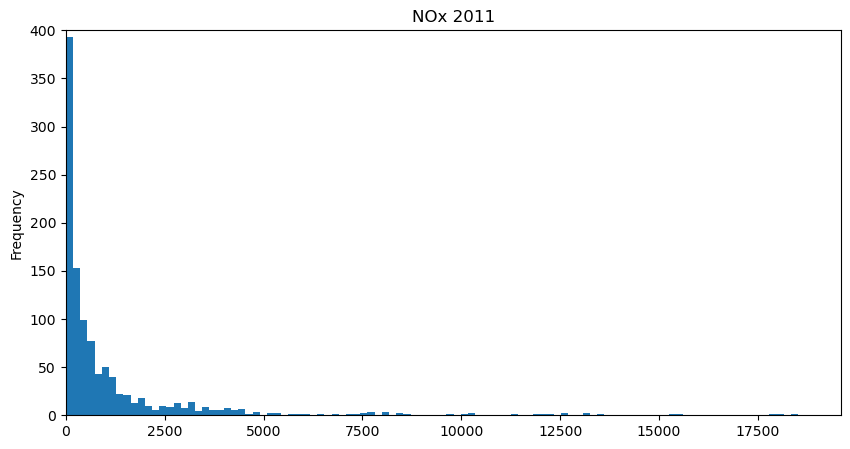

In [21]:
# Inspect the amount of facilites by total emission quantity.

print("Max:", TNO_MACC_III_point_sources_NOX["NOX"].max())
print("Min:", TNO_MACC_III_point_sources_NOX["NOX"].min())

TNO_MACC_III_point_sources_NOX["NOX"].plot(kind="hist", bins=250, figsize=(10, 5), title="NOx 2011", xlim=(0, 19600.0), ylim=(0, 400))

In [25]:
# Add columns for tracking how many times a facility is found or missed by my algorithm
TNO_MACC_III_point_sources_NOX.loc[:,"Times found"] = 0
TNO_MACC_III_point_sources_NOX.loc[:,"Times missed"] = 0

# Go through every file
for i in tqdm(range(len(my_clusters_per_file))):
    
    # If empty, then continue
    if len(my_clusters_per_file[i]) == 0:
        continue

    # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario="low",
        no2_noise_scenario="high",
        co_noise_scenario="low",
        only_observations=False,
    )
    lon = np.array(data["lon"]).flatten()
    lat = np.array(data["lat"]).flatten()
    no2 = np.array(data["NO2"]).flatten()
    not_nan = np.logical_not(np.isnan(no2))
    lon = lon[not_nan]
    lat = lat[not_nan]
    no2 = no2[not_nan]

    # Get the plume points from the file
    all_points = np.transpose([lon, lat])
    is_plume = np.array(my_clusters_per_file[i]) != 0
    plume_points = all_points[is_plume]
    
    # Get facility points 
    facility_points = TNO_MACC_III_point_sources_NOX[["Lon","Lat"]].values

    # Calculate distance between all points and facility points
    distance_matrix_all_points = haversine_distances(np.radians(facility_points), np.radians(all_points)) * 6371
    distance_matrix_plume_points = distance_matrix_all_points[:, is_plume]
    
    # Check if a facility is found
    is_near_any_points = np.any(distance_matrix_all_points <= 5, axis=1)
    is_near_plume_points = np.any(distance_matrix_plume_points <= 5, axis=1)

    is_found = np.logical_and(is_near_any_points, is_near_plume_points)
    is_missed = np.logical_and(is_near_any_points, np.logical_not(is_near_plume_points))

    TNO_MACC_III_point_sources_NOX.loc[:, "Times found"] += is_found
    TNO_MACC_III_point_sources_NOX.loc[:, "Times missed"] += is_missed

  0%|          | 0/3124 [00:00<?, ?it/s]

In [26]:
df_sorted = TNO_MACC_III_point_sources_NOX[TNO_MACC_III_point_sources_NOX["Times found"]>0].sort_values(by="NOX", ascending=False)
df_sorted

,Lon,Lat,NOX,Times found,Times missed
cluster,,,,,
1178,14.453045,51.832476,26877.181597,192,22
1291,18.617255,50.181829,18039.580208,65,129
939,13.257700,50.418910,15481.611184,198,31
1038,14.575608,51.419055,15378.922090,202,20
1209,14.906528,50.940970,13108.379703,169,29
...,...,...,...,...,...
1139,16.383226,52.227076,2.625213,5,211
614,9.500000,55.480000,2.438735,13,136
680,10.250000,52.200000,1.813218,95,120


In [28]:
df_sorted.iloc[:,3]

cluster
1178    192
1291     65
939     198
1038    202
1209    169
       ... 
1139      5
614      13
680      95
845      98
692      33
Name: Times found, Length: 304, dtype: int64

In [27]:
# Calculate hit rate as a function of NOX
NOX = df_sorted['NOX'].values

cumulative_hit_rate = np.zeros(len(df_sorted))
for i in range(len(df_sorted)):
    n_found = df_sorted.iloc[0:i+1, 3].sum()
    n_missed = df_sorted.iloc[0:i+1, 4].sum()
    cumulative_hit_rate[i]=n_found/(n_found+n_missed)
    
hit_rate = np.zeros(len(df_sorted))
for i in range(len(df_sorted)):
    n_found = df_sorted.iloc[i, 3]
    n_missed = df_sorted.iloc[i, 4]
    hit_rate[i]=n_found/(n_found+n_missed)

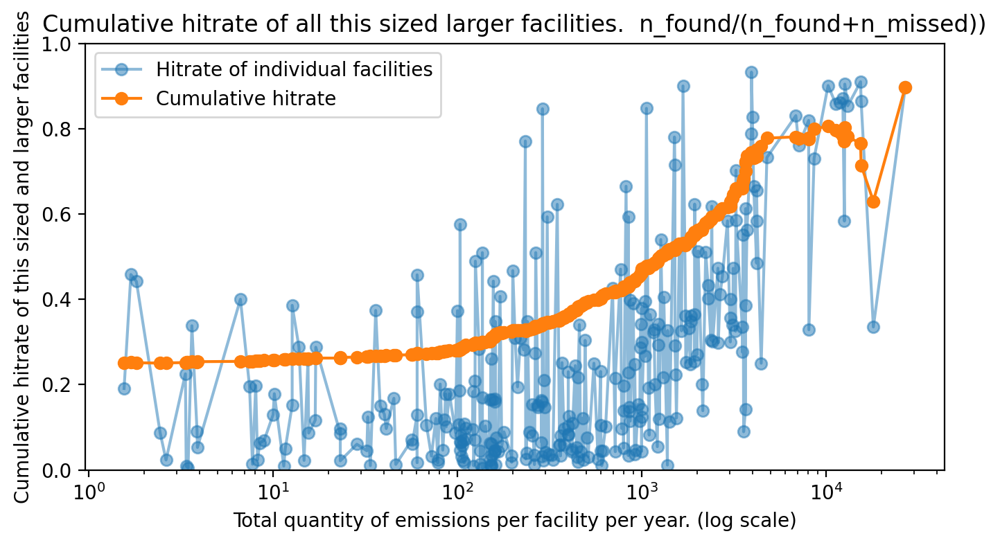

In [49]:
fig = plt.figure(figsize=(8, 4), dpi=200)

plt.semilogx(NOX, hit_rate, 'o-', label='Hitrate of individual facilities', alpha=0.5)
plt.xlabel('Total quantity of emissions per facility.(log scale))')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.semilogx(NOX, cumulative_hit_rate, 'o-', label='Cumulative hitrate')
plt.xlabel('Total quantity of emissions per facility per year. (log scale)')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.legend()
plt.show()

### Lets check what is up with that seconnd largest one

In [76]:
display(df_sorted)
display(TNO_MACC_III_point_sources_clusters_combined.iloc[1291,:])
display(TNO_MACC_III_point_sources_clusters_combined.iloc[1291,:]["Indexses"])
display(TNO_MACC_III_point_sources)
display(TNO_MACC_III_point_sources.loc[[514384, 514385, 578153, 580717, 627409, 629312, 629314, 629317, 1804899],:])

,Lon,Lat,NOX,Times found,Times missed
cluster,,,,,
1178,14.453045,51.832476,26877.181597,192,22
1291,18.617255,50.181829,18039.580208,65,129
939,13.257700,50.418910,15481.611184,198,31
1038,14.575608,51.419055,15378.922090,202,20
1209,14.906528,50.940970,13108.379703,169,29
...,...,...,...,...,...
1139,16.383226,52.227076,2.625213,5,211
614,9.500000,55.480000,2.438735,13,136
680,10.250000,52.200000,1.813218,95,120


Indexses    514384, 514385, 578153, 580717, 627409, 629312...
count                                                       9
Lon                                                 18.617255
Lat                                                 50.181829
CH4                                              22628.102118
CO                                               10125.611888
NH3                                                   0.23143
NMVOC                                             1143.910209
NOX                                              18039.580208
PM10                                              1355.064776
PM2_5                                             1009.846867
SO2                                              28368.961466
Name: 1291, dtype: object

'514384, 514385, 578153, 580717, 627409, 629312, 629314, 629317, 1804899'

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2,cluster,Index
197186,0.940000,47.140000,FRA,2011,9,P,969.940226,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,197186
197188,1.000000,57.185277,GBR,2011,5,P,847.621976,0.000000,0.000000,471.536179,0.000000,0.000000,0.000000,0.000000,1,197188
197189,1.033330,51.366670,GBR,2011,34,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.396020,0.114845,0.000000,2,197189
197190,1.050000,49.460000,FRA,2011,34,P,0.000000,0.000000,0.000000,412.584733,0.000000,0.000000,0.000000,0.000000,3,197190
198766,1.083732,58.228349,GBR,2011,1,P,0.000000,0.000000,0.000000,3.006014,0.000000,0.000000,0.000000,0.000000,4,198766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821893,21.000000,46.400000,HUN,2011,5,P,80.557514,5.391944,0.002695,13.788148,0.898657,1.150281,1.150281,0.005391,1800,1821893
1821894,21.000000,47.950000,HUN,2011,1,P,69.116510,0.000000,1.276921,11.711644,0.000000,0.641545,0.444863,0.000000,1410,1821894
1821895,21.010000,50.020000,POL,2011,1,P,4.850069,0.000000,0.000000,61.423833,0.000000,74.251620,55.638380,0.000000,1408,1821895
1821896,21.022157,47.916708,HUN,2011,34,P,0.000000,0.000000,0.000000,0.000000,241.456474,0.000000,0.000000,0.000000,1410,1821896


,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2,cluster,Index
514384,18.676329,50.217310,POL,2011,1,P,0.000000,113.708812,0.00000,0.068793,41.429488,4.305171,2.700637,19.252315,1291,514384
514385,18.676478,50.216636,POL,2011,5,P,9483.215271,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1291,514385
578153,18.523610,50.133330,POL,2011,1,P,0.000000,9425.743544,0.00000,0.000000,17766.729515,0.000000,0.000000,27480.374932,1291,578153
580717,18.676329,50.217310,POL,2011,34,P,32.120390,580.450202,0.23143,49.567882,0.000000,23.518100,15.365453,242.775912,1291,580717
627409,18.516670,50.133330,POL,2011,1,P,86.178929,0.000000,0.00000,1091.415223,0.000000,1319.346967,988.615856,0.000000,1291,627409
629312,18.590000,50.150000,POL,2011,34,P,1.243821,0.000000,0.00000,0.889250,0.000000,7.878766,3.149212,0.000000,1291,629312
629314,18.634167,50.186111,POL,2011,5,P,12378.853521,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,1291,629314
629317,18.678260,50.215532,POL,2011,1,P,0.000000,0.000000,0.00000,0.000000,195.000689,0.000000,0.000000,623.418423,1291,629317
1804899,18.583450,50.166900,CZE,2011,5,P,646.490186,5.709330,0.00000,1.969061,36.420516,0.015772,0.015709,3.139884,1291,1804899


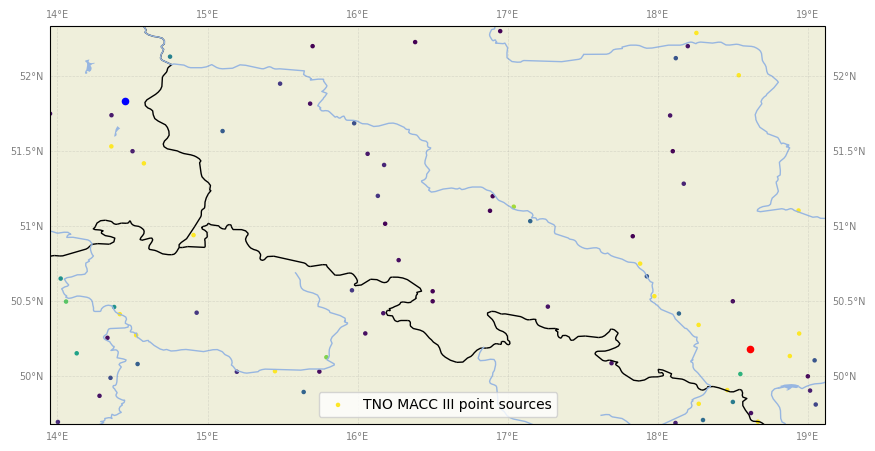

In [30]:
df_sorted.iloc[1,:]

# Plot this facility on a map with SMARTCARB data

# Plot the point sources on a map

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c='red', transform=ccrs.PlateCarree(), s=20)
ax.scatter(df_sorted["Lon"].values[0], df_sorted["Lat"].values[0], c='blue', transform=ccrs.PlateCarree(), s=20)


extent = [df_sorted["Lon"].values[0]-0.5, df_sorted["Lon"].values[1]+0.5, df_sorted["Lat"].values[1]-0.5, df_sorted["Lat"].values[0]+0.5]
ax.set_extent(extent)

# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

plt.legend()
plt.show()

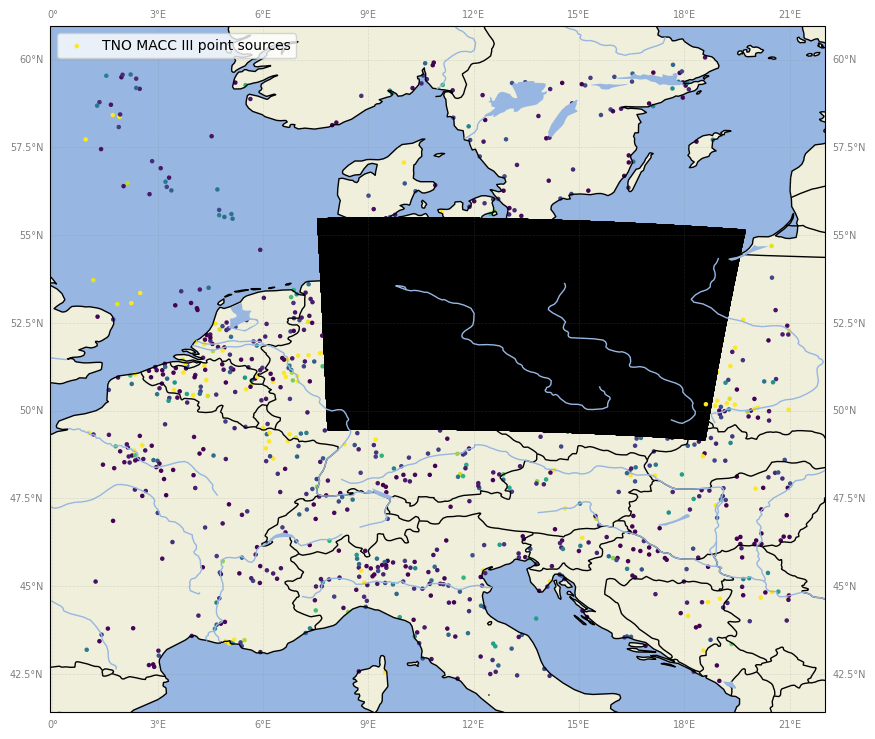

In [220]:
df_sorted.iloc[1,:]

# Plot this facility on a map with SMARTCARB data

# Plot the point sources on a map

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])

#extent = [df_sorted["Lon"].values[0]-0.5, df_sorted["Lon"].values[1]+0.5, df_sorted["Lat"].values[1]-0.5, df_sorted["Lat"].values[0]+0.5]
#ax.set_extent(extent)

# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

plt.legend()
plt.show()

In [201]:
# Plot an example with sources

def plot_all_facilities_asdf(i, vmin=0, vmax=1e17):
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
    lon, lat = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
    no2 = np.array(data['NO2_noisefree']).flatten()
    not_nan = np.logical_not(np.isnan(no2))
    lon, lat = lon[not_nan], lat[not_nan] 
    no2 = no2[not_nan]

    clusters = my_clusters_per_file[i]

    fig, axs = plt.subplots(1,1, figsize=(10,5), subplot_kw={'projection': ccrs.PlateCarree()}, dpi=200)

    extent = [df_sorted["Lon"].values[1]-1.5, df_sorted["Lon"].values[1]+1.5, df_sorted["Lat"].values[1]-1.5, df_sorted["Lat"].values[1]+1.5]

    ax = axs
    ax.set_extent(extent)
    pcm = ax.scatter(lon, lat, c=no2, vmin=vmin, vmax=vmax, s=2, alpha=1, transform=ccrs.Geodetic())
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.coastlines()

    #ax.set_title(f"Amount of sources: {len(TNO_MACC_III_point_sources_NOX)}")

    # Plot TNO-MACC sources  
    ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c=TNO_MACC_III_point_sources_NOX['NOX'], vmin=0, vmax=16000, path_effects=[pe.withStroke(linewidth=1.7, foreground="black", alpha=1)], s=1.1, alpha=1)
    ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])
    ax.scatter(df_sorted["Lon"].values[0], df_sorted["Lat"].values[0], c='blue', transform=ccrs.PlateCarree(), s=5)

    ax.scatter([18.523610-0.05], [50.133330-0.05], c='r', vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=0.5, alpha=0.2,path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=0.5)])
    ax.scatter([18.523610+0.05], [50.133330+0.05], c='r', vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=0.5, alpha=0.2,path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=0.5)])


	
    # Plot SMARTCARB sources
    #for i in range(len(sources['source'])):
    #    ax.scatter(sources['lon_o'][i], sources['lat_o'][i], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="white", alpha=0.5)], s=1, alpha=0.5)
    #    ax.text(sources['lon_o'][i], sources['lat_o'][i]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)

    # Gridlines
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}

    """
        #### SECOND SUBPLOT

        ax = axs[1]
        ax.set_extent(extent)
        pcm = ax.scatter(lon, lat, c=no2, vmin=0, vmax=1.7e16, s=0.2, alpha=0.15, transform=ccrs.Geodetic())
        ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
        ax.coastlines()

        # Plot my clusters
        if len(clusters)!=0 and int(np.max(clusters))!=0:
            for i in range(1,int(np.max(clusters))+1):
                ax.scatter(lon[clusters == i], lat[clusters == i], s=1)
        else:
            print("no clusters")
        
        # Plot TNO-MACC sources  
        ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c=TNO_MACC_III_point_sources_NOX['NOX'], vmin=0, vmax=3000, path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=1)], s=5, alpha=0.8)
        
        # Plot SMARTCARB sources
        for i in range(len(sources['source'])):
            ax.scatter(sources['lon_o'][i], sources['lat_o'][i], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="white", alpha=0.5)], s=1, alpha=0.5)
            ax.text(sources['lon_o'][i], sources['lat_o'][i]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)
    """

    # Add gridlines
    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}
    


    # Add cartopy features
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.LAKES)
    #ax.add_feature(cfeature.RIVERS)

    #fig.suptitle("TNO-MACC sources")
    plt.show()

/opt/conda/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1700: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
  result = super().scatter(*args, **kwargs)


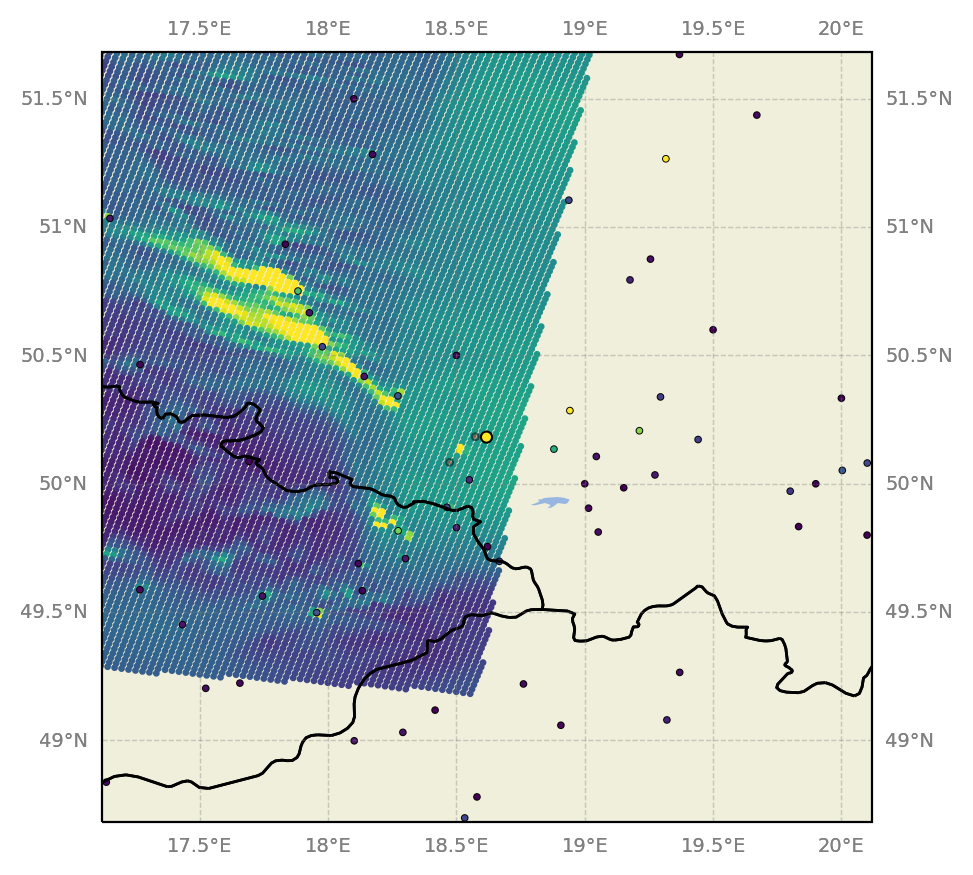

In [203]:
plot_all_facilities_asdf(13,vmax=1e16)

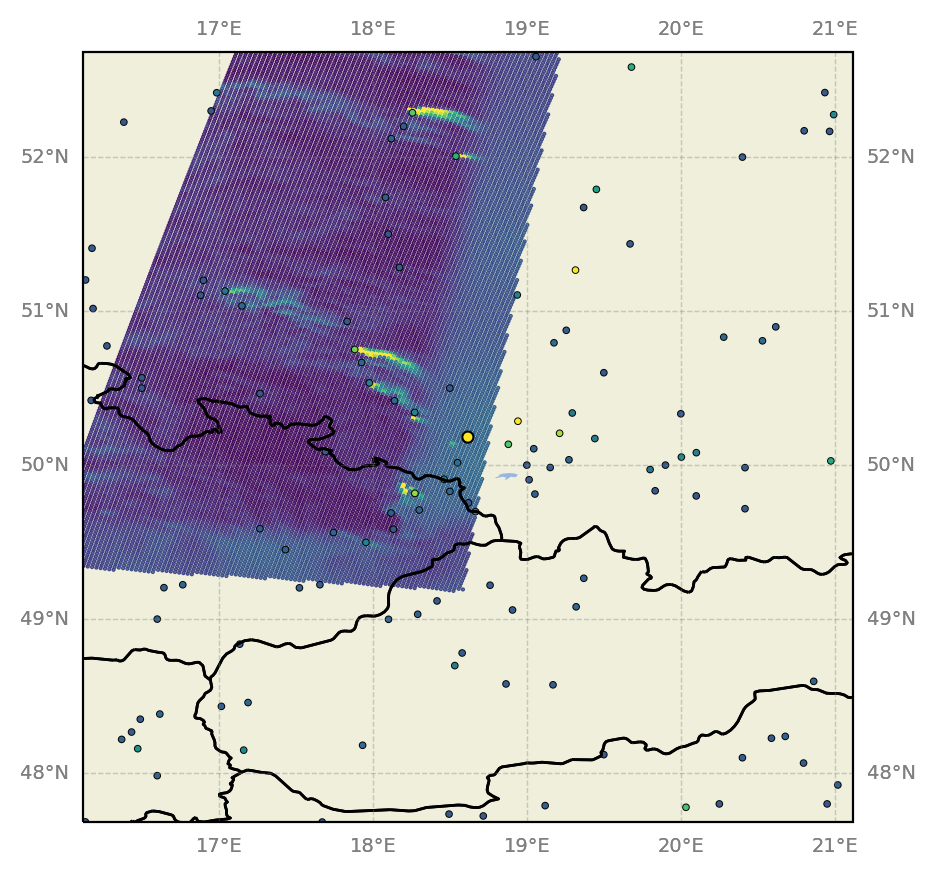

In [155]:
plot_all_facilities_asdf(20)

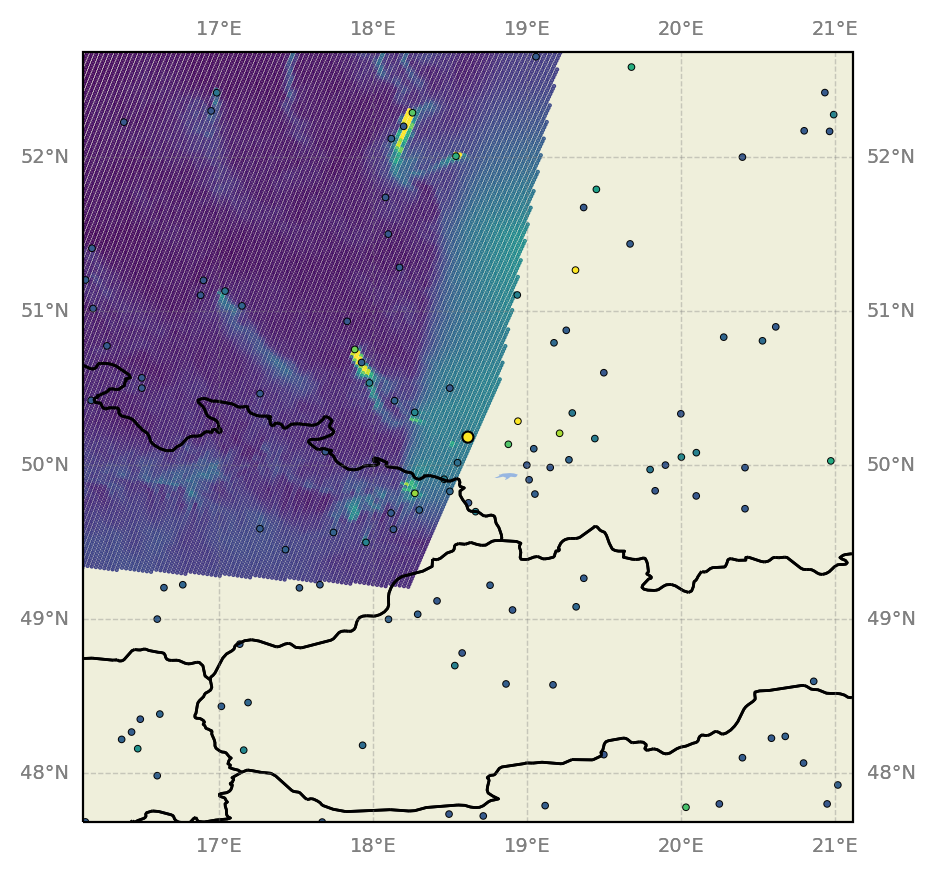

In [156]:
plot_all_facilities_asdf(49)

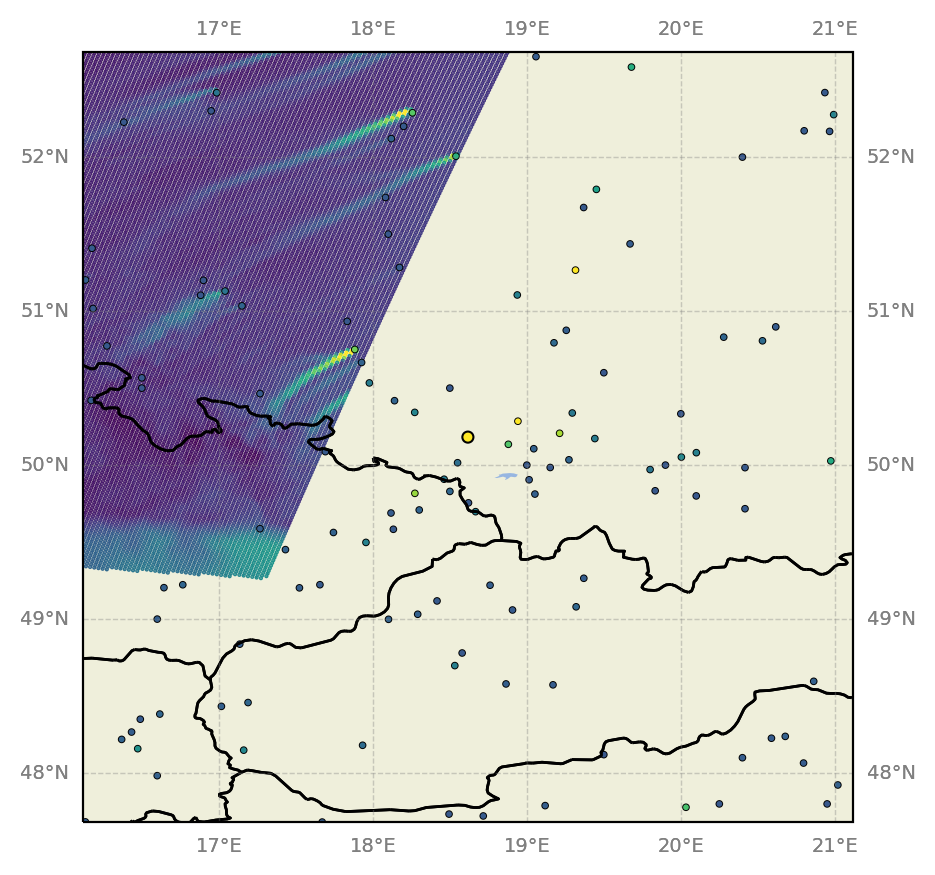

In [157]:
plot_all_facilities_asdf(3112)

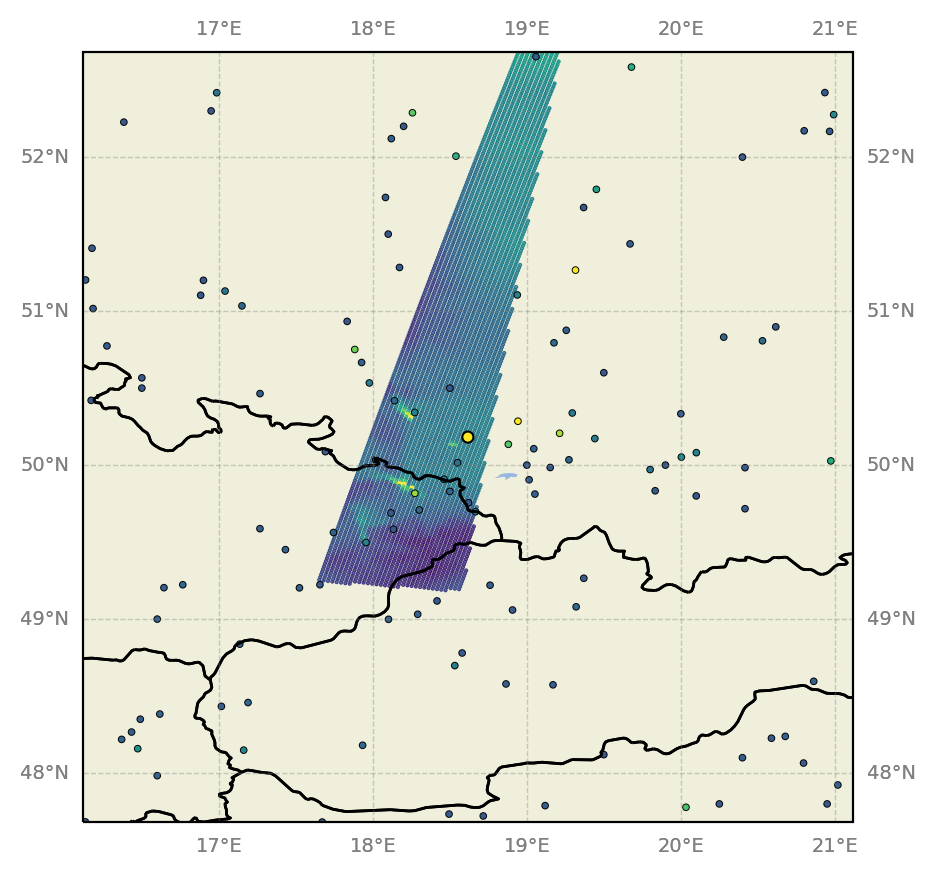

In [158]:
plot_all_facilities_asdf(3034)

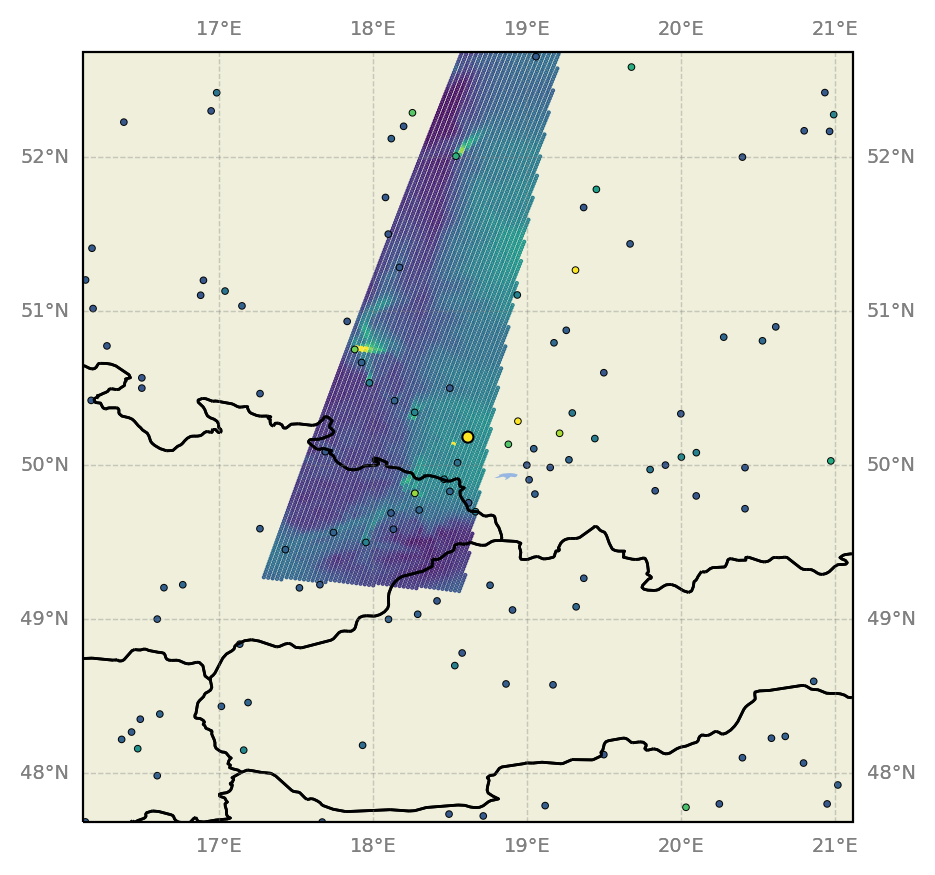

In [159]:
plot_all_facilities_asdf(200)

Find all overpasses where this facility appears in

In [79]:
mystery_facility = [df_sorted["Lon"].values[1], df_sorted["Lat"].values[1]]
mystery_facility

[18.617254777777777, 50.18182877777778]

In [108]:
filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[3034])
data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
lon, lat = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
no2 = np.array(data['NO2']).flatten()
not_nan = np.logical_not(np.isnan(no2))
lon, lat = lon[not_nan], lat[not_nan] 
no2 = no2[not_nan]

In [114]:
np.array(data['NO2']).flatten()[~np.isnan(np.array(data['NO2']).flatten())]

np.array(data['NO2_noisefree']).flatten()[~np.isnan(np.array(data['NO2_noisefree']).flatten())]

array([6.040380e+15, 5.933214e+15, 5.836156e+15, ..., 3.412811e+15,
       3.301705e+15, 3.206195e+15], dtype=float32)

In [147]:
(((np.abs(np.transpose([lon, lat])-mystery_facility)<0.01).sum(axis=1))==2).sum()>0

0

In [151]:
files_with_mystery_facility = []


for i in tqdm(range(len(SMARTCARB_filenames_all))):
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
    lon, lat = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
    no2 = np.array(data['NO2']).flatten()
    not_nan = np.logical_not(np.isnan(no2))
    lon, lat = lon[not_nan], lat[not_nan] 
    no2 = no2[not_nan]
    
    # Is there any data around the mystery facility?
    if (((np.abs(np.transpose([lon, lat])-mystery_facility)<0.1).sum(axis=1))==2).sum()>0:
        files_with_mystery_facility.append(i)




  0%|          | 0/3124 [00:00<?, ?it/s]

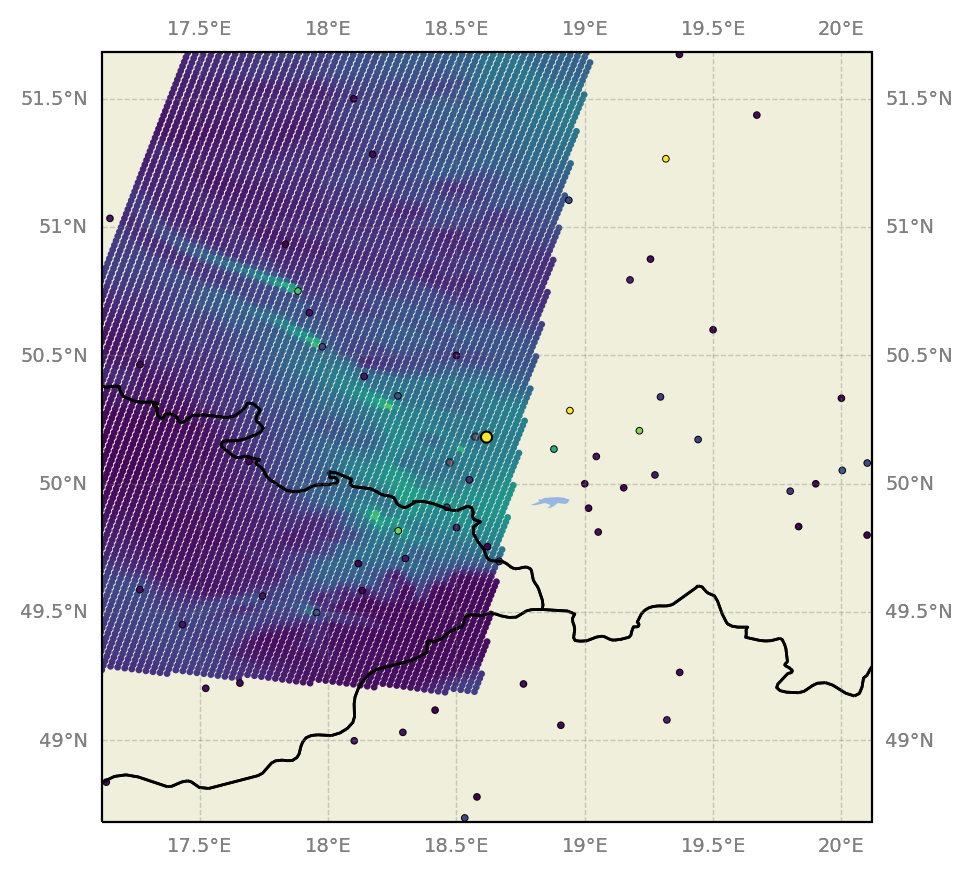

In [204]:
plot_all_facilities_asdf(files_with_mystery_facility[30], vmin=0, vmax=4e16)

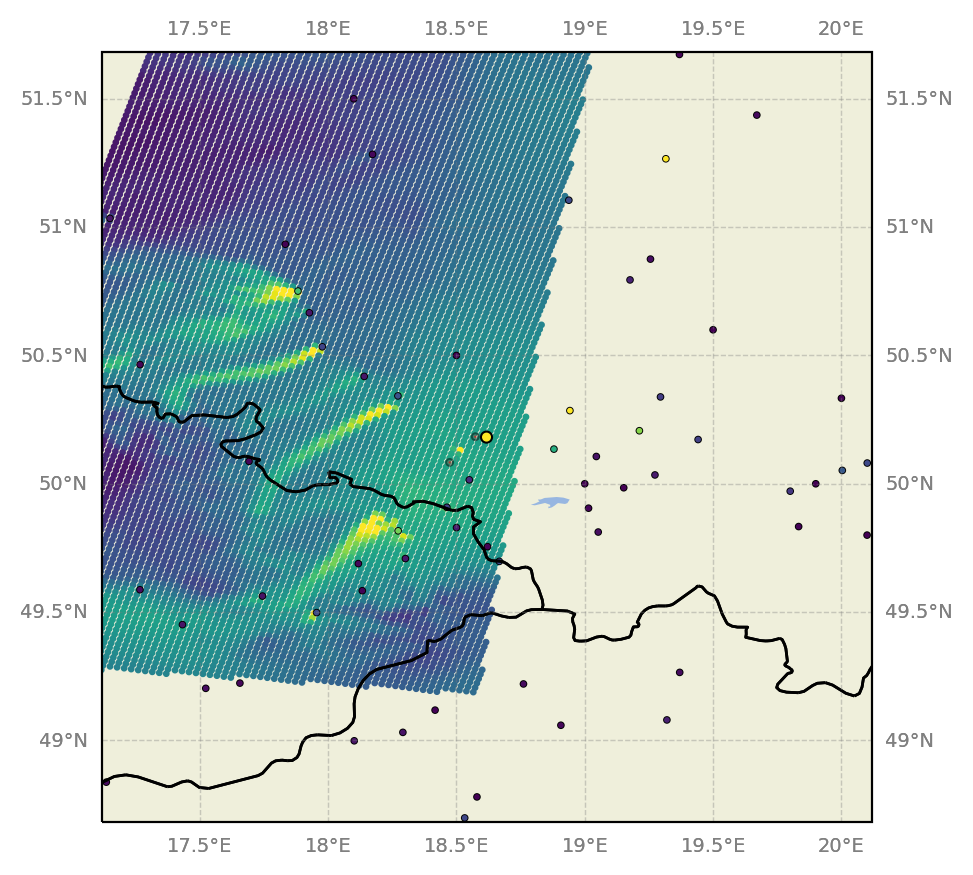

In [205]:
plot_all_facilities_asdf(files_with_mystery_facility[33], vmax=1e16)

## REMOVING THE BOUNDARIES WITH 50km MARGINS DUE TO A ISSUE

This explains the myster facility. Apparently the simulations are broken near the boundaries.

In [234]:
# Boundary points

boundary_points = np.concatenate((np.transpose([DOMAIN.lon[0,:], DOMAIN.lat[0,:]]), np.transpose([DOMAIN.lon[-1,:], DOMAIN.lat[-1,:]]), np.transpose([DOMAIN.lon[:,0], DOMAIN.lat[:,0]]), np.transpose([DOMAIN.lon[:,-1], DOMAIN.lat[:,-1]])), axis=0)
boundary_points

array([[ 7.8469288 , 49.48076173],
       [ 7.86230006, 49.48103552],
       [ 7.87767148, 49.48130734],
       ...,
       [19.70037249, 55.12379586],
       [19.7025519 , 55.13371793],
       [19.7047324 , 55.14363995]])

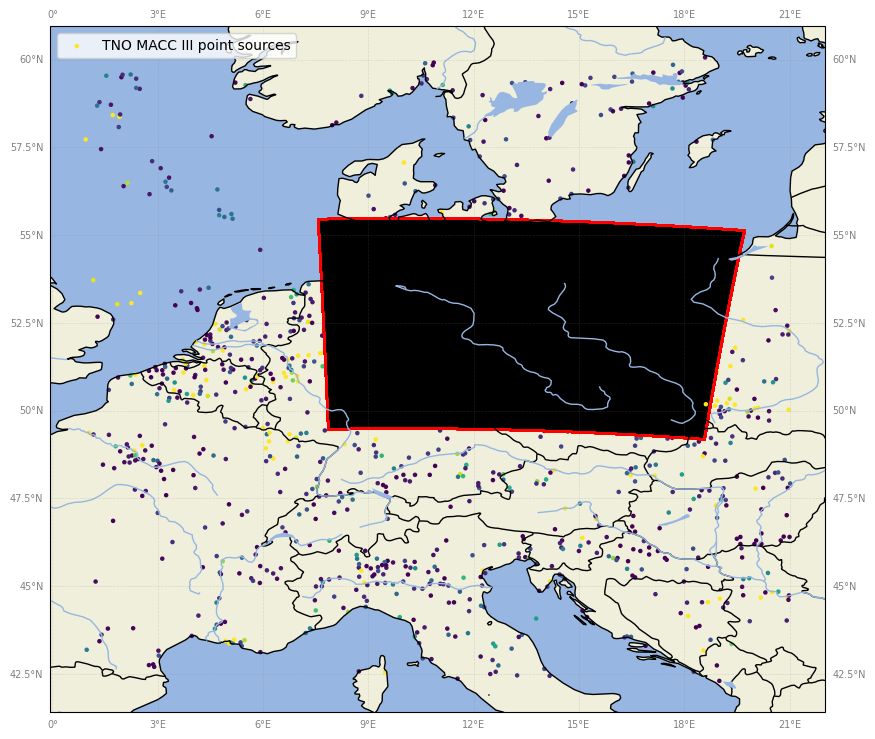

In [236]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])


# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

plt.legend()
plt.show()

In [238]:
def remove_boundaries_with_margin(lon, lat, margin=50):
    """_summary_

    Args:
        lon (_type_): is a
        lat (_type_): _description_
        margin (int, optional): _description_. Defaults to 50.

    Returns:
        _type_: _description_
    """
    
    # Boundary points
    boundary_points = np.concatenate((np.transpose([DOMAIN.lon[0,:], DOMAIN.lat[0,:]]), np.transpose([DOMAIN.lon[-1,:], DOMAIN.lat[-1,:]]), np.transpose([DOMAIN.lon[:,0], DOMAIN.lat[:,0]]), np.transpose([DOMAIN.lon[:,-1], DOMAIN.lat[:,-1]])), axis=0)
    boundary_points

    # Remove all points that are within margin (km) of the boundary
    is_within_margin = np.any(haversine_distances(np.radians(boundary_points), np.radians(np.transpose([lon, lat]))) * 6371 <= margin, axis=0)
    lon = lon[~is_within_margin]
    lat = lat[~is_within_margin]
    return lon, lat, is_within_margin

In [258]:
boundary_points

array([[ 7.8469288 , 49.48076173],
       [ 7.86230006, 49.48103552],
       [ 7.87767148, 49.48130734],
       ...,
       [19.70037249, 55.12379586],
       [19.7025519 , 55.13371793],
       [19.7047324 , 55.14363995]])

In [274]:
len(dist),len(DOMAIN.lon[i])

(700, 700)

In [275]:
is_within_boundary = []

for i in range(len(DOMAIN.lon)):
    dist = np.any(haversine_distances(np.radians(boundary_points), np.radians( np.transpose([DOMAIN.lon[i], DOMAIN.lat[i]]) )) * 6371 < 50, axis=0)
    is_within_boundary.append(dist)

In [279]:
is_within_boundary = np.array(is_within_boundary)

In [271]:

D_lon, D_lat, is_within_margin = remove_boundaries_with_margin(DOMAIN.lon, DOMAIN.lat)


ValueError: Buffer has wrong number of dimensions (expected 2, got 3)

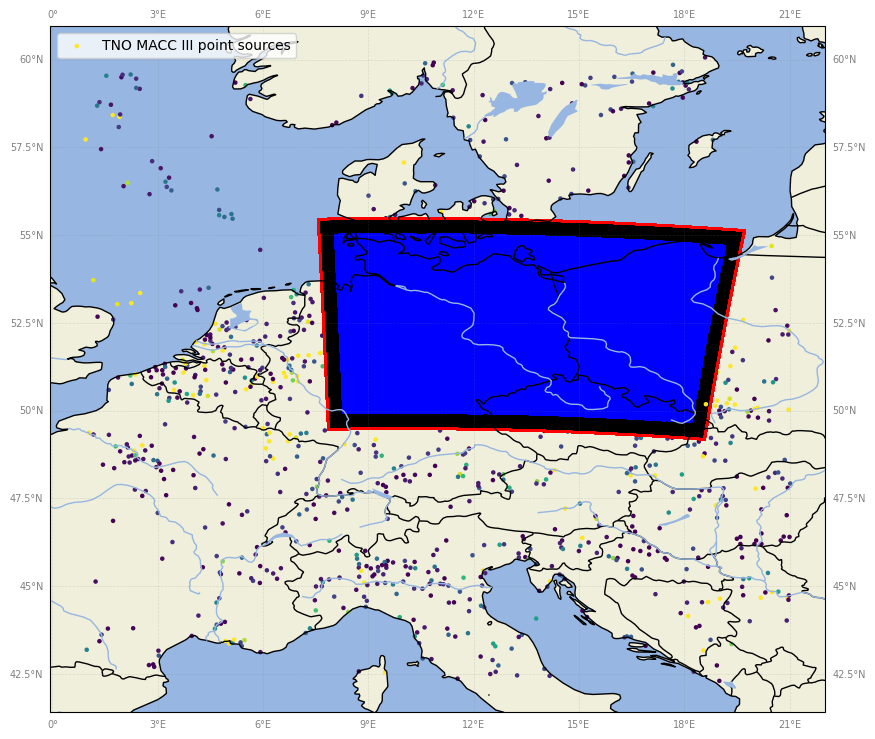

In [241]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])


# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

ax.scatter(D_lon, D_lat, c='b', transform=ccrs.PlateCarree(), s=1)


# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

plt.legend()
plt.show()

Lets approximate the new domain with lines
OR just remove with straight lines in PlateCarree

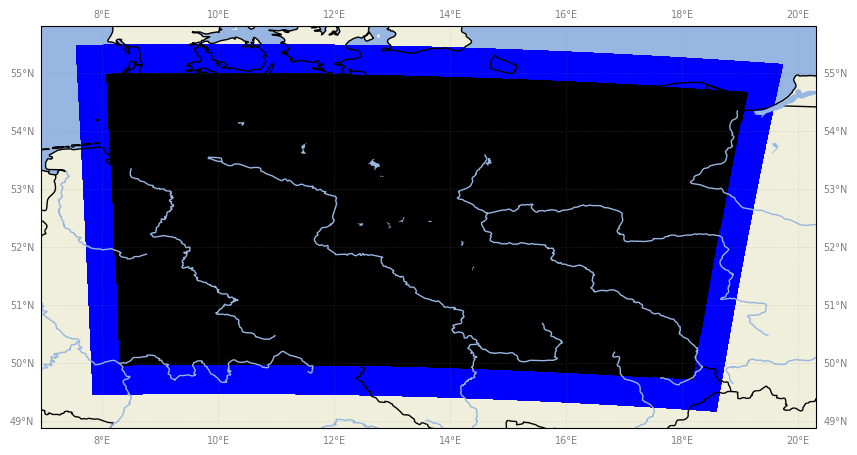

In [282]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

#ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])


# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

#ax.scatter(D_lon, D_lat, c='b', transform=ccrs.PlateCarree(), s=1)

ax.scatter(DOMAIN.lon[is_within_boundary], DOMAIN.lat[is_within_boundary], c='b', transform=ccrs.PlateCarree(), s=1)

# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

#plt.legend()
plt.show()

In [315]:
matrix = [[1, 2, 3, 4, 0], [5, 6, 7, 8, 0], [9, 10, 11, 12, 0], [13, 14, 15, 16, 0]]
matrix

[[1, 2, 3, 4], [5, 6, 7, 8], [9, 10, 11, 12], [13, 14, 15, 16]]

In [317]:
def remove_outer_layer(matrix):
    if len(matrix) < 3 or len(matrix[0]) < 3:
        raise ValueError("Matrix is too small to remove outer layer")
    return [row[1:-1] for row in matrix[1:-1]]

matrix = [[1, 2, 3, 4, 0], [5, 6, 7, 8, 0], [9, 10, 11, 12, 0], [13, 14, 15, 16, 0]]
new_matrix = remove_outer_layer(matrix)
print(new_matrix)  # Outputs: [[6, 7], [10, 11]]

[[6, 7, 8], [10, 11, 12]]


In [358]:
def remove_top_bottom(matrix):
    if len(matrix) < 3:
        raise ValueError("Matrix is too small to remove top and bottom rows")
    return matrix[1:-1]

In [321]:
mat_lon, mat_lat = DOMAIN.lon, DOMAIN.lat


In [388]:
mat_lon, mat_lat = remove_outer_layer(mat_lon), remove_outer_layer(mat_lat)

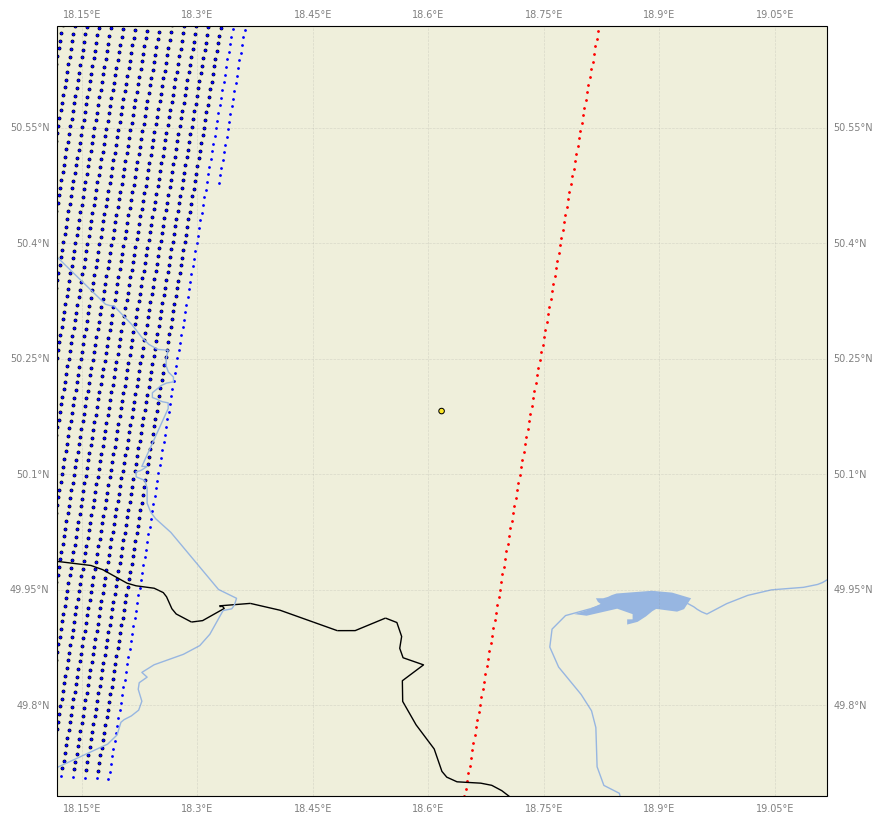

In [389]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

#ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(mat_lon, mat_lat, c='black', transform=ccrs.PlateCarree(), s=3)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])


# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

ax.scatter(D_lon, D_lat, c='b', transform=ccrs.PlateCarree(), s=1)

#ax.scatter(DOMAIN.lon[is_within_boundary], DOMAIN.lat[is_within_boundary], c='b', transform=ccrs.PlateCarree(), s=1)


# Set extent 
extent = [df_sorted["Lon"].values[1]-0.5, df_sorted["Lon"].values[1]+0.5, df_sorted["Lat"].values[1]-0.5, df_sorted["Lat"].values[1]+0.5]
ax.set_extent(extent)
# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

#plt.legend()
plt.show()

In [396]:
# Corner points
print(np.array(mat_lon)[0,0], np.array(mat_lat)[0,0])
print(np.array(mat_lon)[0,-1], np.array(mat_lat)[0,-1])
print(np.array(mat_lon)[-1,0], np.array(mat_lat)[-1,0])
print(np.array(mat_lon)[-1,-1], np.array(mat_lat)[-1,-1])

8.30719191586997 49.978223611443795
18.170863673993093 49.714611423704575
8.11852620338014 54.986911033026324
19.072041357791836 54.694193446535714


In [397]:
# Corner points
a = [8.30719191586997, 49.978223611443795]
b = [18.170863673993093, 49.714611423704575]
c = [8.11852620338014, 54.986911033026324]
d = [19.072041357791836, 54.694193446535714]

In [401]:
# Function of a line between a and b
lambda_ab = lambda x: (b[1]-a[1])/(b[0]-a[0])*(x[0]-a[0])+a[1]-x[1]

In [403]:
lambda_ab([8.11852620338014, 54.986911033026324])

-5.003645224068215

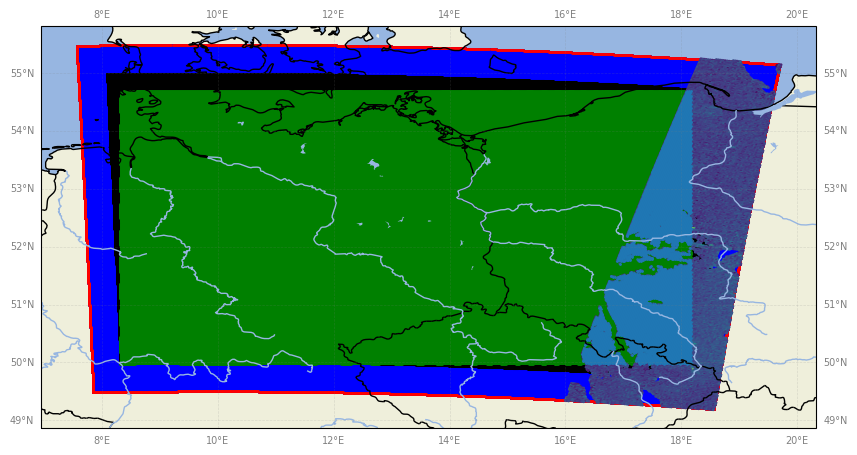

In [439]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

#ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])

ax.scatter(DOMAIN.lon[is_within_boundary], DOMAIN.lat[is_within_boundary], c='b', transform=ccrs.PlateCarree(), s=1)

# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

lon,lat = remove_points_outside_domain(D_lon,D_lat)

ax.scatter(lon,lat, c='g', transform=ccrs.PlateCarree(), s=1)
 
#ax.set_extent(domain_extent)


filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[13])
data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
lon1, lat1 = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
no21 = np.array(data['NO2']).flatten()
not_nan = np.logical_not(np.isnan(no21))
lon1, lat1 = lon1[not_nan], lat1[not_nan] 
no21 = no21[not_nan]

ax.scatter(lon1, lat1, c=no21, transform=ccrs.PlateCarree(), s=1)

lon1,lat1 = remove_points_outside_domain(lon1,lat1)

ax.scatter(lon1, lat1, transform=ccrs.PlateCarree(), s=1)



# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

#plt.legend()
plt.show()

In [418]:
# Corner points
np.min(D_lon), np.max(D_lon), np.min(D_lat), np.max(D_lat)
domain_extent = [np.min(D_lon), np.max(D_lon), np.min(D_lat), np.max(D_lat)]

In [ ]:
# Corner points
a = [8.30719191586997, 49.978223611443795]
b = [18.170863673993093, 49.714611423704575]
c = [8.11852620338014, 54.986911033026324]
d = [19.072041357791836, 54.694193446535714]

In [438]:
def remove_points_outside_domain(lon, lat, domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]):
    area_boolean = np.logical_and(np.logical_and(lon>=domain_extent[0], lon<=domain_extent[1]), np.logical_and(lat>=domain_extent[2], lat<=domain_extent[3]))
    return lon[area_boolean], lat[area_boolean] 

In [432]:
np.sum(lon>domain_extent[1])

0

In [ ]:
mat_lon, mat_lat = DOMAIN.lon, DOMAIN.lat


In [309]:
# Remove all sides with all True==
is_within_boundary_copy[is_within_boundary_copy.sum(axis=1)<=59] = 2
is_within_boundary_copy = np.transpose(is_within_boundary_copy)


In [311]:
is_within_boundary_copy.sum(axis=1)

array([600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600,
       600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600, 600,
       600, 598, 598, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596,
       596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 596, 59

In [251]:
filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[100])
data = ddeq.smartcarb.read_level2(filename, co2_noise_scenario='low', no2_noise_scenario='high', co_noise_scenario='low', only_observations=False)
lon, lat = np.array(data['lon']).flatten(), np.array(data['lat']).flatten()
no2 = np.array(data['NO2']).flatten()
not_nan = np.logical_not(np.isnan(no2))
lon, lat = lon[not_nan], lat[not_nan] 
no2 = no2[not_nan]

In [250]:
DOMAIN.lon

array([[ 7.8469288 ,  7.86230006,  7.87767148, ..., 18.53377974,
        18.54897739, 18.56417439],
       [ 7.8465054 ,  7.86187968,  7.87725413, ..., 18.53544245,
        18.55064301, 18.56584291],
       [ 7.84608183,  7.86145913,  7.8768366 , ..., 18.53710583,
        18.55230929, 18.56751209],
       ...,
       [ 7.55795025,  7.57538139,  7.59281279, ..., 19.66604458,
        19.68320904, 19.70037249],
       [ 7.5573946 ,  7.5748297 ,  7.59226506, ..., 19.66821649,
        19.6853847 , 19.7025519 ],
       [ 7.55683867,  7.57427773,  7.59171705, ..., 19.67038947,
        19.68756144, 19.7047324 ]])

In [252]:
data


<xarray.Dataset>
Dimensions:        (nobs: 811, nrows: 123, ncorners: 4)
Dimensions without coordinates: nobs, nrows, ncorners
Data variables: (12/19)
    time           datetime64[ns] 2015-07-16T11:00:00
    lon            (nobs, nrows) float32 12.08 12.12 12.15 ... 9.198 9.224 9.251
    lat            (nobs, nrows) float32 60.54 60.54 60.53 ... 46.03 46.03 46.02
    lonc           (nobs, nrows, ncorners) float32 12.07 12.1 ... 9.261 9.234
    latc           (nobs, nrows, ncorners) float32 60.55 60.55 ... 46.01 46.02
    clouds         (nobs, nrows) float32 nan nan nan nan nan ... nan nan nan nan
    ...             ...
    NO2_std        (nobs, nrows) float32 2e+15 2e+15 2e+15 ... 2e+15 2e+15 2e+15
    NO2_noise      (nobs, nrows) float32 nan nan nan nan nan ... nan nan nan nan
    CO_noisefree   (nobs, nrows) float32 nan nan nan nan nan ... nan nan nan nan
    CO             (nobs, nrows) float32 nan nan nan nan nan ... nan nan nan nan
    CO_std         (nobs, nrows) float32 4e+17 4e+17 4e+17 ... 4e+17 4e+17 4e+17
    CO_noise       (nobs, nrows) float32 nan nan nan nan nan ... nan nan nan nan
Attributes:
    satellite:  CO2M
    orbit:      2923
    lon_eq:     1610

In [ ]:
df_sorted.iloc[1,:]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=5, label='TNO MACC III point sources')

ax.scatter(DOMAIN.lon, DOMAIN.lat, c='black', transform=ccrs.PlateCarree(), s=1)
ax.scatter(df_sorted["Lon"].values[1], df_sorted["Lat"].values[1], c=df_sorted["NOX"].values[1], vmin=0, vmax=16000, transform=ccrs.PlateCarree(), s=5, path_effects=[pe.withStroke(linewidth=2.5, foreground="black", alpha=1)])


# Boundary points
ax.scatter(boundary_points[:,0], boundary_points[:,1], c='r', transform=ccrs.PlateCarree(), s=1)

ax.scatter(D_lon, D_lat, c='b', transform=ccrs.PlateCarree(), s=1)


# Gridlines
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
gl.xlabel_style = {'size': 7, 'color': 'gray'}
gl.ylabel_style = {'size': 7, 'color': 'gray'}

plt.legend()
plt.show()

# Comparisons of plume detection methods v2.0
With new domain. And with different noise scenarios.

## Preprosessing of TNO-MACC III data

In [8]:
TNO_MACC_III = pd.read_csv('TNO_MACC_III_emissions_2011.txt', delimiter=";")

# Only point sources. Meaning only rows where SourceType == 'P'
TNO_MACC_III_point_sources = TNO_MACC_III[TNO_MACC_III.SourceType == 'P']

# Use only points in this domain
extent = [5.86-5, 15.04+6, 47.27-5, 55.09+5]
TNO_MACC_III_point_sources = TNO_MACC_III_point_sources[(TNO_MACC_III_point_sources["Lon"] > extent[0]) 
                                                               & (TNO_MACC_III_point_sources["Lon"] < extent[1])
                                                                & (TNO_MACC_III_point_sources["Lat"] > extent[2])
                                                                & (TNO_MACC_III_point_sources["Lat"] < extent[3])]

display(TNO_MACC_III)
display(TNO_MACC_III_point_sources)

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
0,-29.9375,36.40625,ATL,2011,8,A,0.000000,0.063392,0.000000,0.018761,0.634203,0.048957,0.046509,0.417624
1,-29.9375,36.59375,ATL,2011,8,A,0.000000,0.306779,0.000000,0.090795,3.069150,0.236925,0.225079,2.021039
2,-29.9375,36.71875,ATL,2011,8,A,0.000000,0.720972,0.000000,0.213381,7.212906,0.556805,0.528965,4.749709
3,-29.9375,36.90625,ATL,2011,8,A,0.000000,0.942698,0.000000,0.279004,9.431144,0.728043,0.691641,6.210421
4,-29.9375,37.28125,ATL,2011,8,A,0.000000,1.368561,0.000000,0.405044,13.691649,1.056936,1.004089,9.015970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2153556,59.9375,68.71875,RUS,2011,8,A,0.000077,0.092780,0.000089,0.013108,0.039964,0.004249,0.003921,0.002002
2153557,59.9375,68.71875,RUS,2011,34,A,0.012773,0.017403,0.000029,0.000600,0.019378,0.005825,0.002151,0.031185
2153558,59.9375,68.71875,RUS,2011,72,A,0.001028,0.045246,0.000025,0.003632,0.046640,0.002300,0.002294,0.001133
2153559,59.9375,69.65625,RUS,2011,71,A,0.010413,1.144412,0.003486,0.140172,0.076558,0.001305,0.001254,0.000639


,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
197186,0.940000,47.140000,FRA,2011,9,P,969.940226,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
197188,1.000000,57.185277,GBR,2011,5,P,847.621976,0.000000,0.000000,471.536179,0.000000,0.000000,0.000000,0.000000
197189,1.033330,51.366670,GBR,2011,34,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.396020,0.114845,0.000000
197190,1.050000,49.460000,FRA,2011,34,P,0.000000,0.000000,0.000000,412.584733,0.000000,0.000000,0.000000,0.000000
198766,1.083732,58.228349,GBR,2011,1,P,0.000000,0.000000,0.000000,3.006014,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1821893,21.000000,46.400000,HUN,2011,5,P,80.557514,5.391944,0.002695,13.788148,0.898657,1.150281,1.150281,0.005391
1821894,21.000000,47.950000,HUN,2011,1,P,69.116510,0.000000,1.276921,11.711644,0.000000,0.641545,0.444863,0.000000
1821895,21.010000,50.020000,POL,2011,1,P,4.850069,0.000000,0.000000,61.423833,0.000000,74.251620,55.638380,0.000000
1821896,21.022157,47.916708,HUN,2011,34,P,0.000000,0.000000,0.000000,0.000000,241.456474,0.000000,0.000000,0.000000


In [9]:
# Remove points outside domain

lon = TNO_MACC_III_point_sources['Lon'].values
lat = TNO_MACC_III_point_sources['Lat'].values

domain_extent=[8.30719191586997-0.1, 18.170863673993093+0.1, 49.978223611443795-0.1, 54.694193446535714+0.1]
area_boolean = np.logical_and(np.logical_and(lon>=domain_extent[0], lon<=domain_extent[1]), np.logical_and(lat>=domain_extent[2], lat<=domain_extent[3]))

TNO_MACC_III_point_sources = TNO_MACC_III_point_sources[area_boolean]

TNO_MACC_III_point_sources

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
296211,8.216710,52.950190,DEU,2011,5,P,0.000000,40.009606,0.114313,2.273320,107.942108,0.274351,0.243868,0.457735
296214,8.257033,50.031886,DEU,2011,34,P,0.000000,0.000000,0.000000,0.000000,178.463463,0.000000,0.000000,0.000000
296215,8.263678,50.044533,DEU,2011,9,P,25478.030215,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
296220,8.310000,49.966666,DEU,2011,34,P,0.201878,0.000000,59.533271,40.873589,0.000000,420.699976,116.514610,0.000000
298291,8.316730,52.833500,DEU,2011,1,P,0.000000,121.711422,1.798242,6.233374,356.103630,0.099467,0.080931,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1801320,18.144414,50.418896,POL,2011,34,P,765.535979,13834.063167,5.515753,1181.367858,0.000000,560.514724,366.209981,5786.159239
1802207,18.208334,50.071667,POL,2011,1,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,216.890562
1802208,18.231726,52.305487,POL,2011,1,P,0.000000,988.694200,0.000000,0.000000,8742.530926,0.000000,0.000000,8255.468006
1802209,18.240277,52.767222,POL,2011,1,P,0.000000,0.000000,0.000000,0.000000,151.667203,0.000000,0.000000,374.732385


#### Cluster the closest point sources as one.


In [10]:
# Convert Lat and Long to radians
location_radians = np.radians(TNO_MACC_III_point_sources[['Lat', 'Lon']])

# Calculate the haversine distance between all the facilities
haversine_distance_of_point_sources = haversine_distances(location_radians, location_radians) * 6371 # multiply by Earth radius to get kilometers


# Spatial resoluion of SMARTCARB dataset is 2x2 km, so the diameter of a pixel is 2*sqrt(2) = 2.828 km
# We consider all points within one pixel as one cluster. 


cluster_radius = 2.828 # km 

# Do a DBSCAN clustering with the haversine distance matrix
from sklearn.cluster import DBSCAN 

TNO_MACC_III_point_sources_clusters = DBSCAN(eps=cluster_radius, min_samples=1, metric='precomputed').fit(haversine_distance_of_point_sources)


# Check what is the maximum pointwise distance between points in each cluster

max_distance_within_cluster = np.array([0.0]*np.unique(TNO_MACC_III_point_sources_clusters.labels_).shape[0])

print("Number of clusters:" ,len(np.unique(TNO_MACC_III_point_sources_clusters.labels_)))
print("Length of dataset:", len(TNO_MACC_III_point_sources))

# Go through all clusters and calculate the maximum distance between points in each cluster
for i in np.unique(TNO_MACC_III_point_sources_clusters.labels_):
    max_distance_within_cluster[i] = np.max(haversine_distance_of_point_sources[TNO_MACC_III_point_sources_clusters.labels_ == i][:,TNO_MACC_III_point_sources_clusters.labels_ == i])

print("Number of clusters with max distance greater than 3 km: ", (max_distance_within_cluster>3).sum())
print("Number of clusters with max distance greater than 6 km: ", (max_distance_within_cluster>6).sum())
print("Maximum distance within a cluster: ", max_distance_within_cluster.max())

Number of clusters: 398
Length of dataset: 683
Number of clusters with max distance greater than 3 km:  7
Number of clusters with max distance greater than 6 km:  0
Maximum distance within a cluster:  5.199131776831219


In [11]:
# Add cluster labels in dataframe
TNO_MACC_III_point_sources = TNO_MACC_III_point_sources.copy()
TNO_MACC_III_point_sources['cluster'] = TNO_MACC_III_point_sources_clusters.labels_
TNO_MACC_III_point_sources["Index"] = TNO_MACC_III_point_sources.index
TNO_MACC_III_point_sources

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2,cluster,Index
296211,8.216710,52.950190,DEU,2011,5,P,0.000000,40.009606,0.114313,2.273320,107.942108,0.274351,0.243868,0.457735,0,296211
296214,8.257033,50.031886,DEU,2011,34,P,0.000000,0.000000,0.000000,0.000000,178.463463,0.000000,0.000000,0.000000,1,296214
296215,8.263678,50.044533,DEU,2011,9,P,25478.030215,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,296215
296220,8.310000,49.966666,DEU,2011,34,P,0.201878,0.000000,59.533271,40.873589,0.000000,420.699976,116.514610,0.000000,2,296220
298291,8.316730,52.833500,DEU,2011,1,P,0.000000,121.711422,1.798242,6.233374,356.103630,0.099467,0.080931,0.000000,3,298291
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1801320,18.144414,50.418896,POL,2011,34,P,765.535979,13834.063167,5.515753,1181.367858,0.000000,560.514724,366.209981,5786.159239,290,1801320
1802207,18.208334,50.071667,POL,2011,1,P,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,216.890562,397,1802207
1802208,18.231726,52.305487,POL,2011,1,P,0.000000,988.694200,0.000000,0.000000,8742.530926,0.000000,0.000000,8255.468006,292,1802208
1802209,18.240277,52.767222,POL,2011,1,P,0.000000,0.000000,0.000000,0.000000,151.667203,0.000000,0.000000,374.732385,340,1802209


In [12]:
# Combine the facilities that are in the same cluster

TNO_MACC_III_point_sources_clusters_combined = TNO_MACC_III_point_sources.groupby("cluster").agg(
    {
        "Index": [lambda x: ", ".join(str(i) for i in x), "count"],
        "Lon": "mean",
        "Lat": "mean",
        "CH4": "sum",	
        "CO": "sum",	
        "NH3": "sum",
        "NMVOC": "sum",
        "NOX": "sum",
        "PM10": "sum",
        "PM2_5": "sum",
        "SO2": "sum",
    }
)
""
TNO_MACC_III_point_sources_clusters_combined.columns = ["Indexses", "count", "Lon", "Lat", "CH4", "CO", "NH3", "NMVOC", "NOX", "PM10", "PM2_5", "SO2"]

TNO_MACC_III_point_sources_clusters_combined

,Indexses,count,Lon,Lat,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
cluster,,,,,,,,,,,,
0,"296211, 352554",2,8.216710,52.950190,0.000000,344.288162,4.609918,17.856757,998.201183,0.523019,0.446197,0.457735
1,"296214, 296215, 325885, 352556, 352557, 1722760",6,8.250495,50.033010,28209.842693,0.000000,69.941492,197.043405,846.799796,349.833673,122.886351,0.000000
2,296220,1,8.310000,49.966666,0.201878,0.000000,59.533271,40.873589,0.000000,420.699976,116.514610,0.000000
3,"298291, 356605",2,8.316730,52.833500,0.000000,137.715264,1.843967,7.142702,399.280473,0.209207,0.178478,0.183094
4,"298295, 328661, 328662, 328664, 356606, 356607...",7,8.343840,51.597502,1965.930999,0.000000,142.421903,97.782202,2396.349025,1006.443789,278.738797,245.658057
...,...,...,...,...,...,...,...,...,...,...,...,...
393,1800420,1,17.983330,53.135830,0.000000,0.000000,0.000000,0.000000,131.083797,0.000000,0.000000,488.287653
394,1800422,1,18.015913,51.280158,2399.218543,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
395,1800423,1,18.058333,51.746111,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,179.417323


In [13]:
TNO_MACC_III_point_sources_NOX = TNO_MACC_III_point_sources_clusters_combined.query("NOX > 0")[["Lon", "Lat", "NOX"]]
TNO_MACC_III_point_sources_NOX

,Lon,Lat,NOX
cluster,,,
0,8.216710,52.950190,998.201183
1,8.250495,50.033010,846.799796
3,8.316730,52.833500,399.280473
4,8.343840,51.597502,2396.349025
7,8.450000,53.230000,4.593487
...,...,...,...
384,14.626912,52.593782,152.651802
386,14.750000,52.130000,1307.506414
387,15.640440,49.895458,954.568557


In [14]:
# Add columns for tracking how many times a facility is found or missed by my algorithm
TNO_MACC_III_point_sources_NOX.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX

,Lon,Lat,NOX,Times found,Times missed
cluster,,,,,
0,8.216710,52.950190,998.201183,0,0
1,8.250495,50.033010,846.799796,0,0
3,8.316730,52.833500,399.280473,0,0
4,8.343840,51.597502,2396.349025,0,0
7,8.450000,53.230000,4.593487,0,0
...,...,...,...,...,...
384,14.626912,52.593782,152.651802,0,0
386,14.750000,52.130000,1307.506414,0,0
387,15.640440,49.895458,954.568557,0,0


In [15]:
# Add columns for tracking how many times a facility is found or missed by my algorithm

TNO_MACC_III_point_sources_NOX.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX.loc[:, "Missed in files"] = ""
TNO_MACC_III_point_sources_NOX

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files
cluster,,,,,,,
0,8.216710,52.950190,998.201183,0,0,,
1,8.250495,50.033010,846.799796,0,0,,
3,8.316730,52.833500,399.280473,0,0,,
4,8.343840,51.597502,2396.349025,0,0,,
7,8.450000,53.230000,4.593487,0,0,,
...,...,...,...,...,...,...,...
384,14.626912,52.593782,152.651802,0,0,,
386,14.750000,52.130000,1307.506414,0,0,,
387,15.640440,49.895458,954.568557,0,0,,


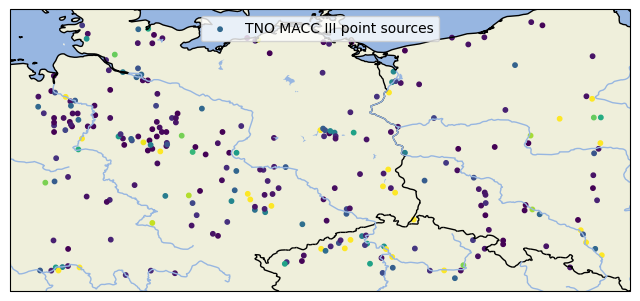

In [16]:
# Plot the point sources on a map

fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS)
ax.add_feature(cfeature.LAND)
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)

ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'].values, TNO_MACC_III_point_sources_NOX['Lat'].values, c=TNO_MACC_III_point_sources_NOX['NOX'].values, vmin=0, vmax=3000, transform=ccrs.PlateCarree(), s=10, label='TNO MACC III point sources')
plt.legend()
plt.show()

In [17]:
import cluster as clt

# My clustering algorithm
clusters = clt.density_based_clustering_with_varying_radius(
    points,
    no2_notnan,
    radius_func="default",
    n_clusters="auto",
    point_value_threshold="stds_from_mean",
    stds=3.2,
    distance_matrix="euclidean",
    radius_func_sigmas_threshold=1.4,
    max_points_in_start_radius=5,
    local_box_size=3,
    verbose=True,
)

NameError: name 'points' is not defined

In [18]:
# Get the SMARTCARB data from files and save the data to lon, lat and no2
filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[14])
data = ddeq.smartcarb.read_level2(
    filename,
    co2_noise_scenario=None,
    no2_noise_scenario="low",
    co_noise_scenario=None,
    only_observations=False,
)

lon = np.array(data["lon"]).flatten()
lat = np.array(data["lat"]).flatten()
no2 = np.array(data["NO2"]).flatten()
not_nan = np.logical_not(np.isnan(no2))
lon = lon[not_nan]
lat = lat[not_nan]
no2 = no2[not_nan]

In [19]:
data["NO2"]
data["lon"]

<xarray.DataArray 'lon' (nobs: 811, nrows: 123)>
array([[15.006673 , 15.0438795, 15.0810175, ..., 19.258898 , 19.294718 ,
        19.33058  ],
       [14.9967985, 15.033986 , 15.071106 , ..., 19.24698  , 19.282785 ,
        19.31863  ],
       [14.986934 , 15.024102 , 15.061203 , ..., 19.235077 , 19.270863 ,
        19.306694 ],
       ...,
       [ 9.026622 ,  9.053577 ,  9.080488 , ..., 12.137951 , 12.164447 ,
        12.190981 ],
       [ 9.020892 ,  9.04784  ,  9.074742 , ..., 12.131271 , 12.157761 ,
        12.184286 ],
       [ 9.015166 ,  9.042106 ,  9.068999 , ..., 12.124597 , 12.151077 ,
        12.177595 ]], dtype=float32)
Dimensions without coordinates: nobs, nrows
Attributes:
    standard_name:  longitude
    long_name:      pixel center longitude
    units:          degrees east

In [470]:
np.array(data["lon"]).flatten().reshape(811,123)

array([[15.006673 , 15.0438795, 15.0810175, ..., 19.258898 , 19.294718 ,
        19.33058  ],
       [14.9967985, 15.033986 , 15.071106 , ..., 19.24698  , 19.282785 ,
        19.31863  ],
       [14.986934 , 15.024102 , 15.061203 , ..., 19.235077 , 19.270863 ,
        19.306694 ],
       ...,
       [ 9.026622 ,  9.053577 ,  9.080488 , ..., 12.137951 , 12.164447 ,
        12.190981 ],
       [ 9.020892 ,  9.04784  ,  9.074742 , ..., 12.131271 , 12.157761 ,
        12.184286 ],
       [ 9.015166 ,  9.042106 ,  9.068999 , ..., 12.124597 , 12.151077 ,
        12.177595 ]], dtype=float32)

In [ ]:
import cluster as clt

# My clustering algorithm
clusters = clt.density_based_clustering_with_varying_radius(
    points,
    no2_notnan,
    radius_func="default",
    n_clusters="auto",
    point_value_threshold="stds_from_mean",
    stds=3.2,
    distance_matrix="euclidean",
    radius_func_sigmas_threshold=1.4,
    max_points_in_start_radius=5,
    local_box_size=3,
    verbose=True,
)

In [481]:
import numpy as np

# Your array
a = np.array([np.nan, np.nan, 1, 2, np.nan, 4, np.nan, np.nan, 7, 8, 9, np.nan, np.nan])

# Step 1: Store the indices of the NaN values
nan_indices = np.where(np.isnan(a))

# Step 2: Remove the NaN values and perform the operations
a_without_nans = a[~np.isnan(a)]
# Perform your operations here, for example, multiply by 2
a_without_nans = a_without_nans * 2

# Step 3: Create a new array with the same size as the original array
a_with_nans = np.empty_like(a)
# Place the NaNs at the stored indices
a_with_nans[nan_indices] = np.nan
# Place the modified values at the other indices
a_with_nans[~np.isnan(a)] = a_without_nans

## the runs - low noise
Gameplan
- For every file
    - Plume detection
    - Check if plumes are on top of facilities. If yes that is a true positive.
    - Check if plumes are not on top of a facility.
        - If its next to NAN values. Remove that.
        - If its not next to NAN values. That is a false positive.
    - Check if there are facilities that are not detected.

In [20]:
import numpy as np

# Define your matrix
matrix = np.array([[1.1,2.2,3.0],[1.2,2.5,3.7]])

# Add an outer layer of np.nan
padded_matrix = np.pad(matrix, pad_width=1, mode='constant', constant_values=np.nan)
padded_matrix

array([[nan, nan, nan, nan, nan],
       [nan, 1.1, 2.2, 3. , nan],
       [nan, 1.2, 2.5, 3.7, nan],
       [nan, nan, nan, nan, nan]])

In [253]:
TNO_MACC_III_point_sources_NOX_low_noise = TNO_MACC_III_point_sources_clusters_combined.query("NOX > 0")[["Lon", "Lat", "NOX"]]
# Add columns for tracking how many times a facility is found or missed by my algorithm
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Missed in files"] = ""

In [254]:
#v2

import cluster as clt
from tqdm.notebook import tqdm # progress bar


def adjacent_cells(matrix, number):
    rows, cols = len(matrix), len(matrix[0])
    result = [[False] * cols for _ in range(rows)]
    for i in range(rows):
        for j in range(cols):
            if matrix[i][j] == number:
                result[i][j] = True
                if i > 0:
                    result[i - 1][j] = True
                    if j > 0:
                        result[i - 1][j - 1] = True
                    if j < cols - 1:
                        result[i - 1][j + 1] = True
                if i < rows - 1:
                    result[i + 1][j] = True
                    if j > 0:
                        result[i + 1][j - 1] = True
                    if j < cols - 1:
                        result[i + 1][j + 1] = True
                if j > 0:
                    result[i][j - 1] = True
                if j < cols - 1:
                    result[i][j + 1] = True
    return result




# Reset the dataframe
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_low_noise.loc[:, "Missed in files"] = ""

my_clusters_per_file_v2_low_noise = []
number_of_facilities_in_plumes_per_file_low_noise = []
is_plume_next_to_nans_per_file_low_noise = []

## Get facility points
facility_points = TNO_MACC_III_point_sources_NOX_low_noise[["Lon", "Lat"]]

# Go through every file
for i in tqdm(range(len(SMARTCARB_filenames_all))):
    # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario=None,
        no2_noise_scenario='low',
        co_noise_scenario=None,
        only_observations=True,
    )
    lon_m = np.array(data["lon"])
    lat_m = np.array(data["lat"])
    no2_m = np.array(data["NO2"])
    
    #no2_m_padded = np.pad(no2_m, pad_width=1, mode='constant', constant_values=np.nan)
    
    # Remove points outside domain
    domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]
    area_boolean = np.logical_and(np.logical_and(lon_m>=domain_extent[0], lon_m<=domain_extent[1]), np.logical_and(lat_m>=domain_extent[2], lat_m<=domain_extent[3]))
    no2_m[~area_boolean] = np.nan
    
    lon = lon_m.flatten()
    lat = lat_m.flatten()
    no2 = no2_m.flatten()
    
    #nan_indices = np.where(np.isnan(no2))
    not_nan = np.logical_not(np.isnan(no2))
    
    lon_notNaN = lon[not_nan]
    lat_notNaN = lat[not_nan]
    no2_notNaN = no2[not_nan]
    lon_NaN = lon[~not_nan]
    lat_NaN = lat[~not_nan]
    
    
    # Continue if there are not enough points in the file
    if len(no2_notNaN) < 2: 
        number_of_facilities_in_plumes_per_file_low_noise.append([])
        is_plume_next_to_nans_per_file_low_noise.append([])
        my_clusters_per_file_v2_low_noise.append([])
        continue    

    # Plume detection
    clusters = clt.density_based_clustering_with_varying_radius(
        np.transpose([lon_notNaN, lat_notNaN]),
        no2_notNaN,
        radius_func="default",
        n_clusters="auto",
        point_value_threshold="stds_from_median",
        stds=3.3,
        distance_matrix="euclidean",
        radius_func_sigmas_threshold=1.3,
        max_points_in_start_radius=5,
        local_box_size=3,
        verbose=True,
    )

    my_clusters_per_file_v2_low_noise.append(clusters)

    # Check if there are facilities in the plumes

    ## Take only facilities that are near any points in the dataset
    is_near_any_points = np.any(
        haversine_distances(
            np.radians(facility_points),
            np.radians(np.transpose([lon_notNaN, lat_notNaN])),
        )
        * 6371
        <= 5,
        axis=1,
    )
    facilities_in_file = facility_points[is_near_any_points]

    ## Initialise
    is_facility_found = np.zeros(len(facilities_in_file), dtype=bool)
    number_of_facilities_in_plumes = np.zeros(len(np.unique(clusters))-1)
    
    ## Go through every cluster
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
        
        lon_notNaN_cluster = lon_notNaN[clusters == j]
        lat_notNaN_cluster = lat_notNaN[clusters == j]

        facility_points_in_dataset = facilities_in_file[["Lon", "Lat"]].values

        ### Is a facility near a plume?
        is_facility_near_any_plume_points = np.any(
            haversine_distances(
                np.radians(facility_points_in_dataset),
                np.radians(np.transpose([lon_notNaN_cluster, lat_notNaN_cluster])),
            )
            * 6371
            <= 5,
            axis=1,
        )
        
        ### If yes, update the dataframe
        is_facility_found[is_facility_near_any_plume_points] = True
        
        ### Update the number of facilities in the plume
        number_of_facilities_in_plumes[j-1] = is_facility_near_any_plume_points.sum()
        
    ## Update the dataframe for facilities, if they were found or missed
    index_of_found_facilities = facilities_in_file[is_facility_found].index
    TNO_MACC_III_point_sources_NOX_low_noise.loc[index_of_found_facilities, "Times found"] += 1
    TNO_MACC_III_point_sources_NOX_low_noise.loc[index_of_found_facilities, "Found in files"] += f"{i},"
    index_of_missed_facilities = facilities_in_file[~is_facility_found].index
    TNO_MACC_III_point_sources_NOX_low_noise.loc[index_of_missed_facilities, "Times missed"] += 1
    TNO_MACC_III_point_sources_NOX_low_noise.loc[index_of_missed_facilities, "Missed in files"] += f"{i},"
      
        
    ## Turn the plume clusters array in to matrix shape to make the next operation faster
    clusters_with_nans = np.empty_like(no2)
    clusters_with_nans[~not_nan] = np.nan
    clusters_with_nans[not_nan] = clusters
    clusters_m = clusters_with_nans.reshape(lon_m.shape)
    clusters_m_padded = np.pad(clusters_m, pad_width=1, mode='constant', constant_values=np.nan)
    
    is_plume_next_to_nans = np.zeros(len(np.unique(clusters))-1, dtype=bool)
    ## If there were no facilities in the plume, check if there were nan values next to the plume
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
            
        is_adjacent = adjacent_cells(matrix=clusters_m_padded, number=j)
        
        ### Is a nan value near a plume?
        if np.isnan(clusters_m_padded[is_adjacent]).sum() > 0:
            ### If yes, marked the plume as dismissed, with "-1"
            is_plume_next_to_nans[j-1] = True

            
            
    number_of_facilities_in_plumes_per_file_low_noise.append(number_of_facilities_in_plumes)
    is_plume_next_to_nans_per_file_low_noise.append(is_plume_next_to_nans)
   
 


  0%|          | 0/3124 [00:00<?, ?it/s]

Found  13  clusters
Found  17  clusters
Found  10  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  3  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  5  clusters
Found  6  clusters
Found  5  clusters
Found  23  clusters
Found  1  clusters
Found  1  clusters
Found  7  clusters
Found  15  clusters
Found  6  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  3  clusters
Found  11  clusters
Found  2  clusters
Found  12  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  1  clusters
No clusters fou

In [251]:
#is_plume_next_to_nans_per_file_low_noise

In [255]:
np.save("number_of_facilities_in_plumes_per_file_low_noise", number_of_facilities_in_plumes_per_file_low_noise, allow_pickle=True)
np.save("is_plume_next_to_nans_per_file_low_noise", is_plume_next_to_nans_per_file_low_noise, allow_pickle=True)
TNO_MACC_III_point_sources_NOX.to_csv("TNO_MACC_III_point_sources_NOX_low_noise.csv")

/opt/conda/lib/python3.10/site-packages/numpy/lib/npyio.py:501: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


## the runs - high noise

In [256]:
TNO_MACC_III_point_sources_NOX_high_noise = TNO_MACC_III_point_sources_clusters_combined.query("NOX > 0")[["Lon", "Lat", "NOX"]]
# Add columns for tracking how many times a facility is found or missed by my algorithm
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Missed in files"] = ""

In [257]:
#v2

import cluster as clt
from tqdm.notebook import tqdm # progress bar


def adjacent_cells(matrix, number):
    rows, cols = len(matrix), len(matrix[0])
    result = [[False] * cols for _ in range(rows)]
    for i in range(rows):
        for j in range(cols):
            if matrix[i][j] == number:
                result[i][j] = True
                if i > 0:
                    result[i - 1][j] = True
                    if j > 0:
                        result[i - 1][j - 1] = True
                    if j < cols - 1:
                        result[i - 1][j + 1] = True
                if i < rows - 1:
                    result[i + 1][j] = True
                    if j > 0:
                        result[i + 1][j - 1] = True
                    if j < cols - 1:
                        result[i + 1][j + 1] = True
                if j > 0:
                    result[i][j - 1] = True
                if j < cols - 1:
                    result[i][j + 1] = True
    return result




# Reset the dataframe
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_high_noise.loc[:, "Missed in files"] = ""

my_clusters_per_file_v2_high_noise = []
number_of_facilities_in_plumes_per_file_high_noise = []
is_plume_next_to_nans_per_file_high_noise = []

## Get facility points
facility_points = TNO_MACC_III_point_sources_NOX_high_noise[["Lon", "Lat"]]

# Go through every file
for i in tqdm(range(len(SMARTCARB_filenames_all))):
    # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario=None,
        no2_noise_scenario='high',
        co_noise_scenario=None,
        only_observations=True,
    )
    lon_m = np.array(data["lon"])
    lat_m = np.array(data["lat"])
    no2_m = np.array(data["NO2"])
    
    #no2_m_padded = np.pad(no2_m, pad_width=1, mode='constant', constant_values=np.nan)
    
    # Remove points outside domain
    domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]
    area_boolean = np.logical_and(np.logical_and(lon_m>=domain_extent[0], lon_m<=domain_extent[1]), np.logical_and(lat_m>=domain_extent[2], lat_m<=domain_extent[3]))
    no2_m[~area_boolean] = np.nan
    
    lon = lon_m.flatten()
    lat = lat_m.flatten()
    no2 = no2_m.flatten()
    
    #nan_indices = np.where(np.isnan(no2))
    not_nan = np.logical_not(np.isnan(no2))
    
    lon_notNaN = lon[not_nan]
    lat_notNaN = lat[not_nan]
    no2_notNaN = no2[not_nan]
    lon_NaN = lon[~not_nan]
    lat_NaN = lat[~not_nan]
    
    
    # Continue if there are not enough points in the file
    if len(no2_notNaN) < 2: 
        number_of_facilities_in_plumes_per_file_high_noise.append([])
        is_plume_next_to_nans_per_file_high_noise.append([])
        my_clusters_per_file_v2_high_noise.append([])
        continue    

    # Plume detection
    clusters = clt.density_based_clustering_with_varying_radius(
        np.transpose([lon_notNaN, lat_notNaN]),
        no2_notNaN,
        radius_func="default",
        n_clusters="auto",
        point_value_threshold="stds_from_median",
        stds=3.3,
        distance_matrix="euclidean",
        radius_func_sigmas_threshold=1.3,
        max_points_in_start_radius=5,
        local_box_size=3,
        verbose=True,
    )

    my_clusters_per_file_v2_high_noise.append(clusters)

    # Check if there are facilities in the plumes

    ## Take only facilities that are near any points in the dataset
    is_near_any_points = np.any(
        haversine_distances(
            np.radians(facility_points),
            np.radians(np.transpose([lon_notNaN, lat_notNaN])),
        )
        * 6371
        <= 5,
        axis=1,
    )
    facilities_in_file = facility_points[is_near_any_points]

    ## Initialise
    is_facility_found = np.zeros(len(facilities_in_file), dtype=bool)
    number_of_facilities_in_plumes = np.zeros(len(np.unique(clusters))-1)
    
    ## Go through every cluster
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
        
        lon_notNaN_cluster = lon_notNaN[clusters == j]
        lat_notNaN_cluster = lat_notNaN[clusters == j]

        facility_points_in_dataset = facilities_in_file[["Lon", "Lat"]].values

        ### Is a facility near a plume?
        is_facility_near_any_plume_points = np.any(
            haversine_distances(
                np.radians(facility_points_in_dataset),
                np.radians(np.transpose([lon_notNaN_cluster, lat_notNaN_cluster])),
            )
            * 6371
            <= 5,
            axis=1,
        )
        
        ### If yes, update the dataframe
        is_facility_found[is_facility_near_any_plume_points] = True
        
        ### Update the number of facilities in the plume
        number_of_facilities_in_plumes[j-1] = is_facility_near_any_plume_points.sum()
        
    ## Update the dataframe for facilities, if they were found or missed
    index_of_found_facilities = facilities_in_file[is_facility_found].index
    TNO_MACC_III_point_sources_NOX_high_noise.loc[index_of_found_facilities, "Times found"] += 1
    TNO_MACC_III_point_sources_NOX_high_noise.loc[index_of_found_facilities, "Found in files"] += f"{i},"
    index_of_missed_facilities = facilities_in_file[~is_facility_found].index
    TNO_MACC_III_point_sources_NOX_high_noise.loc[index_of_missed_facilities, "Times missed"] += 1
    TNO_MACC_III_point_sources_NOX_high_noise.loc[index_of_missed_facilities, "Missed in files"] += f"{i},"
      
        
    ## Turn the plume clusters array in to matrix shape to make the next operation faster
    clusters_with_nans = np.empty_like(no2)
    clusters_with_nans[~not_nan] = np.nan
    clusters_with_nans[not_nan] = clusters
    clusters_m = clusters_with_nans.reshape(lon_m.shape)
    clusters_m_padded = np.pad(clusters_m, pad_width=1, mode='constant', constant_values=np.nan)
        
        
    is_plume_next_to_nans = np.zeros(len(np.unique(clusters))-1, dtype=bool)
    ## If there were no facilities in the plume, check if there were nan values next to the plume
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
            
        is_adjacent = adjacent_cells(matrix=clusters_m_padded, number=j)
        
        ### Is a nan value near a plume?
        if np.isnan(clusters_m_padded[is_adjacent]).sum() > 0:
            ### If yes, marked the plume as dismissed, with "-1"
            is_plume_next_to_nans[j-1] = True

            
    number_of_facilities_in_plumes_per_file_high_noise.append(number_of_facilities_in_plumes)
    is_plume_next_to_nans_per_file_high_noise.append(is_plume_next_to_nans)

  0%|          | 0/3124 [00:00<?, ?it/s]

Found  20  clusters
Found  23  clusters
Found  12  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  5  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  5  clusters
Found  8  clusters
Found  8  clusters
Found  15  clusters
Found  1  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  10  clusters
Found  16  clusters
Found  14  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
Found  4  clusters
Found  11  clusters
Found  3  clusters
Found  19  clusters
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
No clusters found. All points are too close to the 

In [258]:
# Save the data
np.save("number_of_facilities_in_plumes_per_file_high_noise", number_of_facilities_in_plumes_per_file_high_noise, allow_pickle=True)
np.save("is_plume_next_to_nans_per_file_high_noise", is_plume_next_to_nans_per_file_high_noise, allow_pickle=True)
TNO_MACC_III_point_sources_NOX_high_noise.to_csv("TNO_MACC_III_point_sources_NOX_high_noise.csv")

/opt/conda/lib/python3.10/site-packages/numpy/lib/npyio.py:501: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


## the runs - noisefree

In [42]:
TNO_MACC_III_point_sources_NOX_noisefree = TNO_MACC_III_point_sources_clusters_combined.query("NOX > 0")[["Lon", "Lat", "NOX"]]
# Add columns for tracking how many times a facility is found or missed by my algorithm
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Missed in files"] = ""

In [300]:
#v2

import cluster as clt
from tqdm.notebook import tqdm # progress bar


def adjacent_cells(matrix, number):
    rows, cols = len(matrix), len(matrix[0])
    result = [[False] * cols for _ in range(rows)]
    for i in range(rows):
        for j in range(cols):
            if matrix[i][j] == number:
                result[i][j] = True
                if i > 0:
                    result[i - 1][j] = True
                    if j > 0:
                        result[i - 1][j - 1] = True
                    if j < cols - 1:
                        result[i - 1][j + 1] = True
                if i < rows - 1:
                    result[i + 1][j] = True
                    if j > 0:
                        result[i + 1][j - 1] = True
                    if j < cols - 1:
                        result[i + 1][j + 1] = True
                if j > 0:
                    result[i][j - 1] = True
                if j < cols - 1:
                    result[i][j + 1] = True
    return result




# Reset the dataframe
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Times found"] = 0
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Times missed"] = 0
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Found in files"] = ""
TNO_MACC_III_point_sources_NOX_noisefree.loc[:, "Missed in files"] = ""

my_clusters_per_file_v2_noisefree = []
number_of_facilities_in_plumes_per_file_noisefree = []
is_plume_next_to_nans_per_file_noisefree = []

## Get facility points
facility_points = TNO_MACC_III_point_sources_NOX_noisefree[["Lon", "Lat"]]

len_of_files = len(SMARTCARB_filenames_all)
# Go through every file
for i in tqdm(range(len(SMARTCARB_filenames_all))):
    print(i,"/",len_of_files)
    # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario=None,
        no2_noise_scenario='low',
        co_noise_scenario=None,
        only_observations=False,
    )
    lon_m = np.array(data["lon"])
    lat_m = np.array(data["lat"])
    no2_m = np.array(data["NO2_noisefree"])
    
    #no2_m_padded = np.pad(no2_m, pad_width=1, mode='constant', constant_values=np.nan)
    
    # Remove points outside domain
    domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]
    area_boolean = np.logical_and(np.logical_and(lon_m>=domain_extent[0], lon_m<=domain_extent[1]), np.logical_and(lat_m>=domain_extent[2], lat_m<=domain_extent[3]))
    no2_m[~area_boolean] = np.nan
    
    lon = lon_m.flatten()
    lat = lat_m.flatten()
    no2 = no2_m.flatten()
    
    #nan_indices = np.where(np.isnan(no2))
    not_nan = np.logical_not(np.isnan(no2))
    
    lon_notNaN = lon[not_nan]
    lat_notNaN = lat[not_nan]
    no2_notNaN = no2[not_nan]
    lon_NaN = lon[~not_nan]
    lat_NaN = lat[~not_nan]
    
    
    # Continue if there are not enough points in the file
    if len(no2_notNaN) < 2: 
        number_of_facilities_in_plumes_per_file_noisefree.append([])
        is_plume_next_to_nans_per_file_noisefree.append([])
        my_clusters_per_file_v2_noisefree.append([])
        continue    

    # Plume detection
    clusters = clt.density_based_clustering_with_varying_radius(
        np.transpose([lon_notNaN, lat_notNaN]),
        no2_notNaN,
        radius_func="default",
        n_clusters="auto",
        point_value_threshold="stds_from_median",
        stds=3.3,
        distance_matrix="euclidean",
        radius_func_sigmas_threshold=1.3,
        max_points_in_start_radius=5,
        local_box_size=3,
        verbose=True,
    )

    my_clusters_per_file_v2_noisefree.append(clusters)

    # Check if there are facilities in the plumes

    ## Take only facilities that are near any points in the dataset
    is_near_any_points = np.any(
        haversine_distances(
            np.radians(facility_points),
            np.radians(np.transpose([lon_notNaN, lat_notNaN])),
        )
        * 6371
        <= 5,
        axis=1,
    )
    facilities_in_file = facility_points[is_near_any_points]

    ## Initialise
    is_facility_found = np.zeros(len(facilities_in_file), dtype=bool)
    number_of_facilities_in_plumes = np.zeros(len(np.unique(clusters))-1)
    
    ## Go through every cluster
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
        
        lon_notNaN_cluster = lon_notNaN[clusters == j]
        lat_notNaN_cluster = lat_notNaN[clusters == j]

        facility_points_in_dataset = facilities_in_file[["Lon", "Lat"]].values

        ### Is a facility near a plume?
        is_facility_near_any_plume_points = np.any(
            haversine_distances(
                np.radians(facility_points_in_dataset),
                np.radians(np.transpose([lon_notNaN_cluster, lat_notNaN_cluster])),
            )
            * 6371
            <= 5,
            axis=1,
        )
        
        ### If yes, update the dataframe
        is_facility_found[is_facility_near_any_plume_points] = True
        
        ### Update the number of facilities in the plume
        number_of_facilities_in_plumes[j-1] = is_facility_near_any_plume_points.sum()
        
    ## Update the dataframe for facilities, if they were found or missed
    index_of_found_facilities = facilities_in_file[is_facility_found].index
    TNO_MACC_III_point_sources_NOX_noisefree.loc[index_of_found_facilities, "Times found"] += 1
    TNO_MACC_III_point_sources_NOX_noisefree.loc[index_of_found_facilities, "Found in files"] += f"{i},"
    index_of_missed_facilities = facilities_in_file[~is_facility_found].index
    TNO_MACC_III_point_sources_NOX_noisefree.loc[index_of_missed_facilities, "Times missed"] += 1
    TNO_MACC_III_point_sources_NOX_noisefree.loc[index_of_missed_facilities, "Missed in files"] += f"{i},"
      
        
    ## Turn the plume clusters array in to matrix shape to make the next operation faster
    clusters_with_nans = np.empty_like(no2)
    clusters_with_nans[~not_nan] = np.nan
    clusters_with_nans[not_nan] = clusters
    clusters_m = clusters_with_nans.reshape(lon_m.shape)
    clusters_m_padded = np.pad(clusters_m, pad_width=1, mode='constant', constant_values=np.nan)
        
        
    is_plume_next_to_nans = np.zeros(len(np.unique(clusters))-1, dtype=bool)
    ## If there were no facilities in the plume, check if there were nan values next to the plume
    for j in np.unique(clusters):
        j = int(j)
        if j == 0: continue
        
        is_adjacent = adjacent_cells(matrix=clusters_m_padded, number=j)
        
        ### Is a nan value near a plume?
        if np.isnan(clusters_m_padded[is_adjacent]).sum() > 0:
            ### If yes, marked the plume as dismissed, with "-1"
            is_plume_next_to_nans[j-1] = True

            
    number_of_facilities_in_plumes_per_file_noisefree.append(number_of_facilities_in_plumes)
    is_plume_next_to_nans_per_file_noisefree.append(is_plume_next_to_nans)


  0%|          | 0/3124 [00:00<?, ?it/s]

0 / 3124


Found  17  clusters
1 / 3124
Found  10  clusters
2 / 3124
Found  8  clusters
3 / 3124
Found  11  clusters
4 / 3124
Found  16  clusters
5 / 3124
No clusters found. All points are too close to the mean. Consider lowering stds. Currently stds=3.300000.
6 / 3124
7 / 3124
Found  2  clusters
8 / 3124
Found  15  clusters
9 / 3124
Found  2  clusters
10 / 3124
Found  8  clusters
11 / 3124
Found  12  clusters
12 / 3124
Found  8  clusters
13 / 3124
Found  5  clusters
14 / 3124
Found  12  clusters
15 / 3124
Found  2  clusters
16 / 3124
Found  8  clusters
17 / 3124
Found  1  clusters
18 / 3124
Found  11  clusters
19 / 3124
Found  6  clusters
20 / 3124
Found  6  clusters
21 / 3124
Found  1  clusters
22 / 3124
Found  1  clusters
23 / 3124
Found  9  clusters
24 / 3124
Found  5  clusters
25 / 3124
Found  14  clusters
26 / 3124
Found  13  clusters
27 / 3124
28 / 3124
Found  16  clusters
29 / 3124
Found  5  clusters
30 / 3124
Found  2  clusters
31 / 3124
Found  12  clusters
32 / 3124
33 / 3124
Found  10 

In [301]:
# Save the data
np.save("number_of_facilities_in_plumes_per_file_noisefree", number_of_facilities_in_plumes_per_file_noisefree, allow_pickle=True)
np.save("is_plume_next_to_nans_per_file_noisefree", is_plume_next_to_nans_per_file_noisefree, allow_pickle=True)
TNO_MACC_III_point_sources_NOX_noisefree.to_csv("TNO_MACC_III_point_sources_NOX_noisefree.csv")

/opt/conda/lib/python3.10/site-packages/numpy/lib/npyio.py:501: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


## Results analysis

In [644]:
np.save("number_of_facilities_in_plumes_per_file_low_noise", number_of_facilities_in_plumes_per_file, allow_pickle=True)
TNO_MACC_III_point_sources_NOX.to_csv("TNO_MACC_III_point_sources_NOX_low_noise.csv")

In [44]:
np.save("number_of_facilities_in_plumes_per_file_high_noise", number_of_facilities_in_plumes_per_file_high_noise, allow_pickle=True)
TNO_MACC_III_point_sources_NOX_high_noise.to_csv("TNO_MACC_III_point_sources_NOX_high_noise.csv")

/opt/conda/lib/python3.10/site-packages/numpy/lib/npyio.py:501: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [45]:
np.save("number_of_facilities_in_plumes_per_file_noisefree", number_of_facilities_in_plumes_per_file_noisefree, allow_pickle=True)
TNO_MACC_III_point_sources_NOX_noisefree.to_csv("TNO_MACC_III_point_sources_NOX_noisefree.csv")

### By facility

In [57]:
# Noise free
TNO_MACC_III_point_sources_NOX_noisefree

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files
cluster,,,,,,,
0,8.216710,52.950190,998.201183,0,0,,
1,8.250495,50.033010,846.799796,0,0,,
3,8.316730,52.833500,399.280473,164,520,"42,54,63,80,122,144,152,153,173,224,252,297,30...","2,7,9,10,22,24,28,30,34,41,44,47,53,57,68,70,7..."
4,8.343840,51.597502,2396.349025,563,88,"2,7,9,10,24,28,33,41,42,44,47,54,63,68,70,71,7...","30,34,53,57,80,125,216,217,259,293,342,439,441..."
7,8.450000,53.230000,4.593487,244,440,"30,34,42,54,63,80,118,122,125,138,152,153,166,...","2,7,9,10,22,24,28,41,44,47,53,57,68,70,72,77,8..."
...,...,...,...,...,...,...,...
384,14.626912,52.593782,152.651802,95,588,"37,151,159,174,223,275,296,303,305,317,321,384...","1,3,4,8,14,23,31,35,36,38,45,58,60,67,75,88,93..."
386,14.750000,52.130000,1307.506414,212,471,"36,75,105,161,187,196,219,238,270,273,279,283,...","1,3,4,8,14,23,31,35,37,38,45,58,60,67,88,93,10..."
387,15.640440,49.895458,954.568557,0,0,,


In [58]:
# Noisefree
df_sorted_noisefree = TNO_MACC_III_point_sources_NOX_noisefree[TNO_MACC_III_point_sources_NOX_noisefree["Times found"]>0].sort_values(by="NOX", ascending=False)
df_sorted_noisefree

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files
cluster,,,,,,,
261,14.453045,51.832476,26877.181597,683,0,"1,3,4,8,14,23,31,35,36,37,38,45,58,60,67,75,88...",
153,13.257700,50.418910,15481.611184,651,0,"3,4,8,14,31,35,36,37,38,45,58,60,67,75,105,106...",
199,14.575608,51.419055,15378.922090,683,0,"1,3,4,8,23,31,35,36,37,38,45,56,58,60,67,75,83...",
274,14.906528,50.940970,13108.379703,651,0,"1,8,11,23,31,35,36,37,38,45,56,67,75,83,88,93,...",
230,13.679113,50.426573,12624.885310,645,5,"1,3,4,8,14,31,35,36,37,38,45,58,60,67,75,93,10...","181,1029,1367,1448,2394,"
...,...,...,...,...,...,...,...
78,10.700000,52.830000,2.054980,37,679,"68,267,280,749,754,757,761,789,929,973,1183,12...","0,2,18,25,28,29,33,52,53,54,59,61,65,71,76,81,..."
55,10.250000,52.200000,1.813218,466,217,"0,2,18,25,28,33,52,59,61,68,71,76,81,86,95,98,...","10,29,34,42,53,54,65,92,117,122,131,142,145,15..."
119,10.200000,52.350000,1.692337,527,188,"0,10,18,25,33,52,54,59,61,76,81,86,95,98,100,1...","2,28,29,34,42,44,53,65,68,71,91,92,122,142,145..."


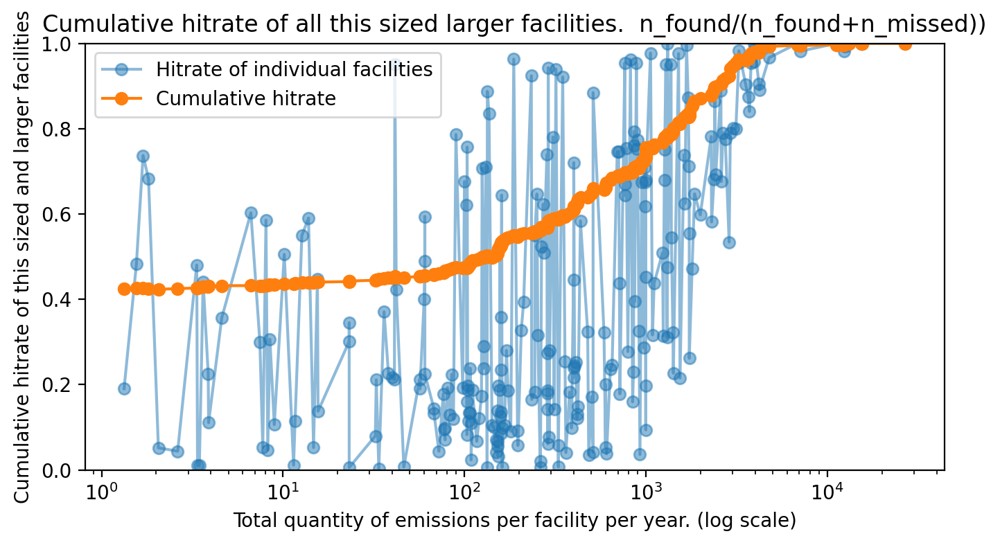

In [59]:
# Calculate hit rate as a function of NOX
NOX = df_sorted_noisefree['NOX'].values

cumulative_hit_rate = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_noisefree.iloc[0:i+1, 4].sum()
    cumulative_hit_rate[i]=n_found/(n_found+n_missed)
    
hit_rate = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[i, 3]
    n_missed = df_sorted_noisefree.iloc[i, 4]
    hit_rate[i]=n_found/(n_found+n_missed)
    
fig = plt.figure(figsize=(8, 4), dpi=200)

plt.semilogx(NOX, hit_rate, 'o-', label='Hitrate of individual facilities', alpha=0.5)
plt.xlabel('Total quantity of emissions per facility.(log scale))')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.semilogx(NOX, cumulative_hit_rate, 'o-', label='Cumulative hitrate')
plt.xlabel('Total quantity of emissions per facility per year. (log scale)')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.legend()
plt.show()

In [51]:
# Low noise
df_sorted_low_noise = TNO_MACC_III_point_sources_NOX[TNO_MACC_III_point_sources_NOX["Times found"]>0].sort_values(by="NOX", ascending=False)
df_sorted_low_noise

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files
cluster,,,,,,,
261,14.453045,51.832476,26877.181597,192,22,"3,67,75,108,136,151,156,157,159,170,223,232,26...","88,242,296,388,467,485,636,655,787,909,1109,11..."
153,13.257700,50.418910,15481.611184,202,27,"3,37,60,67,161,223,238,270,302,305,321,330,340...","14,106,181,610,612,621,652,692,749,868,910,133..."
199,14.575608,51.419055,15378.922090,204,18,"3,60,67,88,108,136,151,156,170,238,242,268,279...","446,630,655,1316,1328,1390,1459,1463,1535,1692..."
274,14.906528,50.940970,13108.379703,172,26,"67,75,88,108,156,196,219,242,268,270,279,283,3...","305,655,1047,1333,1390,1467,1548,1692,1752,186..."
230,13.679113,50.426573,12624.885310,213,17,"35,37,58,60,67,75,151,161,196,202,223,238,242,...","14,181,785,1001,1084,1164,1237,1299,1336,1569,..."
...,...,...,...,...,...,...,...
78,10.700000,52.830000,2.054980,1,215,"2686,","28,52,59,61,65,98,104,121,125,142,191,199,210,..."
55,10.250000,52.200000,1.813218,130,85,"52,68,98,121,191,199,240,246,276,316,336,377,4...","61,65,86,122,125,139,142,154,216,259,263,293,2..."
119,10.200000,52.350000,1.692337,145,69,"52,61,98,121,142,154,191,199,240,246,276,316,3...","65,86,91,125,216,259,293,355,380,402,416,422,5..."


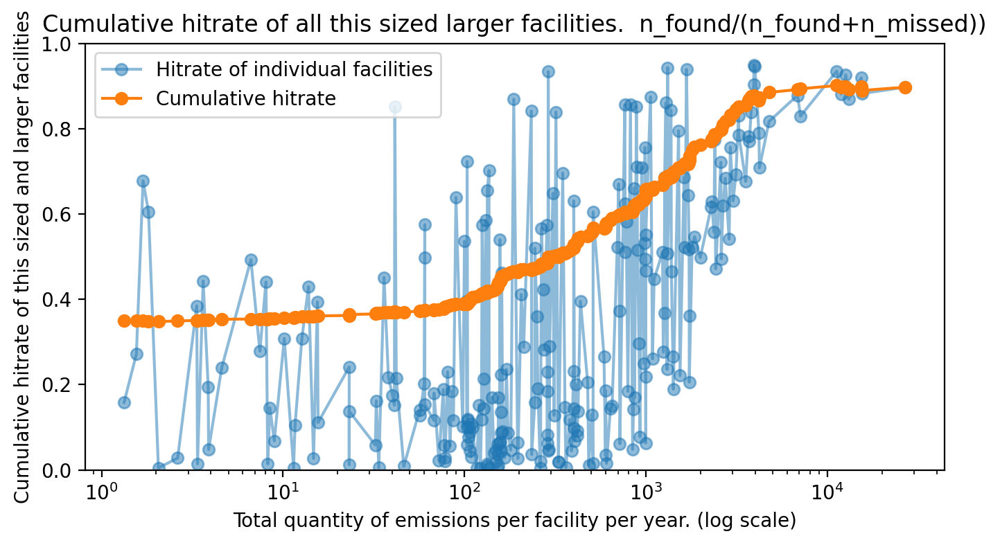

In [52]:
# Calculate hit rate as a function of NOX
NOX = df_sorted_low_noise['NOX'].values

cumulative_hit_rate = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_low_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate[i]=n_found/(n_found+n_missed)
    
hit_rate = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[i, 3]
    n_missed = df_sorted_low_noise.iloc[i, 4]
    hit_rate[i]=n_found/(n_found+n_missed)
    
fig = plt.figure(figsize=(8, 4), dpi=200)

plt.semilogx(NOX, hit_rate, 'o-', label='Hitrate of individual facilities', alpha=0.5)
plt.xlabel('Total quantity of emissions per facility.(log scale))')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.semilogx(NOX, cumulative_hit_rate, 'o-', label='Cumulative hitrate')
plt.xlabel('Total quantity of emissions per facility per year. (log scale)')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.legend()
plt.show()

In [403]:
# High noise
print("hi")

hi


In [55]:
# High noise
df_sorted_high_noise = TNO_MACC_III_point_sources_NOX_high_noise[TNO_MACC_III_point_sources_NOX_high_noise["Times found"]>0].sort_values(by="NOX", ascending=False)
df_sorted_high_noise

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files
cluster,,,,,,,
261,14.453045,51.832476,26877.181597,192,22,"3,67,75,108,136,151,156,157,159,170,223,232,26...","88,242,296,388,467,485,636,655,787,909,1109,11..."
153,13.257700,50.418910,15481.611184,198,31,"3,37,60,67,161,238,270,302,305,321,330,340,345...","14,106,181,223,612,621,652,692,749,868,910,987..."
199,14.575608,51.419055,15378.922090,202,20,"3,60,67,88,108,136,151,156,170,238,242,268,279...","446,630,655,1316,1328,1390,1459,1463,1535,1692..."
274,14.906528,50.940970,13108.379703,168,30,"67,88,108,156,196,219,242,268,270,279,283,302,...","75,305,655,1047,1333,1390,1467,1548,1692,1752,..."
230,13.679113,50.426573,12624.885310,206,24,"35,37,58,60,67,75,151,161,196,202,223,238,242,...","14,181,330,461,464,621,760,785,803,1084,1164,1..."
...,...,...,...,...,...,...,...
78,10.700000,52.830000,2.054980,1,215,"1593,","28,52,59,61,65,98,104,121,125,142,191,199,210,..."
55,10.250000,52.200000,1.813218,102,113,"52,68,98,121,199,240,246,276,377,415,554,587,6...","61,65,86,122,125,139,142,154,191,216,259,263,2..."
119,10.200000,52.350000,1.692337,107,107,"52,61,91,98,191,199,240,246,276,377,415,472,49...","65,86,121,125,142,154,216,259,293,316,335,336,..."


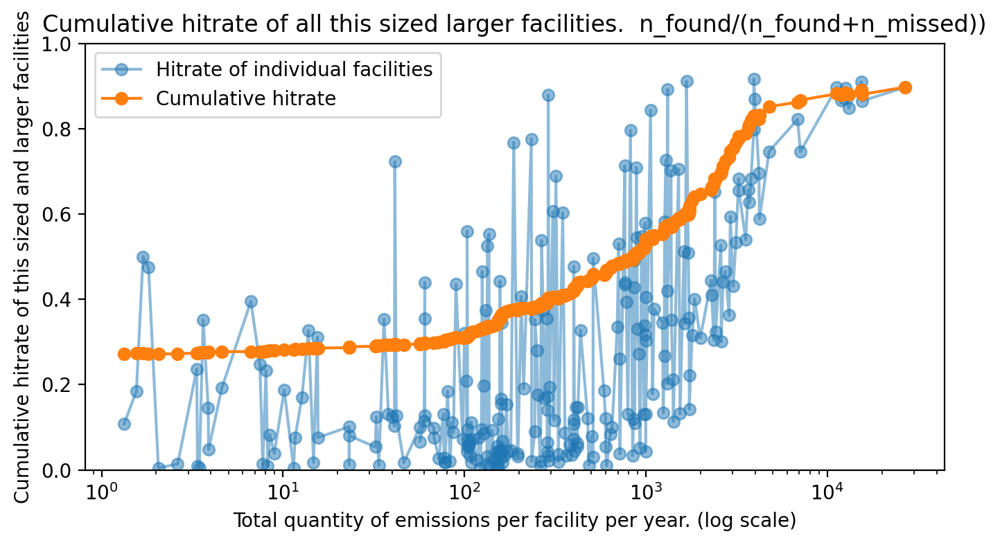

In [56]:
# Calculate hit rate as a function of NOX
NOX = df_sorted_high_noise['NOX'].values

cumulative_hit_rate = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_high_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate[i]=n_found/(n_found+n_missed)
    
hit_rate = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[i, 3]
    n_missed = df_sorted_high_noise.iloc[i, 4]
    hit_rate[i]=n_found/(n_found+n_missed)
    
fig = plt.figure(figsize=(8, 4), dpi=200)

plt.semilogx(NOX, hit_rate, 'o-', label='Hitrate of individual facilities', alpha=0.5)
plt.xlabel('Total quantity of emissions per facility.(log scale))')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.semilogx(NOX, cumulative_hit_rate, 'o-', label='Cumulative hitrate')
plt.xlabel('Total quantity of emissions per facility per year. (log scale)')
plt.ylabel('Cumulative hitrate of this sized and larger facilities')
plt.title('Cumulative hitrate of all this sized larger facilities.  n_found/(n_found+n_missed))')
plt.ylim(0,1)
#figure size
plt.rcParams["figure.figsize"] = (20,7)

plt.legend()
plt.show()

Better plots

In [101]:
df_sorted_noisefree

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files,Hit rate
cluster,,,,,,,,
261,14.453045,51.832476,26877.181597,683,0,"1,3,4,8,14,23,31,35,36,37,38,45,58,60,67,75,88...",,1.000000
153,13.257700,50.418910,15481.611184,651,0,"3,4,8,14,31,35,36,37,38,45,58,60,67,75,105,106...",,1.000000
199,14.575608,51.419055,15378.922090,683,0,"1,3,4,8,23,31,35,36,37,38,45,56,58,60,67,75,83...",,1.000000
274,14.906528,50.940970,13108.379703,651,0,"1,8,11,23,31,35,36,37,38,45,56,67,75,83,88,93,...",,1.000000
230,13.679113,50.426573,12624.885310,645,5,"1,3,4,8,14,31,35,36,37,38,45,58,60,67,75,93,10...","181,1029,1367,1448,2394,",0.992308
...,...,...,...,...,...,...,...,...
78,10.700000,52.830000,2.054980,37,679,"68,267,280,749,754,757,761,789,929,973,1183,12...","0,2,18,25,28,29,33,52,53,54,59,61,65,71,76,81,...",0.051676
55,10.250000,52.200000,1.813218,466,217,"0,2,18,25,28,33,52,59,61,68,71,76,81,86,95,98,...","10,29,34,42,53,54,65,92,117,122,131,142,145,15...",0.682284
119,10.200000,52.350000,1.692337,527,188,"0,10,18,25,33,52,54,59,61,76,81,86,95,98,100,1...","2,28,29,34,42,44,53,65,68,71,91,92,122,142,145...",0.737063


In [103]:
window = 100
[np.logical_and(df_sorted_noisefree["NOX"]<df_sorted_noisefree["NOX"][i]+window/2, df_sorted_noisefree["NOX"]>df_sorted_noisefree["NOX"][i]-window)]

[cluster
 261    False
 153    False
 199    False
 274    False
 230    False
        ...  
 78      True
 55      True
 119     True
 59      True
 68      True
 Name: NOX, Length: 254, dtype: bool]

In [120]:
# Calculate hit rate as a function of NOX

# Noise free
NOX_noisefree = df_sorted_noisefree['NOX'].values

cumulative_hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_noisefree.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_noisefree[i]=n_found/(n_found+n_missed)
    
hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[i, 3]
    n_missed = df_sorted_noisefree.iloc[i, 4]
    hit_rate_noisefree[i]=n_found/(n_found+n_missed)

# Moving average in terms of NOX
window = 500
moving_average_hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[:,3][np.logical_and(df_sorted_noisefree["NOX"]<df_sorted_noisefree["NOX"].iloc[i]+window/2, df_sorted_noisefree["NOX"]>df_sorted_noisefree["NOX"].iloc[i]-window/2)].sum()
    n_missed = df_sorted_noisefree.iloc[:,4][np.logical_and(df_sorted_noisefree["NOX"]<df_sorted_noisefree["NOX"].iloc[i]+window/2, df_sorted_noisefree["NOX"]>df_sorted_noisefree["NOX"].iloc[i]-window/2)].sum()
    moving_average_hit_rate_noisefree[i]=n_found/(n_found+n_missed)

# Low noise
NOX_low_noise = df_sorted_low_noise['NOX'].values

cumulative_hit_rate_low_noise = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_low_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_low_noise[i]=n_found/(n_found+n_missed)
    
hit_rate_low_noise = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[i, 3]
    n_missed = df_sorted_low_noise.iloc[i, 4]
    hit_rate_low_noise[i]=n_found/(n_found+n_missed)



# High noise
NOX_high_noise = df_sorted_high_noise['NOX'].values

cumulative_hit_rate_high_noise = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_high_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_high_noise[i]=n_found/(n_found+n_missed)
    
hit_rate_high_noise = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[i, 3]
    n_missed = df_sorted_high_noise.iloc[i, 4]
    hit_rate_high_noise[i]=n_found/(n_found+n_missed)

In [100]:
df_sorted_noisefree

,Lon,Lat,NOX,Times found,Times missed,Found in files,Missed in files,Hit rate
cluster,,,,,,,,
261,14.453045,51.832476,26877.181597,683,0,"1,3,4,8,14,23,31,35,36,37,38,45,58,60,67,75,88...",,1.000000
153,13.257700,50.418910,15481.611184,651,0,"3,4,8,14,31,35,36,37,38,45,58,60,67,75,105,106...",,1.000000
199,14.575608,51.419055,15378.922090,683,0,"1,3,4,8,23,31,35,36,37,38,45,56,58,60,67,75,83...",,1.000000
274,14.906528,50.940970,13108.379703,651,0,"1,8,11,23,31,35,36,37,38,45,56,67,75,83,88,93,...",,1.000000
230,13.679113,50.426573,12624.885310,645,5,"1,3,4,8,14,31,35,36,37,38,45,58,60,67,75,93,10...","181,1029,1367,1448,2394,",0.992308
...,...,...,...,...,...,...,...,...
78,10.700000,52.830000,2.054980,37,679,"68,267,280,749,754,757,761,789,929,973,1183,12...","0,2,18,25,28,29,33,52,53,54,59,61,65,71,76,81,...",0.051676
55,10.250000,52.200000,1.813218,466,217,"0,2,18,25,28,33,52,59,61,68,71,76,81,86,95,98,...","10,29,34,42,53,54,65,92,117,122,131,142,145,15...",0.682284
119,10.200000,52.350000,1.692337,527,188,"0,10,18,25,33,52,54,59,61,76,81,86,95,98,100,1...","2,28,29,34,42,44,53,65,68,71,91,92,122,142,145...",0.737063


In [406]:
print(cumulative_hit_rate_noisefree[-1])
print(cumulative_hit_rate_low_noise[-1])
print(cumulative_hit_rate_high_noise[-1])

0.42504937212475746
0.34920665860980077
0.2723367366596032


In [416]:
np.where(NOX_high_noise>1000)[0][-1]

61

In [415]:
print(cumulative_hit_rate_noisefree[61])
print(cumulative_hit_rate_low_noise[61])
print(cumulative_hit_rate_high_noise[61])

0.7575184821877168
0.6598883572567783
0.5476076555023923


In [417]:
np.where(NOX_high_noise>500)[0][-1]

99

In [418]:
print(cumulative_hit_rate_noisefree[99])
print(cumulative_hit_rate_low_noise[99])
print(cumulative_hit_rate_high_noise[99])

0.6479616660523406
0.5562713712275138
0.4493780663065563


In [424]:
print(np.where(cumulative_hit_rate_noisefree>0.7)[0][-1])
print(np.where(cumulative_hit_rate_low_noise>0.7)[0][-1])
print(np.where(cumulative_hit_rate_high_noise>0.7)[0][-1])


81
46
27


In [425]:
print(NOX_noisefree[81])
print(NOX_low_noise[46])
print(NOX_high_noise[27])

821.700206
1512.786412
2658.854465


In [426]:
print(np.where(cumulative_hit_rate_noisefree>0.5)[0][-1])
print(np.where(cumulative_hit_rate_low_noise>0.5)[0][-1])
print(np.where(cumulative_hit_rate_high_noise>0.5)[0][-1])


173
121
78


In [427]:
print(NOX_noisefree[173])
print(NOX_low_noise[121])
print(NOX_high_noise[78])

131.083797
306.86765
859.494898


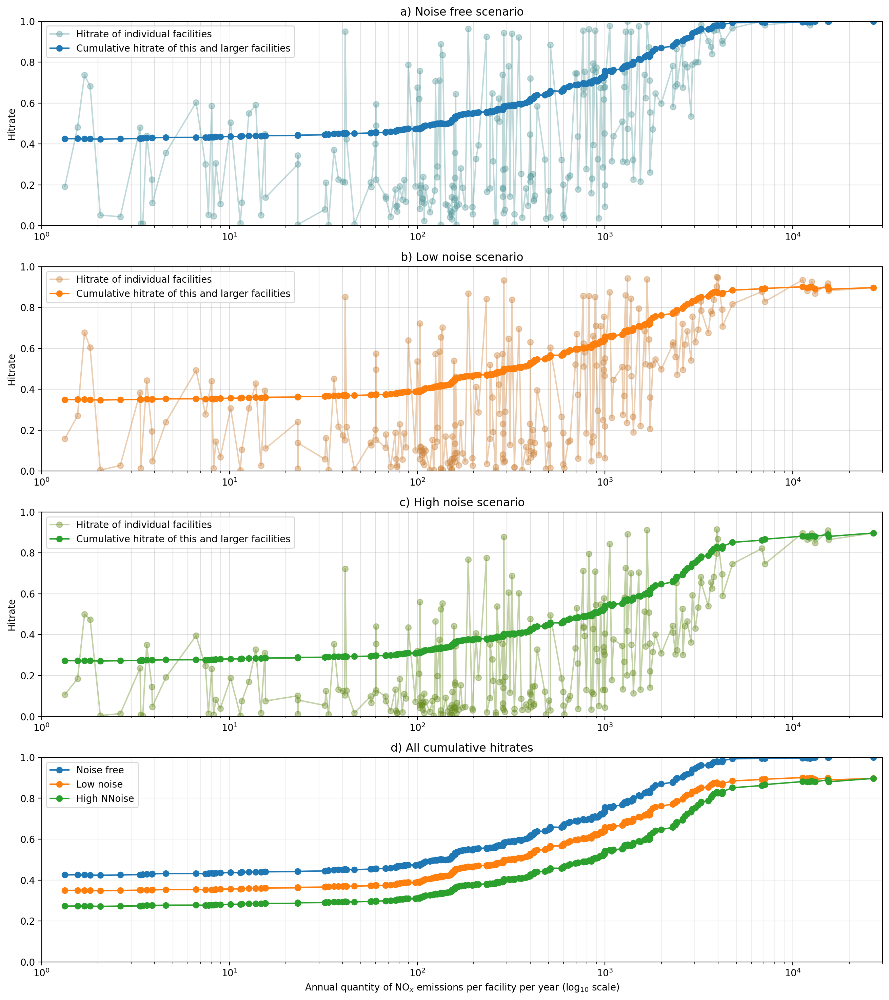

In [307]:

    
#fig = plt.figure(figsize=(8, 4), dpi=200)
fig, axs = plt.subplots(4, 1, figsize=(16, 18), dpi=200)

ax = axs[0]
ax.semilogx(NOX_noisefree, hit_rate_noisefree, 'o-', label='Hitrate of individual facilities', alpha=0.4, color='cadetblue')
ax.semilogx(NOX_noisefree, cumulative_hit_rate_noisefree, 'o-', label='Cumulative hitrate of this and larger facilities', color='tab:blue')
#ax.semilogx(NOX_noisefree, moving_average_hit_rate_noisefree, 'o-', label='Moving average hitrate of this-sized and larger facilities')
ax.set_ylabel('Hitrate')
ax.set_title('a) Noise free scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()


ax = axs[1]
ax.semilogx(NOX_low_noise, hit_rate_low_noise, 'o-', label='Hitrate of individual facilities', alpha=0.4 , color='peru')
ax.semilogx(NOX_low_noise, cumulative_hit_rate_low_noise, 'o-', label='Cumulative hitrate of this and larger facilities', color='tab:orange')
ax.set_ylabel('Hitrate')
ax.set_title('b) Low noise scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()


ax = axs[2]
ax.semilogx(NOX_high_noise, hit_rate_high_noise, 'o-', label='Hitrate of individual facilities', alpha=0.4, color='olivedrab')
ax.semilogx(NOX_high_noise, cumulative_hit_rate_high_noise, 'o-', label='Cumulative hitrate of this and larger facilities', color='tab:green')
ax.set_ylabel('Hitrate')
ax.set_title('c) High noise scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()



ax = axs[3]
ax.semilogx(NOX_noisefree, cumulative_hit_rate_noisefree, 'o-', label='Noise free')
ax.semilogx(NOX_low_noise, cumulative_hit_rate_low_noise, 'o-', label='Low noise')
ax.semilogx(NOX_high_noise, cumulative_hit_rate_high_noise, 'o-', label='High NNoise')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.2)
ax.set_title('d) All cumulative hitrates')
ax.legend()


ax.set_xlabel('Annual quantity of NO$_x$ emissions per facility per year (log$_{10}$ scale)')


plt.show()

In [159]:
# Calculate hit rate as a function of NOX

# Noise free
NOX_noisefree = df_sorted_noisefree['NOX'].values

cumulative_hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_noisefree.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_noisefree[i]=n_found/(n_found+n_missed)
    
hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[i, 3]
    n_missed = df_sorted_noisefree.iloc[i, 4]
    hit_rate_noisefree[i]=n_found/(n_found+n_missed)

# Moving average in terms of NOX
window = 500
moving_average_hit_rate_noisefree = np.zeros(len(df_sorted_noisefree))
for i in range(len(df_sorted_noisefree)):
    n_found = df_sorted_noisefree.iloc[:,3][np.logical_and(df_sorted_noisefree["NOX"]<df_sorted_noisefree["NOX"].iloc[i]+window/2, df_sorted_noisefree["NOX"]>df_sorted_noisefree["NOX"].iloc[i]-window/2)].sum()
    n_missed = df_sorted_noisefree.iloc[:,4][np.logical_and(df_sorted_noisefree["NOX"]<df_sorted_noisefree["NOX"].iloc[i]+window/2, df_sorted_noisefree["NOX"]>df_sorted_noisefree["NOX"].iloc[i]-window/2)].sum()
    moving_average_hit_rate_noisefree[i]=n_found/(n_found+n_missed)

# Low noise
NOX_low_noise = df_sorted_low_noise['NOX'].values

cumulative_hit_rate_low_noise = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_low_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_low_noise[i]=n_found/(n_found+n_missed)
    
hit_rate_low_noise = np.zeros(len(df_sorted_low_noise))
for i in range(len(df_sorted_low_noise)):
    n_found = df_sorted_low_noise.iloc[i, 3]
    n_missed = df_sorted_low_noise.iloc[i, 4]
    hit_rate_low_noise[i]=n_found/(n_found+n_missed)



# High noise
NOX_high_noise = df_sorted_high_noise['NOX'].values

cumulative_hit_rate_high_noise = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[0:i+1, 3].sum()
    n_missed = df_sorted_high_noise.iloc[0:i+1, 4].sum()
    cumulative_hit_rate_high_noise[i]=n_found/(n_found+n_missed)
    
hit_rate_high_noise = np.zeros(len(df_sorted_high_noise))
for i in range(len(df_sorted_high_noise)):
    n_found = df_sorted_high_noise.iloc[i, 3]
    n_missed = df_sorted_high_noise.iloc[i, 4]
    hit_rate_high_noise[i]=n_found/(n_found+n_missed)

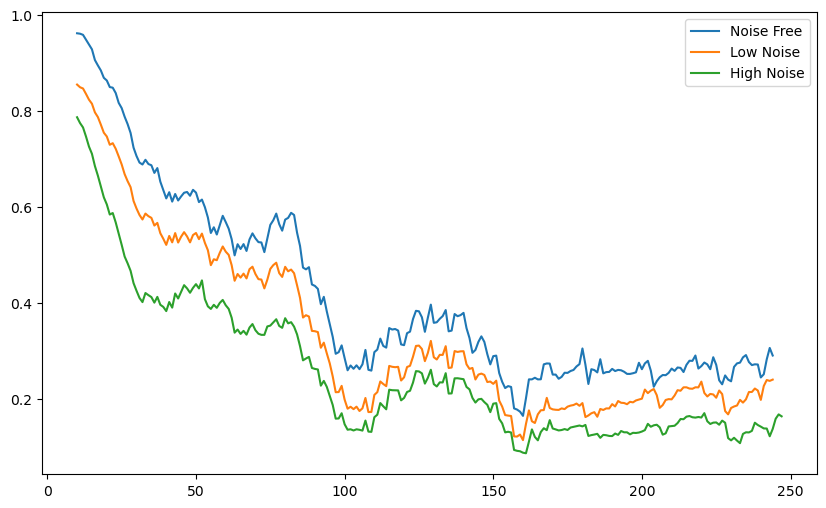

In [173]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert hit rate arrays to pandas Series
hit_rate_noisefree_series = pd.Series(hit_rate_noisefree)
hit_rate_low_noise_series = pd.Series(hit_rate_low_noise)
hit_rate_high_noise_series = pd.Series(hit_rate_high_noise)

# Calculate moving averages
window_size = 20  # specify your window size here
moving_avg_noisefree = hit_rate_noisefree_series.rolling(window_size, center=True).mean()
moving_avg_low_noise = hit_rate_low_noise_series.rolling(window_size, center=True).mean()
moving_avg_high_noise = hit_rate_high_noise_series.rolling(window_size, center=True).mean()

# Plot moving averages
plt.figure(figsize=(10, 6))
plt.plot(moving_avg_noisefree, label='Noise Free')
plt.plot(moving_avg_low_noise, label='Low Noise')
plt.plot(moving_avg_high_noise, label='High Noise')
plt.legend()
plt.show()

0           NaN
1           NaN
2           NaN
3           NaN
4           NaN
         ...   
249    0.245461
250    0.252131
251    0.283294
252    0.306849
253    0.291117
Length: 254, dtype: float64

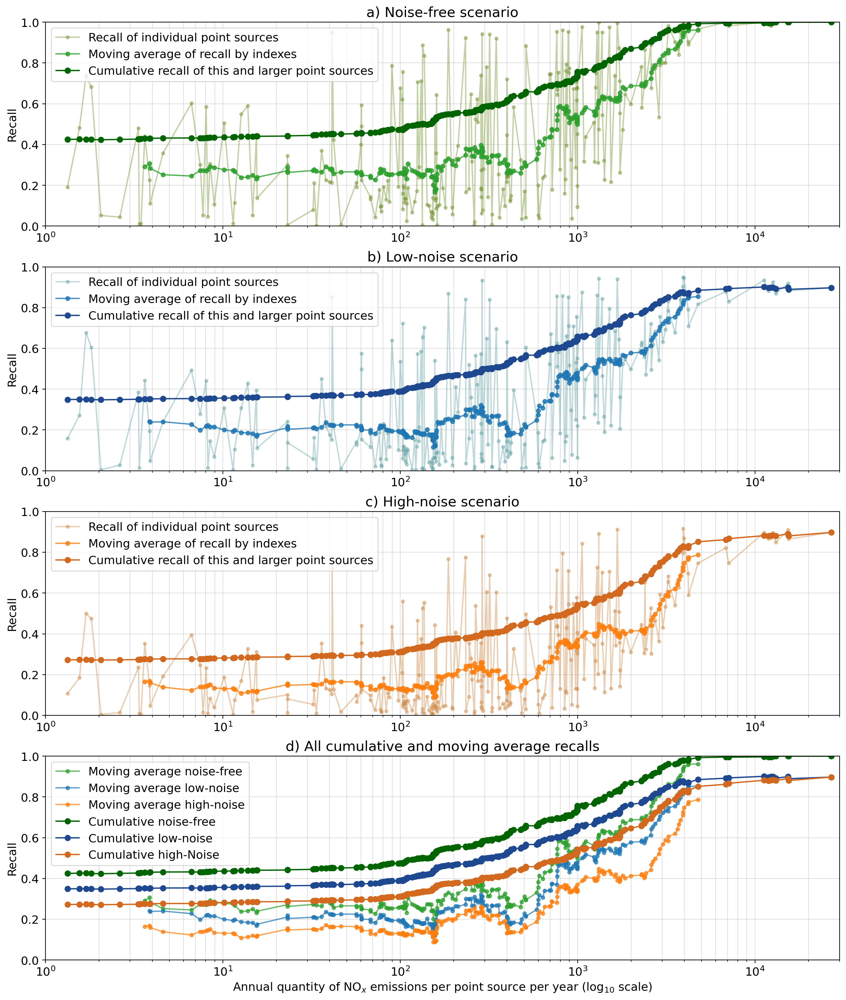

In [322]:

    
#fig = plt.figure(figsize=(8, 4), dpi=200)
fig, axs = plt.subplots(4, 1, figsize=(16, 19), dpi=200)

# Set a font size
plt.rcParams.update({'font.size': 13})

ax = axs[0]
ax.semilogx(NOX_noisefree, hit_rate_noisefree, 'o-', label='Recall of individual point sources', alpha=0.4, color='olivedrab', markersize=3.5)
ax.semilogx(NOX_noisefree, moving_avg_noisefree, 'o-', label='Moving average of recall by indexes',alpha=0.8, color='tab:green', markersize=4.5)
ax.semilogx(NOX_noisefree, cumulative_hit_rate_noisefree, 'o-', label='Cumulative recall of this and larger point sources', color='darkgreen')
ax.set_ylabel('Recall')
ax.set_title('a) Noise-free scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()


ax = axs[1]
ax.semilogx(NOX_low_noise, hit_rate_low_noise, 'o-', label='Recall of individual point sources', alpha=0.4 , color='cadetblue', markersize=3.5)
ax.semilogx(NOX_low_noise, moving_avg_low_noise, 'o-', label='Moving average of recall by indexes', alpha=0.8,color='tab:blue', markersize=4.5)
ax.semilogx(NOX_low_noise, cumulative_hit_rate_low_noise, 'o-', label='Cumulative recall of this and larger point sources', color = 'xkcd:cobalt')

ax.set_ylabel('Recall')
ax.set_title('b) Low-noise scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()


ax = axs[2]
ax.semilogx(NOX_high_noise, hit_rate_high_noise, 'o-', label='Recall of individual point sources', alpha=0.4, color='peru', markersize=3.5)
ax.semilogx(NOX_high_noise, moving_avg_high_noise, 'o-', label='Moving average of recall by indexes',alpha=0.8, color='tab:orange', markersize=4.5)
ax.semilogx(NOX_high_noise, cumulative_hit_rate_high_noise, 'o-', label='Cumulative recall of this and larger point sources', color = 'chocolate')

ax.set_ylabel('Recall')
ax.set_title('c) High-noise scenario')
ax.set_ylim(0,1)
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.legend()



ax = axs[3]

ax.semilogx(NOX_noisefree, moving_avg_noisefree, 'o-', label='Moving average noise-free',alpha=0.7, color='tab:green', markersize=4)
ax.semilogx(NOX_low_noise, moving_avg_low_noise, 'o-', label='Moving average low-noise', alpha=0.7,color='tab:blue', markersize=4)
ax.semilogx(NOX_high_noise, moving_avg_high_noise, 'o-', label='Moving average high-noise',alpha=0.7, color='tab:orange', markersize=4)
ax.semilogx(NOX_noisefree, cumulative_hit_rate_noisefree, 'o-', label='Cumulative noise-free', color='darkgreen')
ax.semilogx(NOX_low_noise, cumulative_hit_rate_low_noise, 'o-', label='Cumulative low-noise', color = 'xkcd:cobalt')
ax.semilogx(NOX_high_noise, cumulative_hit_rate_high_noise, 'o-', label='Cumulative high-Noise', color = 'chocolate')
ax.set_ylim(0,1)
ax.set_ylabel('Recall')
ax.set_xlim(1,3e4)
ax.grid(True, which="both", ls="-", alpha=0.4)
ax.set_title('d) All cumulative and moving average recalls')
ax.legend()


ax.set_xlabel('Annual quantity of NO$_x$ emissions per point source per year (log$_{10}$ scale)')


plt.show()

In [216]:
ranges

array([   0.,  500., 1000., 1500., 2000., 2500., 3000., 3500., 4000.,
       4500., 5000.])

In [414]:
TNO_MACC_III

,Lon,Lat,ISO3,Year,SNAP,SourceType,CH4,CO,NH3,NMVOC,NOX,PM10,PM2_5,SO2
0,-29.9375,36.40625,ATL,2011,8,A,0.000000,0.063392,0.000000,0.018761,0.634203,0.048957,0.046509,0.417624
1,-29.9375,36.59375,ATL,2011,8,A,0.000000,0.306779,0.000000,0.090795,3.069150,0.236925,0.225079,2.021039
2,-29.9375,36.71875,ATL,2011,8,A,0.000000,0.720972,0.000000,0.213381,7.212906,0.556805,0.528965,4.749709
3,-29.9375,36.90625,ATL,2011,8,A,0.000000,0.942698,0.000000,0.279004,9.431144,0.728043,0.691641,6.210421
4,-29.9375,37.28125,ATL,2011,8,A,0.000000,1.368561,0.000000,0.405044,13.691649,1.056936,1.004089,9.015970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2153556,59.9375,68.71875,RUS,2011,8,A,0.000077,0.092780,0.000089,0.013108,0.039964,0.004249,0.003921,0.002002
2153557,59.9375,68.71875,RUS,2011,34,A,0.012773,0.017403,0.000029,0.000600,0.019378,0.005825,0.002151,0.031185
2153558,59.9375,68.71875,RUS,2011,72,A,0.001028,0.045246,0.000025,0.003632,0.046640,0.002300,0.002294,0.001133
2153559,59.9375,69.65625,RUS,2011,71,A,0.010413,1.144412,0.003486,0.140172,0.076558,0.001305,0.001254,0.000639


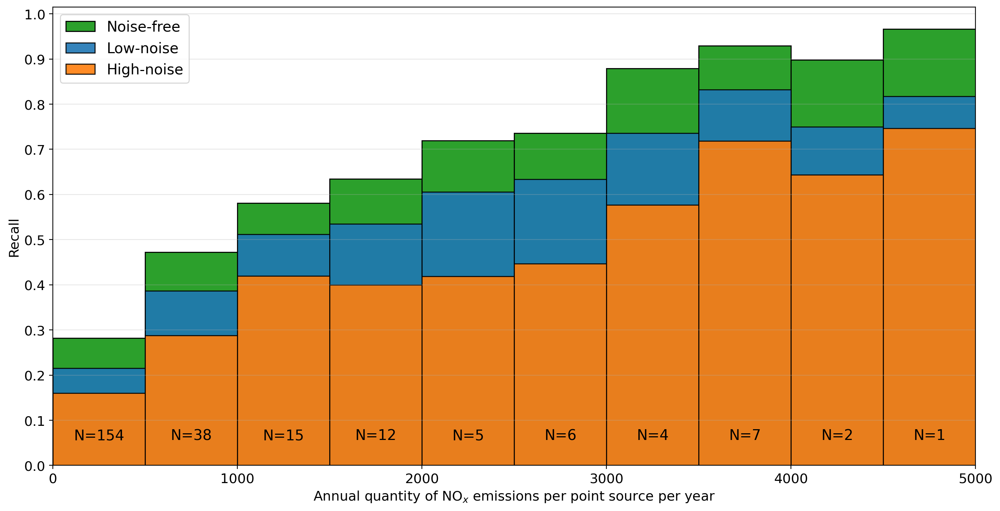

In [332]:
# Average hitrate in certain sized facilities

ranges = np.linspace(0, 5000, 11)
hit_rate_per_range = np.zeros(len(ranges)-1)

fig, ax = plt.subplots(figsize=(16, 8), dpi=200)    

plt.rcParams.update({'font.size': 14})


# Set x-axis to start from 0
ax.set_xlim(0, 5000)

for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted_noisefree[(df_sorted_noisefree["NOX"].values > ranges[i]) & (df_sorted_noisefree["NOX"].values < ranges[i+1])]
    hit_rate_per_range[i] = in_ranges["Times found"].sum()/(in_ranges["Times found"].sum() + in_ranges["Times missed"].sum())
    #print('Hit rate:', hit_rate_per_range[i])
    
#plot in histogram
ax.bar(ranges[1:]-250, hit_rate_per_range, width=5000/10, edgecolor='black', capsize=7, label='Noise-free', color='tab:green')
    
for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted_low_noise[(df_sorted_low_noise["NOX"].values > ranges[i]) & (df_sorted_low_noise["NOX"].values < ranges[i+1])]
    hit_rate_per_range[i] = in_ranges["Times found"].sum()/(in_ranges["Times found"].sum() + in_ranges["Times missed"].sum())
    #print('Hit rate:', hit_rate_per_range[i])
    
#plot in histogram
ax.bar(ranges[1:]-250, hit_rate_per_range, width=5000/10, edgecolor='black', capsize=7, label='Low-noise', color='tab:blue', alpha=0.9)

for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted_high_noise[(df_sorted_high_noise["NOX"].values > ranges[i]) & (df_sorted_high_noise["NOX"].values < ranges[i+1])]
    hit_rate_per_range[i] = in_ranges["Times found"].sum()/(in_ranges["Times found"].sum() + in_ranges["Times missed"].sum())
    #print('Hit rate:', hit_rate_per_range[i])
    
#plot in histogram
ax.bar(ranges[1:]-250, hit_rate_per_range, width=5000/10, edgecolor='black', capsize=7, label='High-noise', color='tab:orange', alpha=0.9)

# Plot the number of facilities in each range as text above the bars
for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted_noisefree[(df_sorted_noisefree["NOX"].values > ranges[i]) & (df_sorted_noisefree["NOX"].values < ranges[i+1])]
    #print('Number of facilities:', len(in_ranges))
    ax.text(ranges[i]+250, 0.05, "N="+str(len(in_ranges)), ha='center', va='bottom')


# Horizontal grid lines
ax.grid(axis='y', alpha=0.3)

# Ticks every 0.1
ax.set_yticks(np.arange(0, 1.1, 0.1))

# Add labels
ax.set_xlabel('Annual quantity of NO$_x$ emissions per point source per year', )
ax.set_ylabel('Recall', )
ax.legend()

plt.show()

In [286]:
# Noises effect
print(cumulative_hit_rate_noisefree[-1])
print(cumulative_hit_rate_low_noise[-1])
print(cumulative_hit_rate_high_noise[-1])

print()
print(cumulative_hit_rate_noisefree[-1]-cumulative_hit_rate_low_noise[-1])
print(cumulative_hit_rate_noisefree[-1]-cumulative_hit_rate_high_noise[-1])


0.42504937212475746
0.34920665860980077
0.2723367366596032

0.0758427135149567
0.1527126354651543


In [296]:
# Number of facilitie occurances in the data
print("Number of facilities in the data")
print(f"Noise free:", df_sorted_noisefree["Times found"].sum() + df_sorted_noisefree["Times missed"].sum())
print(f"Low noise:", df_sorted_low_noise["Times found"].sum() + df_sorted_low_noise["Times missed"].sum())
print(f"High noise:", df_sorted_high_noise["Times found"].sum() + df_sorted_high_noise["Times missed"].sum())


Number of facilities in the data
Noise free: 173681
Low noise: 51302
High noise: 51910


In [621]:
# Plot an example with new sources

def plot_small_facilities(i):
        # Get the SMARTCARB data from files and save the data to lon, lat and no2
    filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
    data = ddeq.smartcarb.read_level2(
        filename,
        co2_noise_scenario=None,
        no2_noise_scenario='low',
        co_noise_scenario=None,
        only_observations=True,
    )
    lon_m = np.array(data["lon"])
    lat_m = np.array(data["lat"])
    no2_m = np.array(data["NO2"])
    
    # Remove points outside domain
    domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]
    area_boolean = np.logical_and(np.logical_and(lon_m>=domain_extent[0], lon_m<=domain_extent[1]), np.logical_and(lat_m>=domain_extent[2], lat_m<=domain_extent[3]))
    no2_m[~area_boolean] = np.nan
    
    lon = lon_m.flatten()
    lat = lat_m.flatten()
    no2 = no2_m.flatten()
    
    #nan_indices = np.where(np.isnan(no2))
    not_nan = np.logical_not(np.isnan(no2))
    
    lon_notNaN = lon[not_nan]
    lat_notNaN = lat[not_nan]
    no2_notNaN = no2[not_nan]
    lon_NaN = lon[~not_nan]
    lat_NaN = lat[~not_nan]
    lon = lon_notNaN
    lat = lat_notNaN
    no2 = no2_notNaN
    
    clusters = clt.density_based_clustering_with_varying_radius(
        np.transpose([lon, lat]),
        no2,
        radius_func="default",
        n_clusters="auto",
        point_value_threshold="stds_from_median",
        stds=3.3,
        distance_matrix="euclidean",
        radius_func_sigmas_threshold=1.3,
        max_points_in_start_radius=5,
        local_box_size=3,
        verbose=True,
    )

    fig, axs = plt.subplots(1,2, figsize=(10,5), subplot_kw={'projection': ccrs.PlateCarree()}, dpi=200)


    extent = [np.min(lon)-0.5, np.max(lon)+0.5, np.min(lat)-0.5, np.max(lat)+0.5]

    ax = axs[0]
    ax.set_extent(extent)
    pcm = ax.scatter(lon, lat, c=no2, vmin=0, vmax=1.7e16, s=0.2, alpha=0.9, transform=ccrs.Geodetic())
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.coastlines()


    ax.set_title(f"Amount of sources: {len(TNO_MACC_III_point_sources_NOX)}.")


    # PLOT NEW SOURCES
    ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c='red', path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=1)], s=2, alpha=0.8)


    # Plot sources
    for j in range(len(sources['source'])):
        ax.scatter(sources['lon_o'][j], sources['lat_o'][j], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=0.5)], s=1, alpha=0.8)
        ax.text(sources['lon_o'][j], sources['lat_o'][j]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)


    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}



    ax = axs[1]
    ax.set_extent(extent)
    pcm = ax.scatter(lon, lat, c=no2, vmin=0, vmax=1.7e16, s=0.2, alpha=0.15, transform=ccrs.Geodetic())
    ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
    ax.coastlines()
    #fig.colorbar(pcm, ax=ax)

    # Plot clusters
    if len(clusters)!=0 and int(np.max(clusters))!=0:
        for j in range(1,int(np.max(clusters))+1):
            ax.scatter(lon[clusters == j], lat[clusters == j], s=1)
    else:
        print("no clusters")
        
        
    # Plot clusters
    if len(clusters)!=0 and int(np.max(clusters))!=0:
        for j in range(1,int(np.max(clusters))+1):
            if number_of_facilities_in_plumes_per_file[i][j-1] == 0:
                ax.scatter(lon[clusters == j], lat[clusters == j], s=1, c='green')
            if number_of_facilities_in_plumes_per_file[i][j-1] == -1:
                ax.scatter(lon[clusters == j], lat[clusters == j], s=1, c='red')
        
        
        
    # PLOT NEW SOURCES
    ax.scatter(TNO_MACC_III_point_sources_NOX['Lon'], TNO_MACC_III_point_sources_NOX['Lat'], c='red', path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=1)], s=2, alpha=0.8)

    """
    # Plot sources
    for i in range(len(sources['source'])):
        ax.scatter(sources['lon_o'][i], sources['lat_o'][i], c='black', path_effects=[pe.withStroke(linewidth=1, foreground="black", alpha=0.5)], s=1, alpha=0.8)
        ax.text(sources['lon_o'][i], sources['lat_o'][i]+0.08, sources['source'][i].data, c='black', size=3, alpha=0.6, path_effects=[pe.withStroke(linewidth=1, foreground="white")]).set_clip_on(True)
"""

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                    linewidth=0.5, color='gray', alpha=0.2, linestyle='--')
    gl.xlabel_style = {'size': 7, 'color': 'gray'}
    gl.ylabel_style = {'size': 7, 'color': 'gray'}

    fig.suptitle("Only small-sized and above new sources")
    plt.show()
    
plot_small_facilities(71)

UnboundLocalError: local variable 'radius_of_closest_point_not_in_cluster' referenced before assignment

### By plume

In [278]:
is_plume_next_to_nans_per_file_low_noise = np.load("is_plume_next_to_nans_per_file_low_noise.npy", allow_pickle=True)
is_plume_next_to_nans_per_file_high_noise = np.load("is_plume_next_to_nans_per_file_high_noise.npy", allow_pickle=True)

In [302]:
# Flatten a jagged array
number_of_facilities_in_plumes_low_noise = np.array([item for sublist in number_of_facilities_in_plumes_per_file_low_noise for item in sublist])
number_of_facilities_in_plumes_high_noise = np.array([item for sublist in number_of_facilities_in_plumes_per_file_high_noise for item in sublist])
number_of_facilities_in_plumes_noisefree = np.array([item for sublist in number_of_facilities_in_plumes_per_file_noisefree for item in sublist])

is_plumes_next_to_nans_low_noise = np.array([item for sublist in is_plume_next_to_nans_per_file_low_noise for item in sublist])
is_plumes_next_to_nans_high_noise = np.array([item for sublist in is_plume_next_to_nans_per_file_high_noise for item in sublist])
is_plumes_next_to_nans_noisefree = np.array([item for sublist in is_plume_next_to_nans_per_file_noisefree for item in sublist])

In [265]:
true_positive_noisefree = np.sum(number_of_facilities_in_plumes_noisefree>0)
false_positive_noisefree = np.sum(number_of_facilities_in_plumes_noisefree==0)

print(f"True positive: {true_positive_noisefree}")
print(f"False positive: {false_positive_noisefree}")
print(f"Recall: {true_positive_noisefree/(true_positive_noisefree+false_positive_noisefree)}")

#print(f"Dismissed: {dismissed_noisefree}")

True positive: 22413
False positive: 308
Recall: 0.9864442586153779


In [273]:
print("Low noise:\n")

true_positive_low_noise = np.sum(number_of_facilities_in_plumes_low_noise>0)
false_positive_low_noise = np.sum(number_of_facilities_in_plumes_low_noise==0)
print("All plumes:")
print(f"Number of plumes: {len(number_of_facilities_in_plumes_low_noise)}")
print(f"True positive: {true_positive_low_noise}")
print(f"False positive: {false_positive_low_noise}")
print(f"Recall: {true_positive_low_noise/(true_positive_low_noise+false_positive_low_noise)}")

true_positive_without_nans_low_noise = np.sum(number_of_facilities_in_plumes_low_noise[~is_plumes_next_to_nans_low_noise]>0)
false_positive_without_nans_low_noise = np.sum(number_of_facilities_in_plumes_low_noise[~is_plumes_next_to_nans_low_noise]==0)
print("\nOnly plumes without nans:")
print(f"Number of plumes with nans: {np.sum(is_plumes_next_to_nans_low_noise)}")
print(f"Percentage of all plumes: {np.sum(is_plumes_next_to_nans_low_noise)/len(number_of_facilities_in_plumes_low_noise)}")
print(f"Number of plumes without nans: {len(number_of_facilities_in_plumes_low_noise[~is_plumes_next_to_nans_low_noise])}")
print(f"True positive: {true_positive_without_nans_low_noise}")
print(f"False positive: {false_positive_without_nans_low_noise}")
print(f"Recall: {true_positive_without_nans_low_noise/(true_positive_without_nans_low_noise+false_positive_without_nans_low_noise)}")

print("\nOnly missed points without nans:")
print(f"True positive: {true_positive_low_noise}")
print(f"False positive: {false_positive_without_nans_low_noise}")
print(f"Recall: {true_positive_low_noise/(true_positive_low_noise+false_positive_without_nans_low_noise)}")


Low noise:

All plumes:
Number of plumes: 12573
True positive: 8016
False positive: 4557
Recall: 0.637556669052732

Only plumes without nans:
Number of plumes with nans: 11065
Percentage of all plumes: 0.8800604469895809
Number of plumes without nans: 1508
True positive: 1332
False positive: 176
Recall: 0.883289124668435

Only missed points without nans:
True positive: 8016
False positive: 176
Recall: 0.978515625


In [280]:
print("High noise:\n")

true_positive_high_noise = np.sum(number_of_facilities_in_plumes_high_noise>0)
false_positive_high_noise = np.sum(number_of_facilities_in_plumes_high_noise==0)
print("All plumes:")
print(f"Number of plumes: {len(number_of_facilities_in_plumes_high_noise)}")
print(f"True positive: {true_positive_high_noise}")
print(f"False positive: {false_positive_high_noise}")
print(f"Recall: {true_positive_high_noise/(true_positive_high_noise+false_positive_high_noise)}")

true_positive_without_nans_high_noise = np.sum(number_of_facilities_in_plumes_high_noise[~is_plumes_next_to_nans_high_noise]>0)
false_positive_without_nans_high_noise = np.sum(number_of_facilities_in_plumes_high_noise[~is_plumes_next_to_nans_high_noise]==0)
print("\nOnly plumes without nans:")
print(f"Number of plumes with nans: {np.sum(is_plumes_next_to_nans_high_noise)}")
print(f"Percentage of all plumes: {np.sum(is_plumes_next_to_nans_high_noise)/len(number_of_facilities_in_plumes_high_noise)}")
print(f"Number of plumes without nans: {len(number_of_facilities_in_plumes_high_noise[~is_plumes_next_to_nans_high_noise])}")
print(f"True positive: {true_positive_without_nans_high_noise}")
print(f"False positive: {false_positive_without_nans_high_noise}")
print(f"Recall: {true_positive_without_nans_high_noise/(true_positive_without_nans_high_noise+false_positive_without_nans_high_noise)}")

print("\nOnly missed points without nans:")
print(f"True positive: {true_positive_high_noise}")
print(f"False positive: {false_positive_without_nans_high_noise}")
print(f"Recall: {true_positive_high_noise/(true_positive_high_noise+false_positive_without_nans_high_noise)}")


High noise:

All plumes:
Number of plumes: 15262
True positive: 7199
False positive: 8063
Recall: 0.4716944044030926

Only plumes without nans:
Number of plumes with nans: 12950
Percentage of all plumes: 0.8485126457869218
Number of plumes without nans: 2312
True positive: 1529
False positive: 783
Recall: 0.6613321799307958

Only missed points without nans:
True positive: 7199
False positive: 783
Recall: 0.901904284640441


In [303]:
print("Noise free:\n")

true_positive_noisefree = np.sum(number_of_facilities_in_plumes_noisefree>0)
false_positive_noisefree = np.sum(number_of_facilities_in_plumes_noisefree==0)
print("All plumes:")
print(f"Number of plumes: {len(number_of_facilities_in_plumes_noisefree)}")
print(f"True positive: {true_positive_noisefree}")
print(f"False positive: {false_positive_noisefree}")
print(f"Recall: {true_positive_noisefree/(true_positive_noisefree+false_positive_noisefree)}")

true_positive_without_nans_noisefree = np.sum(number_of_facilities_in_plumes_noisefree[~is_plumes_next_to_nans_noisefree]>0)
false_positive_without_nans_noisefree = np.sum(number_of_facilities_in_plumes_noisefree[~is_plumes_next_to_nans_noisefree]==0)
print("\nOnly plumes without nans:")
print(f"Number of plumes with nans: {np.sum(is_plumes_next_to_nans_noisefree)}")
print(f"Percentage of all plumes: {np.sum(is_plumes_next_to_nans_noisefree)/len(number_of_facilities_in_plumes_noisefree)}")
print(f"Number of plumes without nans: {len(number_of_facilities_in_plumes_noisefree[~is_plumes_next_to_nans_noisefree])}")
print(f"True positive: {true_positive_without_nans_noisefree}")
print(f"False positive: {false_positive_without_nans_noisefree}")
print(f"Recall: {true_positive_without_nans_noisefree/(true_positive_without_nans_noisefree+false_positive_without_nans_noisefree)}")

print("\nOnly missed points without nans:")
print(f"True positive: {true_positive_noisefree}")
print(f"False positive: {false_positive_without_nans_noisefree}")
print(f"Recall: {true_positive_noisefree/(true_positive_noisefree+false_positive_without_nans_noisefree)}")


Noise free:

All plumes:
Number of plumes: 23798
True positive: 22413
False positive: 1385
Recall: 0.94180183208673

Only plumes without nans:
Number of plumes with nans: 11896
Percentage of all plumes: 0.4998739389864694
Number of plumes without nans: 11902
True positive: 11594
False positive: 308
Recall: 0.9741219963031423

Only missed points without nans:
True positive: 22413
False positive: 308
Recall: 0.9864442586153779


# Some plots for thesis

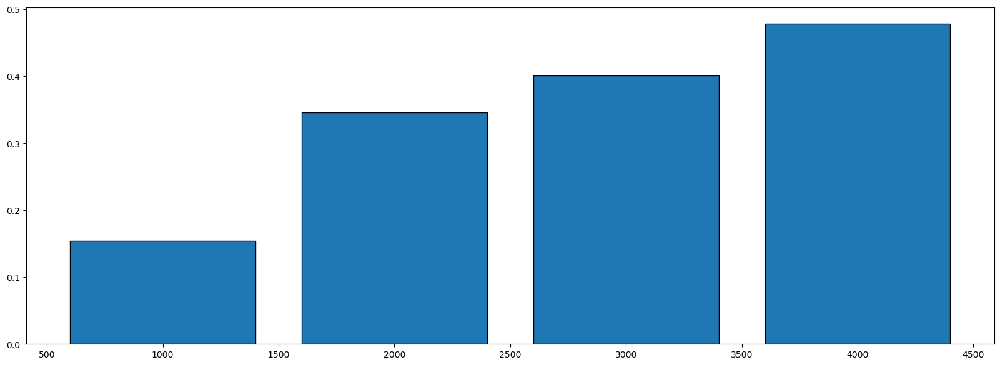

In [39]:
# Average hitrate in certain sized facilities

ranges = [0, 1000, 2000, 3000, 4000]
hit_rate_per_range = np.zeros(len(ranges)-1)

for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted[(df_sorted["NOX"].values > ranges[i]) & (df_sorted["NOX"].values < ranges[i+1])]
    hit_rate_per_range[i] = in_ranges["Times found"].sum()/(in_ranges["Times found"].sum() + in_ranges["Times missed"].sum())
    #print('Hit rate:', hit_rate_per_range[i])
    
    
# plot in histogram
plt.bar(ranges[1:], hit_rate_per_range, width=800, edgecolor='black', capsize=7, label='Hit rate')
plt.show()

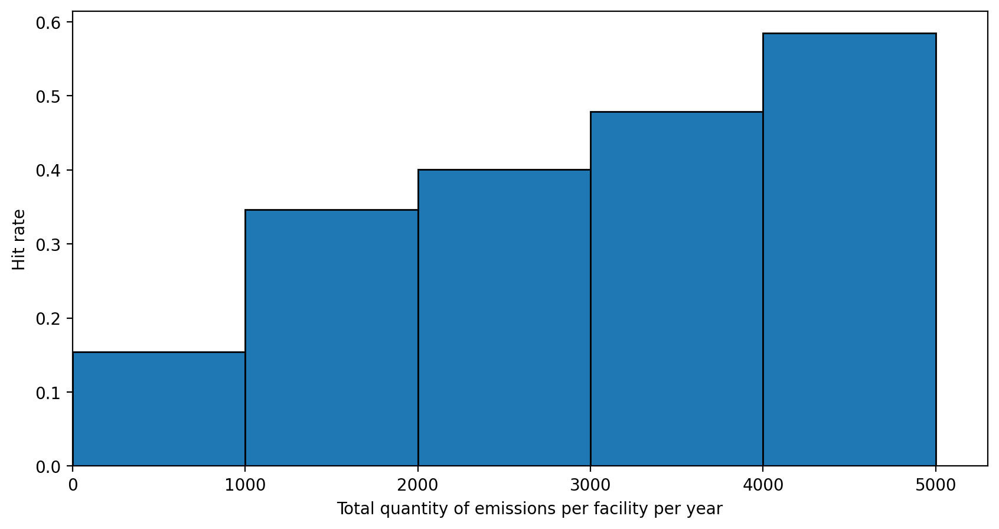

In [57]:
# Average hitrate in certain sized facilities

ranges = np.linspace(0, 5000, 6)
hit_rate_per_range = np.zeros(len(ranges)-1)

for i in range(len(ranges)-1):
    #print('Facilities with emissions between', ranges[i], 'and', ranges[i+1])
    in_ranges = df_sorted[(df_sorted["NOX"].values > ranges[i]) & (df_sorted["NOX"].values < ranges[i+1])]
    hit_rate_per_range[i] = in_ranges["Times found"].sum()/(in_ranges["Times found"].sum() + in_ranges["Times missed"].sum())
    #print('Hit rate:', hit_rate_per_range[i])
    

fig, ax = plt.subplots(figsize=(10, 5), dpi=200)    
    
# Set x-axis to start from 0
ax.set_xlim(0, 5300)

#plot in histogram
ax.bar(ranges[1:]-500, hit_rate_per_range, width=5000/5, edgecolor='black', capsize=7, label='Hit rate')

# Add labels
ax.set_xlabel('Total quantity of emissions per facility per year', )
ax.set_ylabel('Hit rate', )

plt.show()

In [352]:
true_positives = np.isin(my_clusters_per_file_v2_low_noise[i], np.where(number_of_facilities_in_plumes_per_file_low_noise[i]>0)[0]+1)


array([False, False, False, ..., False, False, False])

In [366]:
true_positives = np.where(number_of_facilities_in_plumes_per_file_low_noise[i]>0)[0]+1
false_positives = np.where(number_of_facilities_in_plumes_per_file_low_noise[i]==0)[0]+1

In [382]:
#true_positives
#my_clusters_per_file_v2_low_noise
false_positives = false_positives+1
false_positives = np.arange(1,11)

In [401]:
SMARTCARB_filenames_all[i]

'Sentinel_7_CO2_2015070311_o2729_l1811.nc'

Found  13  clusters


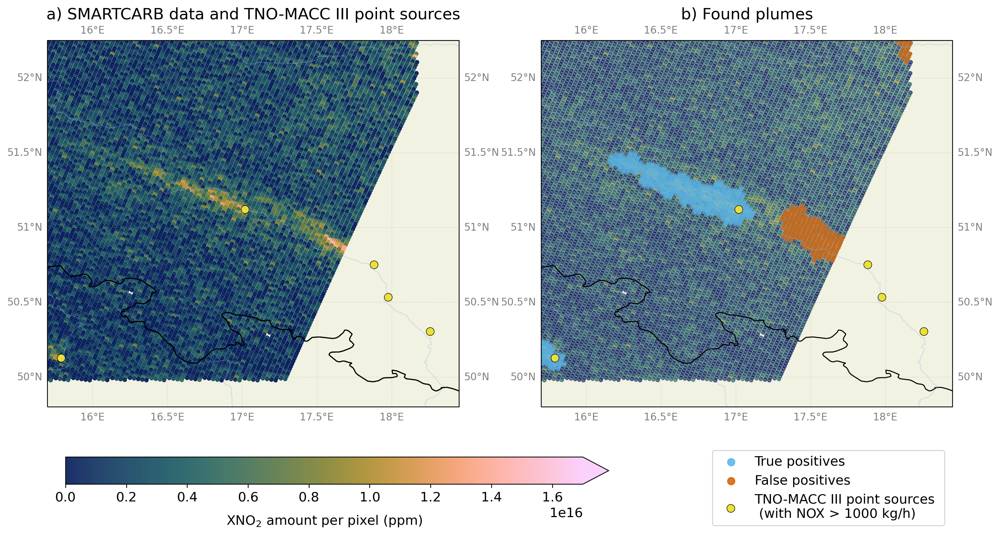

In [400]:
# Plot examples of false positives

i = 268

# Get SMARTCARB data
filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
data = ddeq.smartcarb.read_level2(
filename,
co2_noise_scenario="low",
no2_noise_scenario="high",
co_noise_scenario="low",
only_observations=False,
)
lon_m = np.array(data["lon"])
lat_m = np.array(data["lat"])
no2_m = np.array(data["NO2"])

#no2_m_padded = np.pad(no2_m, pad_width=1, mode='constant', constant_values=np.nan)

# Remove points outside domain
domain_extent=[8.30719191586997, 18.170863673993093, 49.978223611443795, 54.694193446535714]
area_boolean = np.logical_and(np.logical_and(lon_m>=domain_extent[0], lon_m<=domain_extent[1]), np.logical_and(lat_m>=domain_extent[2], lat_m<=domain_extent[3]))
no2_m[~area_boolean] = np.nan

lon = lon_m.flatten()
lat = lat_m.flatten()
no2 = no2_m.flatten()

#nan_indices = np.where(np.isnan(no2))
not_nan = np.logical_not(np.isnan(no2))

lon_notNaN = lon[not_nan]
lat_notNaN = lat[not_nan]
no2_notNaN = no2[not_nan]
lon_NaN = lon[~not_nan]
lat_NaN = lat[~not_nan]

clusters = clt.density_based_clustering_with_varying_radius(
        np.transpose([lon_notNaN, lat_notNaN]),
        no2_notNaN,
        radius_func="default",
        n_clusters="auto",
        point_value_threshold="stds_from_median",
        stds=3.3,
        distance_matrix="euclidean",
        radius_func_sigmas_threshold=1.4,
        max_points_in_start_radius=5,
        local_box_size=3,
        verbose=True,
    )

fig, axs = plt.subplots(
    1, 2, figsize=(16, 10), subplot_kw={"projection": ccrs.PlateCarree()}, dpi=200
)

plt.rcParams.update({'font.size': 13})

extent = [
    15.7,
    18.45,
    49.8,
    52.25,
]

point_source_threshold = 1000
point_sources = TNO_MACC_III_point_sources_NOX.query("NOX > @point_source_threshold")

# ====================================================================================================
# FIRST PLOT

ax = axs[0]
ax.set_extent(extent)

ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.add_feature(cfeature.LAND, alpha=0.8)
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS, alpha=0.3)
ax.add_feature(cfeature.OCEAN)
ax.coastlines()

pcm1 = ax.scatter(
    lon,
    lat,
    c=no2,
    vmin=0,
    vmax=1.7e16,
    s=11,
    alpha=0.9,
    transform=ccrs.Geodetic(),
    cmap=cm.batlow,
)
ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.coastlines()
ax.set_title(f"a) SMARTCARB data and TNO-MACC III point sources")

# PLOT TNO-MACC SOURCES
ax.scatter(
    point_sources["Lon"],
    point_sources["Lat"],
    c=[sns.color_palette("colorblind")[8]],
    path_effects=[pe.withStroke(linewidth=2, foreground="black", alpha=1)],
    s=40,
    alpha=1,
)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=0.5,
    color="gray",
    alpha=0.2,
    linestyle="--",
)
gl.xlabel_style = {"size": 10, "color": "gray"}
gl.ylabel_style = {"size": 10, "color": "gray"}

# ====================================================================================================
# SECOND SUBPLOT

ax = axs[1]
ax.set_extent(extent)
ax.set_title(f"b) Found plumes")

pcm2 = ax.scatter(
    lon,
    lat,
    c=no2,
    vmin=0,
    vmax=1.7e16,
    s=11,
    alpha=0.6,
    transform=ccrs.Geodetic(),
    cmap=cm.batlow
    #label="SMARTCARB data",
)

ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.add_feature(cfeature.LAND, alpha=0.8)
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS, alpha=0.3)
ax.add_feature(cfeature.OCEAN)
ax.coastlines()
#fig.colorbar(pcm, ax=ax)

# Plot clusters

## True positives
true_positives_lon = []
true_positives_lat = []
if len(true_positives) != 0:
    for j in true_positives:
        true_positives_lon.extend(lon_notNaN[clusters == j])
        true_positives_lat.extend(lat_notNaN[clusters == j])
ax.scatter(
    true_positives_lon,
    true_positives_lat,
    s=11,
    alpha=0.7,
    c=[sns.color_palette("colorblind")[9]],
    #label="True positives",
)
# For legend
ax.scatter(
    [0],
    [0],
    s=50,
    alpha=0.85,
    c=[sns.color_palette("colorblind")[9]],
    label="True positives",
)

## False positives
false_positives_lon = []
false_positives_lat = []
if len(false_positives) != 0:
    for j in false_positives:
        false_positives_lon.extend(lon_notNaN[clusters == j])
        false_positives_lat.extend(lat_notNaN[clusters == j])
ax.scatter(
    false_positives_lon,
    false_positives_lat,
    s=11,
    alpha=0.7,
    c=[sns.color_palette("colorblind")[3]],
    #label="False positives",
)
# For legend
ax.scatter(
    [0],
    [0],
    s=50,
    alpha=0.85,
    c=[sns.color_palette("colorblind")[3]],
    label="False positives",
)

# PLOT TNO-MACC SOURCES
ax.scatter(
    point_sources["Lon"],
    point_sources["Lat"],
    path_effects=[pe.withStroke(linewidth=2, foreground="black", alpha=1)],
    s=40,
    alpha=1,
    label="TNO-MACC III point sources \n (with NOX > 1000 kg/h)",
    c=[sns.color_palette("colorblind")[8]]
)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=0.5,
    color="gray",
    alpha=0.2,
    linestyle="--",
)
gl.xlabel_style = {"size": 10, "color": "gray"}
gl.ylabel_style = {"size": 10, "color": "gray"}

# ====================================================================================================

#fig.suptitle("Example of source points being outside the bounds")
cbar = fig.colorbar(pcm1, ax=axs.ravel().tolist(), shrink=0.6, extend='max', anchor=(0.05, 1.6),orientation='horizontal')
cbar.set_label('XNO$_2$ amount per pixel (ppm)', labelpad=10)
plt.legend(bbox_to_anchor=(0.4, -0.1), loc='upper left')
plt.show()

In [ ]:
gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=0.5,
    color="gray",
    alpha=0.2,
    linestyle="--",
)

# add gl to fig
fig.add_artist(gl)

# Change extennt
plt.ylim(49.8, 52.25)

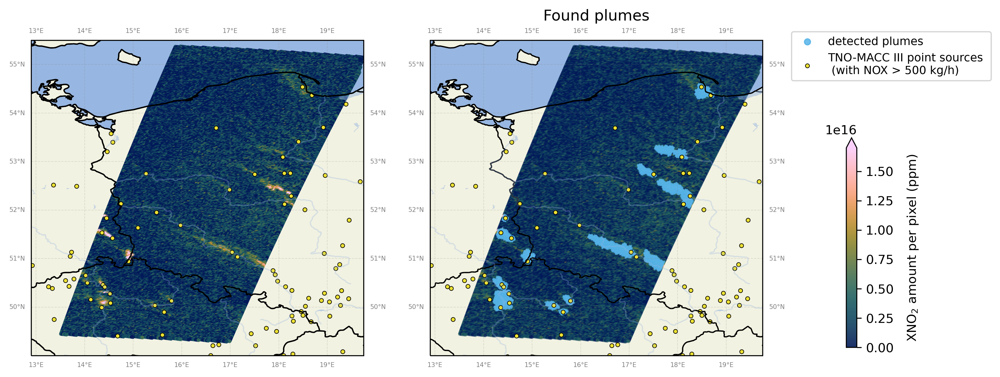

In [43]:
# Plot examples of false positives

i = 268

# Get SMARTCARB data
filename = os.path.join(SMARTCARB_DATA_PATH, SMARTCARB_filenames_all[i])
data = ddeq.smartcarb.read_level2(
    filename,
    co2_noise_scenario="low",
    no2_noise_scenario="high",
    co_noise_scenario="low",
    only_observations=False,
)
lon = np.array(data["lon"]).flatten()
lat = np.array(data["lat"]).flatten()
no2 = np.array(data["NO2"]).flatten()
not_nan = np.logical_not(np.isnan(no2))
lon = lon[not_nan]
lat = lat[not_nan]
no2 = no2[not_nan]

clusters = np.array(my_clusters_per_file[i])

fig, axs = plt.subplots(
    1, 2, figsize=(13, 5), subplot_kw={"projection": ccrs.PlateCarree()}, dpi=300
)
extend_margin = 2
extent = [
    14.9 - extend_margin,
    17.75 + extend_margin,
    51 - extend_margin,
    53.5 + extend_margin,
]

point_source_threshold = 500
point_sources = TNO_MACC_III_point_sources_NOX.query("NOX > @point_source_threshold")


# ====================================================================================================
# FIRST PLOT

ax = axs[0]
ax.set_extent(extent)

ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.add_feature(cfeature.LAND, alpha=0.8)
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS, alpha=0.3)
ax.add_feature(cfeature.OCEAN)
ax.coastlines()

pcm1 = ax.scatter(
    lon,
    lat,
    c=no2,
    vmin=0,
    vmax=1.7e16,
    s=4,
    alpha=0.9,
    transform=ccrs.Geodetic(),
    cmap=cm.batlow,
)
ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.coastlines()
#ax.set_title(f"SMARTCARB 2015070311_o2729_l1811, and E-PRTR sources")

# PLOT TNO-MACC SOURCES
ax.scatter(
    point_sources["Lon"],
    point_sources["Lat"],
    c=[sns.color_palette("colorblind")[8]],
    path_effects=[pe.withStroke(linewidth=2, foreground="black", alpha=1)],
    s=3,
    alpha=1,
)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=0.5,
    color="gray",
    alpha=0.2,
    linestyle="--",
)
gl.xlabel_style = {"size": 5, "color": "gray"}
gl.ylabel_style = {"size": 5, "color": "gray"}


# ====================================================================================================
# SECOND SUBPLOT

ax = axs[1]
ax.set_extent(extent)
ax.set_title(f"Found plumes")

pcm2 = ax.scatter(
    lon,
    lat,
    c=no2,
    vmin=0,
    vmax=1.7e16,
    s=4,
    alpha=0.6,
    transform=ccrs.Geodetic(),
    cmap=cm.batlow
    #label="SMARTCARB data",
)

ax.add_feature(cfeature.BORDERS, alpha=1, linewidth=1)
ax.add_feature(cfeature.LAND, alpha=0.8)
ax.add_feature(cfeature.LAKES, alpha=0.5)
ax.add_feature(cfeature.RIVERS, alpha=0.3)
ax.add_feature(cfeature.OCEAN)
ax.coastlines()
#fig.colorbar(pcm, ax=ax)

# Plot clusters

## True positives
true_positives_lon = []
true_positives_lat = []
if len(true_positives[i]) != 0:
    for j in true_positives[i]:
        true_positives_lon.extend(lon[clusters == j])
        true_positives_lat.extend(lat[clusters == j])
ax.scatter(
    true_positives_lon,
    true_positives_lat,
    s=0.5,
    alpha=0.7,
    c=[sns.color_palette("colorblind")[9]],
    #label="True positives",
)
# For legend
ax.scatter(
    [0],
    [0],
    s=22,
    alpha=0.85,
    c=[sns.color_palette("colorblind")[9]],
    label="detected plumes",
)

## False positives
false_positives_lon = []
false_positives_lat = []
if len(false_positives[i]) != 0:
    for j in false_positives[i]:
        false_positives_lon.extend(lon[clusters == j])
        false_positives_lat.extend(lat[clusters == j])
ax.scatter(
    false_positives_lon,
    false_positives_lat,
    s=0.5,
    alpha=0.7,
    c=[sns.color_palette("colorblind")[9]],
    #label="False positives",
)
# For legend
ax.scatter(
    [0],
    [0],
    s=22,
    alpha=0.85,
    c=[sns.color_palette("colorblind")[3]],
#    label="False positives",
)

# PLOT TNO-MACC SOURCES
ax.scatter(
    point_sources["Lon"],
    point_sources["Lat"],
    path_effects=[pe.withStroke(linewidth=2, foreground="black", alpha=1)],
    s=3,
    alpha=1,
    label=f"TNO-MACC III point sources \n (with NOX > {point_source_threshold} kg/h)",
    c=[sns.color_palette("colorblind")[8]]
)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    draw_labels=True,
    linewidth=0.5,
    color="gray",
    alpha=0.2,
    linestyle="--",
)
gl.xlabel_style = {"size": 5, "color": "gray"}
gl.ylabel_style = {"size": 5, "color": "gray"}

# ====================================================================================================

#fig.suptitle("Example of source points being outside the bounds")
cbar = fig.colorbar(pcm1, ax=axs, shrink=0.6, extend='max', anchor=(0.3, 0.18))
cbar.set_label('XNO$_2$ amount per pixel (ppm)', fontsize=10, labelpad=10)
plt.legend(bbox_to_anchor=(1.07, 1.045), loc='upper left', fontsize=9)
plt.show()


In [44]:
def plot_cluster(i):
    date_of_clusters=datetime.utcfromtimestamp(clusters_timestamp[i]).strftime("%y%m%d")

    fig = plt.figure(figsize=(5,5),dpi=150)
    ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=12))
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linewidth=0.5, alpha=0.5)
    gl = ax.gridlines(draw_labels=True, linewidth=2, color='gray', alpha=0.5, linestyle='--')
    extent = 3
    ax.set_extent([clusters_lon_max[i]+extent,clusters_lon_min[i]-extent, clusters_lat_max[i]+extent,clusters_lat_min[i]-extent])

    s5p_timeframe = np.logical_and(clusters_timestamp[i]+60*3 > s5p_timestamp, s5p_timestamp > clusters_timestamp[i]-60*3)
    plt.scatter(s5p_lon[s5p_timeframe], s5p_lat[s5p_timeframe], c=s5p_no2[s5p_timeframe], transform=ccrs.Geodetic(), s=6, vmin=0, vmax=0.0001, alpha=0.7, cmap=cmc.batlow)

    plt.scatter([clusters_lon_max[i], clusters_lon_min[i]], [clusters_lat_max[i], clusters_lat_min[i]], c='r', transform=ccrs.Geodetic(), s=50, edgecolors='none')

    #plt.title("SP5 and OCO-2 colocation with time difference: %f h" %(time_difference[good_i]/(60*60)) +"\nOn date: "+str(datetime.utcfromtimestamp(clusters_timestamp[i]).strftime("%y%m%d")))

    plt.show()